In [ ]:
from notebooks import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


The potoo.default_magic_magic extension is already loaded. To reload it, use:
  %reload_ext potoo.default_magic_magic


In [ ]:
# Default figsize for spectros
figsize(aspect=1/8);

In [ ]:
# Load model
#   - Chosen via notebooks/20180629_eval.ipynb (local runs) -> Train/test scores
search = Search.load_v0(
    'eval-na-dan170/split_i=0,train=2693,test=674,classes=170', 'n_species=170,n_recs=1.0',
    'cls=logreg_ovr,solver=liblinear,C=0.1,class_weight=balanced',  # Not std
    # 'cls=std-sgdlog,alpha=0.1,class_weight=balanced',  # std [TODO Re-run locally to get an n_species=170]
)
display(
    search,
    search.classifier_,
    len(search.classifier_.classes_),
)

Search(
  n_species=170,
  n_recs=1.0,
  classifier='cls: logreg_ovr,solver: liblinear,C: 0.1,class_weight: balanced',
  random_state=0,
  projection=Projection(
    features=Features(
      load=Load(channels=1, sample_rate=22050, sample_width_bit=16, cache_audio=True),
      sample_rate=22050,
      f_min=1000,
      f_bins=40,
      hop_length=256,
      frame_length=512,
      frame_window='hann',
      patch_length=4
    ),
    skm_fit_max_t=600000,
    k=500,
    variance_explained=0.99,
    do_pca=True,
    pca_whiten=True,
    standardize=False,
    normalize=False,
    agg_funs=['mean', 'std', 'max']
  )
)

LogisticRegression(C=0.1, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=-1, penalty='l2', random_state=0,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

170

In [ ]:
# HACK FIXME Why doesn't search.projection.skm_ exist after unpickle?
projection = Projection.load('peterson-v0-26bae1c', features=Features(load=Load()))
features = projection.features
load = features.load
search.projection = projection
# These both work...
joblib_loads(joblib_dumps(projection)).skm_
joblib_loads(joblib_dumps(search)).projection.skm_

[23:02:09.157] DEBUG  Projection.load
  path: /Users/danb/hack/bubo/features/data/models/projection/peterson-v0-26bae1c.pkl


In [ ]:
user_recs = load_app_recs(projection,
    # n=10,
)
display(
    df_summary(user_recs).T,
    df_value_counts(user_recs),
    user_recs[:10],
)

[23:02:09.281] DEBUG  Load.audio:in
  len(recs): 164
  len(recs) per dataset: {recordings: 164}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[############################################################                              ] | 67% Completed |  0.4s

[##########################################################################################] | 100% Completed |  0.5s

[23:02:09.791] DEBUG  Load.audio:out
  len(audio): 164


[23:02:11.023] WARN   Dropped 1 recs with duplicate audio_id


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat
audio_id,,,,,,,,,,,,,,,
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2.wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot),Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot),recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot).wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot): 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...


[23:02:11.073] DEBUG  Features.spectros:in
  len(recs): 163
  len(recs) per dataset: {recordings: 163}
  sum(duration_h): 3.29
  sum(samples_mb): 498.0
  sum(samples_n): 261204420
[                                                                                          ] | 0% Completed |  0.0s

[################                                                                          ] | 18% Completed |  0.1s

[########################################                                                  ] | 45% Completed |  0.2s

[##########################################################                                ] | 65% Completed |  0.3s

[#########################################################################                 ] | 81% Completed |  0.4s

[#########################################################################                 ] | 81% Completed |  0.5s

[##########################################################################################] | 100% Completed |  0.6s

[23:02:11.730] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 1020094]


,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
audio_id,object,11410,163,163,163.0,NaN,NaN,20160709-1e8c,20160910-3543,20171007-a787,20180513-1a88,20180805-60c3
recorded_at,datetime64[ns],1304,163,163,163.0,NaN,NaN,2016-07-09 18:38:51,2016-09-10 21:27:02,2017-10-07 15:18:55,2018-05-13 17:35:14,2018-08-05 15:57:16
dataset,object,10921,163,163,1.0,NaN,NaN,recordings,recordings,recordings,recordings,recordings
species,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
species_com_name,object,10933,163,163,35.0,NaN,NaN,American Bittern,Red-tailed Hawk,Unknown,Unknown,Wilson's Warbler
species_query,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
duration_s,float64,1304,163,163,158.0,NaN,NaN,2.75,19.1,48.8,90.8,691
samples_mb,float64,1304,163,163,158.0,NaN,NaN,0.115,0.804,2.05,3.82,29
samples_n,int64,1304,163,163,158.0,NaN,NaN,60544,421573,1076243,2002707,15229220


,dataset,n,species,n,species_com_name,n,species_query,n,duration_s,n,samples_mb,n,samples_n,n,species_longhand,n
0,recordings,163,_UNK,104,Unknown,104,_UNK,104,3.85,2,0.161,2,84480,2,Unknown - _UNK,104
1,,,CORA,4,Common Raven,4,CORA,4,3.94,2,0.208,2,108928,2,Common Raven - CORA,4
2,,,RTHA,4,Red-tailed Hawk,4,RTHA,4,3.83,2,0.166,2,86784,2,Red-tailed Hawk - RTHA,4
3,,,SPTO,3,Wilson's Warbler,3,SPTO,3,4.94,2,0.162,2,155776,2,White-crowned Sparrow - WCSP,3
4,,,BEWR,3,White-crowned Sparrow,3,BEWR,3,7.06,2,0.297,2,84864,2,Spotted Towhee - SPTO,3
5,,,WCSP,3,Spotted Towhee,3,WCSP,3,162.00,1,0.147,1,1320202,1,Bewick's Wren - BEWR,3
6,,,OCWA,3,Bewick's Wren,3,OCWA,3,29.80,1,0.247,1,83968,1,Wilson's Warbler - WIWA,3
7,,,WIWA,3,Orange-crowned Warbler,3,WIWA,3,56.40,1,0.185,1,199168,1,Orange-crowned Warbler - OCWA,3
8,,,CASJ,2,Black Phoebe,2,CASJ,2,88.20,1,0.159,1,2044677,1,California Thrasher - CATH,2
9,,,BLPH,2,American Bittern,2,BLPH,2,59.90,1,5.800,1,95232,1,Hairy Woodpecker - HAWO,2


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat,spectro
audio_id,,,,,,,,,,,,,,,,
20160709-1e8c,2016-07-09 19:04:03,recordings,CALT,California Towhee,CALT,43.2,1.820,951746,CALT cal towhee,California Towhee - CALT,1e8c9cfe8f48560aa30173bb9f20aee30e7ecd71,recordings/CALT cal towhee,recordings/CALT cal towhee.wav,"box(unbox=recordings/CALT cal towhee: 1 channels, 16 bit, sampled @ 22.05 kHz, 43.163s long)",[ 2.035e-03 6.529e-02 2.609e-01 -8.920e-02 7.727e-02 2.055e-01 2.770e-02 -5.686e-02 4.625e-01 -4.459e-02\n -2.317e-01 1.583e-01 -7.546e-03 -1.656e-01 2.748e-02 -1.4...,
20160709-228d,2016-07-09 20:51:51,recordings,RTHA,Red-tailed Hawk,RTHA,42.1,1.770,928934,"RTHA red tailed hawk, noise",Red-tailed Hawk - RTHA,228d2414340927d1c8193963959bb82a6681e6db,"recordings/RTHA red tailed hawk, noise","recordings/RTHA red tailed hawk, noise.wav","box(unbox=recordings/RTHA red tailed hawk, noise: 1 channels, 16 bit, sampled @ 22.05 kHz, 42.129s long)",[ 1.452e-01 -3.292e-02 6.948e-01 -2.057e-02 -1.251e-02 -2.576e-02 4.741e-02 -4.145e-01 1.621e-01 -1.482e-01\n -1.505e-01 1.070e-01 -3.720e-02 -8.035e-02 -5.857e-03 1.3...,
20160709-4bb7,2016-07-09 19:57:52,recordings,_UNK,Unknown,_UNK,59.9,2.520,1320202,Recording 0019,Unknown - _UNK,4bb7924a5092f24d2fede40c339479b1befb6ac0,recordings/Recording 0019,recordings/Recording 0019.wav,"box(unbox=recordings/Recording 0019: 1 channels, 16 bit, sampled @ 22.05 kHz, 59.873s long)",[ 4.733e-02 2.485e-02 1.041e-01 -2.679e-02 2.001e-02 3.011e-03 9.353e-02 -1.986e-02 9.155e-02 -9.730e-02\n -2.053e-01 3.033e-01 -8.698e-03 -9.605e-02 9.715e-02 1.5...,
20160709-4e73,2016-07-09 19:07:43,recordings,WCSP,White-crowned Sparrow,WCSP,21.9,0.923,483910,WCSP white crowned,White-crowned Sparrow - WCSP,4e73e2c74b271647b5406c5784b8af1fd609b8eb,recordings/WCSP white crowned,recordings/WCSP white crowned.wav,"box(unbox=recordings/WCSP white crowned: 1 channels, 16 bit, sampled @ 22.05 kHz, 21.946s long)",[ 2.455e-02 -1.062e-02 9.811e-01 -9.299e-02 4.945e-02 -5.597e-02 5.669e-02 -2.279e-01 4.159e-01 -7.791e-02\n -1.896e-01 1.582e-01 -4.445e-02 -9.104e-02 6.175e-02 -1.1...,
20160709-59d3,2016-07-09 18:53:03,recordings,RTHA,Red-tailed Hawk,RTHA,30.6,1.290,674360,RTHA red tailed hawk,Red-tailed Hawk - RTHA,59d360c416f841fdc19213c1943c73b39992e241,recordings/RTHA red tailed hawk,recordings/RTHA red tailed hawk.wav,"box(unbox=recordings/RTHA red tailed hawk: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.583s long)",[ 2.229e-02 -1.745e-02 7.496e-01 -5.046e-02 -3.577e-02 -4.409e-02 2.941e-04 -2.590e-01 2.597e-01 2.174e-02\n -1.398e-01 -4.891e-02 -5.807e-03 -9.787e-02 -1.195e-01 -1.8...,
20160709-795e,2016-07-09 20:34:26,recordings,_UNK,Unknown,_UNK,71.2,2.990,1569411,unknown sparrow (song?),Unknown - _UNK,795e65fdd0566f69ddfaa13bae28c5e6fde0d3f6,recordings/unknown sparrow (song?),recordings/unknown sparrow (song?).wav,"box(unbox=recordings/unknown sparrow (song?): 1 channels, 16 bit, sampled @ 22.05 kHz, 71.175s long)",[ 1.549e-01 -4.838e-02 1.737e-01 2.306e-02 3.237e-04 -4.025e-02 1.242e-01 -8.359e-02 2.388e-01 -9.303e-02\n -2.223e-01 2.008e-02 -1.347e-01 -4.654e-02 -5.248e-02 3.6...,
20160709-81dc,2016-07-09 20:59:19,recordings,HAWO,Hairy Woodpecker,HAWO,59.3,2.490,1307828,HAWO hairy woodpecker (2),Hairy Woodpecker - HAWO,81dc45758f7932931a1072df74422793bb083cda,recordings/HAWO hairy woodpecker (2),recordings/HAWO hairy woodpecker (2).wav,"box(unbox=recordings/HAWO hairy woodpecker (2): 1 channels, 16 bit, sampled @ 22.05 kHz, 59.312s long)",[ 6.210e-02 -3.008e-02 9.021e-03 -5.638e-02 1.596e-02 -4.143e-02 6.790e-02 -2.643e-02 1.448e-01 -8.180e-02\n -9.243e-02 1.103e-01 -3.034e-02 -3.102e-02 6.833e-02 -1.6...,
20160709-8c26,2016-07-09 19:51:42,recordings,_UNK,Unknown,_UNK,72.1,3.030,1589856,Recording 0018,Unknown - _UNK,8c26390858462d8ccfad92be14e1758014f54c12,recordings/Recording 0018,recordings/Recording 0018.wav,"box(unbox=recording

# Load xc recs

In [ ]:
# TODO Clean this up (how much complexity can we encapsulate and hide in functions vs. how much do we need to surface here?)

In [ ]:
# Load xc_meta (fast)
#   1. countries: Filter recs to these countries
#   2. species: Filter recs to these species
#   3. recs_at_least: Filter species to those with at least this many recs
#   4. num_species: Sample this many of the species
#   5. num_recs: Sample this many recs per species
inf = np.inf
# countries_k, com_names_k = 'na', 'us'      # 9.4k/400k -> 1.1k/60k -> 774/53k
# countries_k, com_names_k = 'na', 'ca'      # 9.4k/400k -> 1.1k/60k -> 334/35k
# countries_k, com_names_k = 'na', 'dan170'  # 9.4k/400k -> 1.1k/60k -> 170/3.4k
countries_k, com_names_k = 'na', 'dan4'    # 9.4k/400k -> 1.1k/60k ->   4/2.2k
recs_at_least, num_species, num_recs =   0, inf, inf  # US[334/35k ->1.1k/60k -> 774/53k -> 774/53k   -> 743/53k]    # All US
# recs_at_least, num_species, num_recs = 100, 100, 100  # CA[334/35k -> 127/25k -> 100/21k -> 100/10k   -> 100/10k]
# recs_at_least, num_species, num_recs =  50, 100, 100  # CA[334/35k -> 224/32k -> 100/16k -> 100/ 9.0k -> 100/ 9.0k]
# recs_at_least, num_species, num_recs =   0, 100, 100  # CA[334/35k -> 334/35k -> 100/12k -> 100/ 6.8k ->  99/ 6.8k]
# recs_at_least, num_species, num_recs =   0, 168, 100  # CA[334/34k -> 334/34k -> 168/18k -> 168/11k   -> 167/11k]    # (old 'all')
# recs_at_least, num_species, num_recs =   0, 168,  20  # CA[334/34k -> 334/35k -> 168/18k -> 168/ 3.2k -> 167/ 3.2k]  # (old 'recs')
# recs_at_least, num_species, num_recs =  20, 168,  20  # CA[334/35k -> 296/35k -> 168/20k -> 168/ 3.4k -> 168/ 3.4k]  # Familiar set
# recs_at_least, num_species, num_recs =  20, 336,  20  # US[774/53k -> 528/51k -> 336/33k -> 336/ 6.7k -> 336/ 6.7k]  # Scale species
# recs_at_least, num_species, num_recs =  10, 168,  20  # CA[334/35k ->                                             ]  # Class imbalance
# recs_at_least, num_species, num_recs =   0, 168,  20  # CA[334/35k ->                                             ]  # Class imbalance
# recs_at_least, num_species, num_recs =   0, inf,  20  # dan170 for app_brainstorm_1
# recs_at_least, num_species, num_recs =  20, 50,  100  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   50  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   20  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   10  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,    5  # Faster dev
get_recs_stats = lambda df: dict(sp=df.species.nunique(), recs=len(df))
puts_stats = lambda desc: partial(tap, f=lambda df: print('%-15s %12s (sp/recs)' % (desc, '%(sp)s/%(recs)s' % get_recs_stats(df))))
xc_meta = (xc.metadata
    .pipe(puts_stats('all'))
    # 1. countries: Filter recs to these countries
    [lambda df: df.country.isin(constants.countries[countries_k])]
    .pipe(puts_stats('countries'))
    # 2. species: Filter recs to these species
    [lambda df: df.species.isin(com_names_to_species(*com_names[com_names_k]))]
    .pipe(puts_stats('species'))
    # Omit not-downloaded recs (should be few within the selected countries)
    [lambda df: df.downloaded]
    .pipe(puts_stats('(downloaded)'))
    # Remove empty cats for perf
    .pipe(df_remove_unused_categories)
    # 3. recs_at_least: Filter species to those with at least this many recs
    [lambda df: df.species.isin(df.species.value_counts()[lambda s: s >= recs_at_least].index)]
    .pipe(puts_stats('recs_at_least'))
    # 4. num_species: Sample this many of the species
    [lambda df: df.species.isin(df.species.drop_duplicates().pipe(lambda s: s.sample(n=min(len(s), num_species), random_state=0)))]
    .pipe(puts_stats('num_species'))
    # 5. num_recs: Sample this many recs per species
    #   - Remove empty cats else .groupby fails on empty groups
    .pipe(df_remove_unused_categories)
    .groupby('species').apply(lambda g: g.sample(n=min(len(g), num_recs), random_state=0))
    .pipe(puts_stats('num_recs'))
    # Drop species with <2 recs, else StratifiedShuffleSplit complains (e.g. 'TUVU')
    [lambda df: df.species.isin(df.species.value_counts()[lambda s: s >= 2].index)]
    .pipe(puts_stats('recs ≥ 2'))
    # Clean up for downstream
    .pipe(df_remove_unused_categories)
)
_recs_stats = get_recs_stats(xc_meta)
recs_stats = ', '.join(['%s[%s]' % (k, v) for k, v in _recs_stats.items()])
display(
    recs_stats,
    # df_summary(xc_meta).T,
    # df_value_counts(xc_meta),
    # xc_meta.sample(n=min(10, len(xc_meta)), random_state=0).sort_values('species'),
)

all              9442/399859 (sp/recs)
countries         1148/59713 (sp/recs)
species               4/2167 (sp/recs)
(downloaded)          4/2167 (sp/recs)
recs_at_least         4/2167 (sp/recs)
num_species           4/2167 (sp/recs)
num_recs              4/2167 (sp/recs)
recs ≥ 2              4/2167 (sp/recs)


'sp[4], recs[2167]'

In [ ]:
# Load xc_recs (slower)
xc_paths = [
    ('xc', f'{data_dir}/xc/data/{row.species}/{row.id}/audio.mp3')
    for row in df_rows(xc_meta)
]
joblib.dump(xc_paths, '/tmp/xc_paths')  # When uncached, helpful to run load.recs in a terminal (long running and verbose)
xc_recs = (
    load.recs(paths=xc_paths)
    .assign(xc_id=lambda df: df.id.str.split('/').str[3].astype(int))
    .merge(how='left', on='xc_id', right=(xc_meta
        .rename(columns={'id': 'xc_id'})
        .drop(columns=['species', 'sci_name', 'com_name'])
    ))
)
display(
    df_summary(xc_recs).T,
    df_value_counts(xc_recs, exprs=[
        'species',
        'subspecies',
        'country',
        ('quality', dict(sort_values=True)),
        'type',
        ('(duration_s//30)*30', dict(sort_values=True)),
        'locality',
        'recordist',
        ('date.dt.year', dict(sort_values=True, ascending=False)),
        ("time.str.slice(0, 2)"),
    ]),
    xc_recs.sample(n=min(10, len(xc_recs)), random_state=0).sort_values('species'),
)

,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
index,int64,17336,2167,2167,2167,1.083e+03,6.257e+02,0,541,1083,1624,2166
dataset,object,127853,2167,2167,1,NaN,NaN,xc,xc,xc,xc,xc
species,category,2571,2167,2167,4,NaN,NaN,HOWR,BEWR,SOSP,SOSP,SPTO
species_com_name,category,2604,2167,2167,4,NaN,NaN,House Wren,Bewick's Wren,Song Sparrow,Song Sparrow,Spotted Towhee
species_query,object,132187,2167,2167,4,NaN,NaN,BEWR,HOWR,SOSP,SOSP,SPTO
duration_s,float64,17336,2167,2167,2006,5.257e+01,6.337e+01,1.01,18.4,36.3,64.7,1.07e+03
samples_mb,float64,17336,2167,2167,2006,2.214e+00,2.667e+00,0.0424,0.774,1.52,2.72,44.9
samples_n,int64,17336,2167,2167,2006,1.161e+06,1.398e+06,22226,405720,799488,1426176,23533524
basename,object,134354,2167,2167,1,NaN,NaN,audio,audio,audio,audio,audio


,species,n,subspecies,n,country,n,quality,n,type,n,(duration_s//30)*30,n,locality,n,recordist,n,date.dt.year,n,"time.str.slice(0, 2)",n
0,SOSP,648,,1455,United States,1.43e+03,A,816,song,1173,0.0,905,"Swan Lake, Victoria, Vancouver Island, BC",103,Ian Cruickshank,309,2018,41,08,336
1,BEWR,522,montanus,95,Canada,460,B,915,call,435,30.0,651,"Rocky Point Bird Observatory, Metchosin, Vancouver Island, BC",48,Richard E. Webster,216,2017,152,07,278
2,SPTO,521,parkmanii,77,Mexico,279,C,310,"call, song",115,60.0,299,"San Bernardino National Wildlife Refuge, Cochise County, Arizona",44,Richard E Webster,118,2016,216,09,265
3,HOWR,476,fallax,60,,,D,43,Song,56,90.0,129,"Portal, Arizona",31,Manuel Grosselet,87,2015,296,10,240
4,,,eremophilus,46,,,E,12,"male, song",51,120.0,78,"Hunter Mountain, Death Valley National Park, Inyo County",30,Thomas G. Graves,80,2014,210,?,171
5,,,melodia,36,,,no score,71,alarm call,38,150.0,43,"Lundbreck Falls, AB",23,Frank Lambert,62,2013,302,06,165
6,,,megalonyx,34,,,,,contact calls,15,180.0,14,"Bill Williams River NWR, Arizona",20,Mike Nelson,60,2012,321,11,124
7,,,falcinellus,33,,,,,"female, song",12,210.0,15,"Pedder Bay, Metchosin, Vancouver Island, BC",19,Paul Marvin,59,2011,135,12,87
8,,,oregonus,29,,,,,"alarm call, call",12,240.0,10,"Yard, Croton, New York",17,Peter Boesman,57,2010,58,05,66
9,,,aedon,28,,,,,Call,12,270.0,6,"3 km south of Fishing Lake, SK",15,Eric DeFonso,44,2009,53,17,49


,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,id,path,xc_id,downloaded,subspecies,recordist,country,locality,lat,lng,type,quality,date,time,license_type,license_detail,license,url,download
194,xc,HOWR,House Wren,HOWR,2.08,0.087,45819,audio,House Wren - HOWR,xc/data/HOWR/290439/audio,xc/data/HOWR/290439/audio.mp3,290439,True,,Cara A. Krieg,United States,"Prairieville (near Delton), Barry County, Michigan",42.5,-85.5,"female, song",A,2012-05-06 00:00:00,10:00,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/290439,//www.xeno-canto.org/290439/download
443,xc,HOWR,House Wren,HOWR,54.50,2.290,1200960,audio,House Wren - HOWR,xc/data/HOWR/179087/audio,xc/data/HOWR/179087/audio.mp3,179087,True,,Dan Lane,United States,"W Lancaster, Lancaster Co., Pennsylvania",40.0,-76.3,"call, female song, song",B,2014-05-02 00:00:00,08:30,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/179087,//www.xeno-canto.org/179087/download
602,xc,BEWR,Bewick's Wren,BEWR,13.10,0.550,288576,audio,Bewick's Wren - BEWR,xc/data/BEWR/91348/audio,xc/data/BEWR/91348/audio.mp3,91348,True,eremophilus,Mike Nelson,United States,"Tunnel Drive, Canon City, Fremont County, Colorado",38.4,-105.0,song,C,2010-04-22 00:00:00,12:45pm,by-nc-nd,2.5,//creativecommons.org/licenses/by-nc-nd/2.5/,https://www.xeno-canto.org/91348,//www.xeno-canto.org/91348/download
829,xc,BEWR,Bewick's Wren,BEWR,91.60,3.850,2020608,audio,Bewick's Wren - BEWR,xc/data/BEWR/351078/audio,xc/data/BEWR/351078/audio.mp3,351078,True,eremophilus,Richard E. Webster,United States,"Olancha Pass Trail, Inyo, California",36.2,-118.0,song,A,1995-05-19 00:00:00,?,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/351078,//www.xeno-canto.org/351078/download
909,xc,BEWR,Bewick's Wren,BEWR,17.50,0.736,385920,audio,Bewick's Wren - BEWR,xc/data/BEWR/319939/audio,xc/data/BEWR/319939/audio.mp3,319939,True,,Tiffany Towery,United States,"Bonita, San Diego County, California",32.7,-117.0,song,B,2016-06-01 00:00:00,10:00,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/319939,//www.xeno-canto.org/319939/download
820,xc,BEWR,Bewick's Wren,BEWR,42.30,1.780,931921,audio,Bewick's Wren - BEWR,xc/data/BEWR/404736/audio,xc/data/BEWR/404736/audio.mp3,404736,True,,Jacob R. Saucier,United States,"Texas: Kinney County; 26.1 km NE Brackettville, Miguel Canyon",29.5,-100.0,"call, song",A,2015-05-07 00:00:00,07:30,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/404736,//www.xeno-canto.org/404736/download
529,xc,BEWR,Bewick's Wren,BEWR,70.90,2.980,1564416,audio,Bewick's Wren - BEWR,xc/data/BEWR/351058/audio,xc/data/BEWR/351058/audio.mp3,351058,True,eremophilus,Richard E. Webster,United States,"Haiwee Pass, Inyo, California",36.1,-118.0,song,A,2000-06-15 00:00:00,?,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/351058,//www.xeno-canto.org/351058/download
1154,xc,SOSP,Song Sparrow,SOSP,12.30,0.518,271404,audio,Song Sparrow - SOSP,xc/data/SOSP/283691/audio,xc/data/SOSP/283691/audio.mp3,283691,True,fallax,Eric Hough,United States,"Mineral Wash, Bill Williams River National Wildlife Refuge, La Paz County, Arizona",34.3,-114.0,"male, song",A,2015-07-13 00:00:00,05:00,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/283691,//www.xeno-canto.org/283691/download
1375,xc,SOSP,Song Sparrow,SOSP,33.80,1.420,745472,audio,Song Sparrow - SOSP,xc/data/SOSP/175509/audio,xc/data/SOSP/175509/audio.mp3,175509,True,,Derek Buchner,United States,"Anacortes, Skagit County, Washington",48.4,-123.0,song,A,2014-04-20 00:00:00,8:50,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/175509,//www.xeno-canto.org/175509/download
1942,xc,SPTO,Spotted Towhee,SPTO,59.60,2.510,1314588,audio,Spotted Towhee - SPTO,xc/data/SPTO/413790/audio,xc

In [ ]:
# Cheap plot: species counts
(xc_recs
    .species_longhand.value_counts().sort_index()
    .reset_index().rename(columns={'index': 'species_longhand', 'species_longhand': 'num_recs'})
    .assign(num_recs=lambda df: df.num_recs.map(lambda n: '%s /%s' % ('•' * int(n / df.num_recs.max() * 60), df.num_recs.max())))
)

,species_longhand,num_recs
0,House Wren - HOWR,•••••••••••••••••••••••••••••••••••••••••••• /648
1,Bewick's Wren - BEWR,•••••••••••••••••••••••••••••••••••••••••••••••• /648
2,Song Sparrow - SOSP,•••••••••••••••••••••••••••••••••••••••••••••••••••••••••••• /648
3,Spotted Towhee - SPTO,•••••••••••••••••••••••••••••••••••••••••••••••• /648


In [ ]:
# Featurize: .audio, .feat, .spectro (slowest)
#   - NOTE .spectro is heavy: 3.1gb for 2167 dan4 recs
xc_recs = (xc_recs
    # .audio
    .pipe(load.audio, scheduler='threads')
    # .feat
    .pipe(projection.transform)
    # .spectro
    .pipe(app_recs_add_spectro, features, cache=True)
)
assert {'audio', 'feat', 'spectro'} <= set(xc_recs.columns)

[23:02:16.650] DEBUG  Load.audio:in
  len(recs): 2167
  len(recs) per dataset: {xc: 2167}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[####                                                                                      ] | 5% Completed |  0.3s

[######                                                                                    ] | 7% Completed |  0.5s

[##########                                                                                ] | 11% Completed |  0.6s

[############                                                                              ] | 14% Completed |  0.7s

[#############                                                                             ] | 15% Completed |  0.8s

[##############                                                                            ] | 16% Completed |  1.0s

[#################                                                                         ] | 19% Completed |  1.2s

[##################                                                                        ] | 20% Completed |  1.3s

[###################                                                                       ] | 21% Completed |  1.5s

[####################                                                                      ] | 22% Completed |  1.8s

[#######################                                                                   ] | 25% Completed |  1.9s

[##########################                                                                ] | 29% Completed |  2.0s

[###########################                                                               ] | 30% Completed |  2.2s

[############################                                                              ] | 31% Completed |  2.4s

[############################                                                              ] | 31% Completed |  2.6s

[###############################                                                           ] | 35% Completed |  2.7s

[##################################                                                        ] | 37% Completed |  2.9s

[##################################                                                        ] | 38% Completed |  3.0s

[###################################                                                       ] | 39% Completed |  3.1s

[######################################                                                    ] | 42% Completed |  3.2s

[#########################################                                                 ] | 45% Completed |  3.5s

[#########################################                                                 ] | 46% Completed |  3.7s

[##########################################                                                ] | 47% Completed |  3.8s

[############################################                                              ] | 49% Completed |  4.0s

[#############################################                                             ] | 50% Completed |  4.1s

[###############################################                                           ] | 53% Completed |  4.3s

[##################################################                                        ] | 55% Completed |  4.4s

[###################################################                                       ] | 56% Completed |  4.6s

[####################################################                                      ] | 57% Completed |  4.7s

[######################################################                                    ] | 60% Completed |  4.8s

[#########################################################                                 ] | 64% Completed |  5.0s

[##########################################################                                ] | 64% Completed |  5.2s

[#############################################################                             ] | 68% Completed |  5.4s

[###############################################################                           ] | 70% Completed |  5.5s

[#################################################################                         ] | 72% Completed |  5.7s

[###################################################################                       ] | 74% Completed |  5.9s

[####################################################################                      ] | 76% Completed |  6.0s

[######################################################################                    ] | 78% Completed |  6.1s

[########################################################################                  ] | 81% Completed |  6.3s

[#########################################################################                 ] | 81% Completed |  6.4s

[###########################################################################               ] | 83% Completed |  6.5s

[############################################################################              ] | 84% Completed |  6.7s

[###############################################################################           ] | 87% Completed |  6.8s

[#################################################################################         ] | 90% Completed |  6.9s

[#################################################################################         ] | 91% Completed |  7.0s

[###################################################################################       ] | 92% Completed |  7.2s

[#######################################################################################   ] | 97% Completed |  7.3s

[##########################################################################################] | 100% Completed |  7.4s

[23:02:24.237] DEBUG  Load.audio:out
  len(audio): 2167


[23:02:24.502] DEBUG  Features.spectros:in
  len(recs): 2167
  len(recs) per dataset: {xc: 2167}
  sum(duration_h): 31.6
  sum(samples_mb): 4800.0
  sum(samples_n): 2515898309
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[                                                                                          ] | 0% Completed |  0.3s

[                                                                                          ] | 0% Completed |  0.4s

[                                                                                          ] | 0% Completed |  0.5s

[                                                                                          ] | 0% Completed |  0.6s

[                                                                                          ] | 0% Completed |  0.7s

[                                                                                          ] | 0% Completed |  0.8s

[                                                                                          ] | 0% Completed |  0.9s

[                                                                                          ] | 0% Completed |  1.1s

[                                                                                          ] | 0% Completed |  1.2s

[##                                                                                        ] | 2% Completed |  1.3s

[#############                                                                             ] | 15% Completed |  1.4s

[#############                                                                             ] | 15% Completed |  1.5s

[###############                                                                           ] | 17% Completed |  1.6s

[##################                                                                        ] | 20% Completed |  1.7s

[##################                                                                        ] | 20% Completed |  1.8s

[##################                                                                        ] | 20% Completed |  1.9s

[##################                                                                        ] | 20% Completed |  2.0s

[##################                                                                        ] | 20% Completed |  2.1s

[##################                                                                        ] | 20% Completed |  2.2s

[##################                                                                        ] | 20% Completed |  2.3s

[##################                                                                        ] | 20% Completed |  2.4s

[####################                                                                      ] | 22% Completed |  2.6s

[####################                                                                      ] | 22% Completed |  2.7s

[#############################                                                             ] | 32% Completed |  2.8s

[###############################                                                           ] | 35% Completed |  2.9s

[####################################                                                      ] | 40% Completed |  3.0s

[####################################                                                      ] | 40% Completed |  3.1s

[####################################                                                      ] | 40% Completed |  3.2s

[####################################                                                      ] | 40% Completed |  3.3s

[####################################                                                      ] | 40% Completed |  3.4s

[####################################                                                      ] | 40% Completed |  3.5s

[####################################                                                      ] | 40% Completed |  3.6s

[####################################                                                      ] | 40% Completed |  3.7s

[####################################                                                      ] | 40% Completed |  3.8s

[####################################                                                      ] | 40% Completed |  3.9s

[########################################                                                  ] | 45% Completed |  4.0s

[##########################################                                                ] | 47% Completed |  4.1s

[###############################################                                           ] | 52% Completed |  4.3s

[#################################################                                         ] | 55% Completed |  4.4s

[###################################################                                       ] | 57% Completed |  4.5s

[######################################################                                    ] | 60% Completed |  4.6s

[######################################################                                    ] | 60% Completed |  4.7s

[######################################################                                    ] | 60% Completed |  4.8s

[######################################################                                    ] | 60% Completed |  4.9s

[######################################################                                    ] | 60% Completed |  5.0s

[######################################################                                    ] | 60% Completed |  5.1s

[######################################################                                    ] | 60% Completed |  5.2s

[######################################################                                    ] | 60% Completed |  5.3s

[######################################################                                    ] | 60% Completed |  5.4s

[######################################################                                    ] | 60% Completed |  5.5s

[######################################################                                    ] | 60% Completed |  5.6s

[######################################################                                    ] | 60% Completed |  5.7s

[######################################################                                    ] | 60% Completed |  5.8s

[##########################################################                                ] | 65% Completed |  5.9s

[##############################################################                            ] | 70% Completed |  6.0s

[#################################################################                         ] | 72% Completed |  6.2s

[###################################################################                       ] | 75% Completed |  6.3s

[#####################################################################                     ] | 77% Completed |  6.4s

[########################################################################                  ] | 80% Completed |  6.5s

[########################################################################                  ] | 80% Completed |  6.6s

[########################################################################                  ] | 80% Completed |  6.7s

[########################################################################                  ] | 80% Completed |  6.8s

[########################################################################                  ] | 80% Completed |  6.9s

[##########################################################################                ] | 82% Completed |  7.0s

[##########################################################################                ] | 82% Completed |  7.1s

[##########################################################################                ] | 82% Completed |  7.2s

[##########################################################################                ] | 82% Completed |  7.3s

[##############################################################################            ] | 87% Completed |  7.4s

[#####################################################################################     ] | 95% Completed |  7.5s

[##########################################################################################] | 100% Completed |  7.6s

[23:02:32.278] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 9809417]


In [ ]:
df_value_counts(xc_recs, limit=15, exprs=[
    'species',
    'subspecies',
    'country',
    ('quality', dict(sort_values=True)),
    'type',
    ('(duration_s//30)*30', dict(sort_values=True)),
    # 'locality',
    # 'recordist',
    # ('date.dt.year', dict(sort_values=True, ascending=False)),
    # ("time.str.slice(0, 2)"),
])

,species,n,subspecies,n,country,n,quality,n,type,n,(duration_s//30)*30,n
0,SOSP,648,,1455,United States,1.43e+03,A,816,song,1173,0.0,905
1,BEWR,522,montanus,95,Canada,460,B,915,call,435,30.0,651
2,SPTO,521,parkmanii,77,Mexico,279,C,310,"call, song",115,60.0,299
3,HOWR,476,fallax,60,,,D,43,Song,56,90.0,129
4,,,eremophilus,46,,,E,12,"male, song",51,120.0,78
5,,,melodia,36,,,no score,71,alarm call,38,150.0,43
6,,,megalonyx,34,,,,,contact calls,15,180.0,14
7,,,falcinellus,33,,,,,"female, song",12,210.0,15
8,,,oregonus,29,,,,,"alarm call, call",12,240.0,10
9,,,aedon,28,,,,,Call,12,270.0,6


# QA rec_thumb

234
XC112080  SPTO/montanus  176.2s  A  song  United States/Chiricahua Mountains/Crest Trail  2012-07-22  Richard E Webster[by-nc-nd]


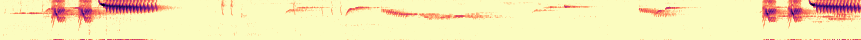

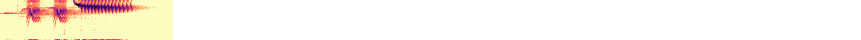

XC35906  SPTO/oregonus  45.8s  A  Alarm call  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


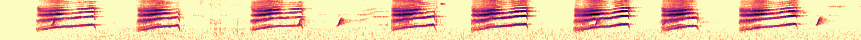

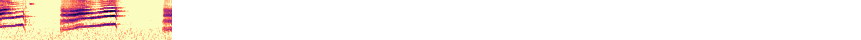

XC376224  SPTO  22.3s  A  song  United States/Colorado/Boulder County/El Dorado Spgs/Spring Brook Trail  2017-06-18  Ted Floyd[by-nc-sa]


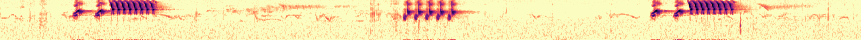

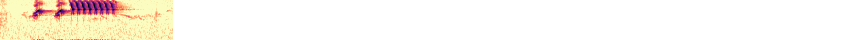

XC312024  SPTO  33.8s  A  alarm call, song  United States/Cerro Alto Campground/California/Atascadero  2016-04-11  Thomas G. Graves[by-nc-sa]


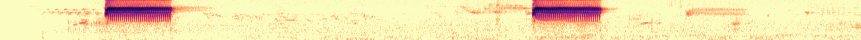

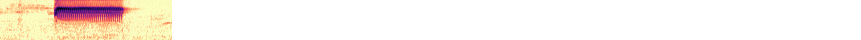

XC127015  SPTO/montanus  42.8s  A  call, song  United States/Inyo County/Death Valley National Park/Hunter Mountain  2000-05-21  Richard E. Webster[by-nc-sa]


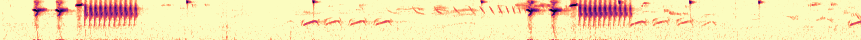

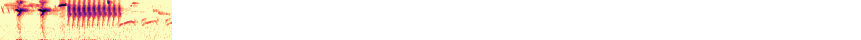

XC126691  SPTO/montanus  59.0s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  2000-05-21  Richard E. Webster[by-nc-sa]


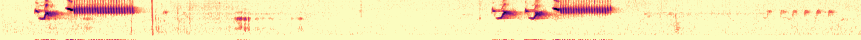

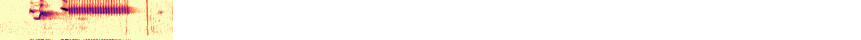

XC324965  SPTO  3.3s  A  song  United States/Colorado/Boulder County/El Dorado Spgs/Spring Brook Trail  2016-06-30  Ted Floyd[by-nc-sa]


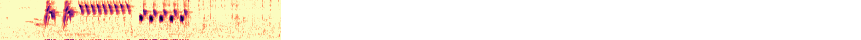

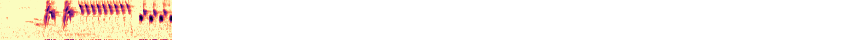

XC126661  SPTO/falcinellus  22.3s  A  song  United States/California/Inyo/Sage Flats Road  2000-06-17  Richard E. Webster[by-nc-sa]


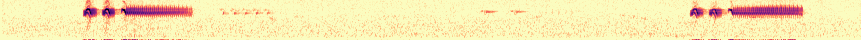

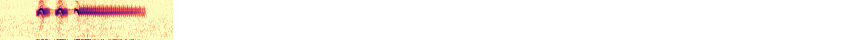

XC126657  SPTO/montanus  29.0s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1995-05-12  Richard E. Webster[by-nc-sa]


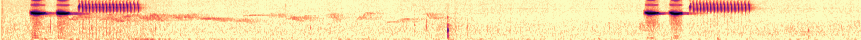

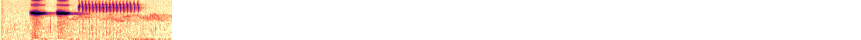

XC368589  SPTO  27.9s  A  call  United States/Colorado/Boulder County/Walden Ponds  2017-03-27  Sue Riffe[by-nc-sa]


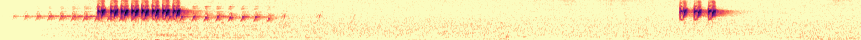

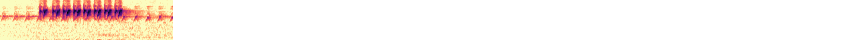

XC256770  SPTO  3.7s  A  song  United States/Colorado/Boulder County/Boulder  2015-07-12  Ted Floyd[by-nc-sa]


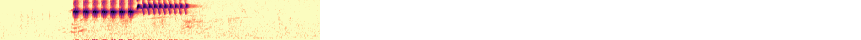

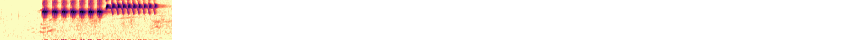

XC131561  SPTO  60.9s  A  song  United States/California/Sierra County/Antelope Valley  2012-06-21  Eric DeFonso[by-nc-sa]


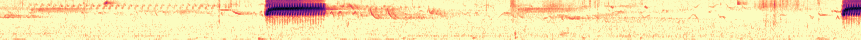

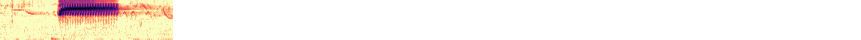

XC127027  SPTO/falcinellus  44.9s  A  song  United States/California/Inyo/Sage Flats Road  2000-06-16  Richard E. Webster[by-nc-sa]


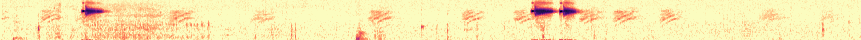

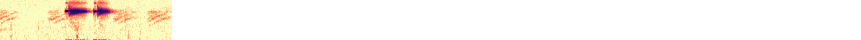

XC323292  SPTO/montanus  156.4s  A  nasal call, song  United States/Arizona/Portal  2015-06-25  Richard E. Webster[by-nc-sa]


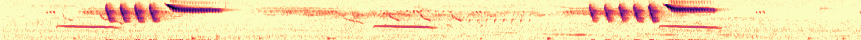

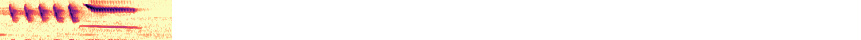

XC126685  SPTO/megalonyx  57.5s  A  song  United States/San Bernardino Mountains/Santa Ana River Valley  2000-06-01  Richard E. Webster[by-nc-sa]


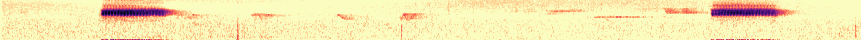

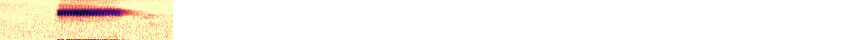

XC126673  SPTO/megalonyx  56.9s  A  song  United States/San Diego County/San Diego River/Old Mission Dam  1995-07-08  Richard E. Webster[by-nc-sa]


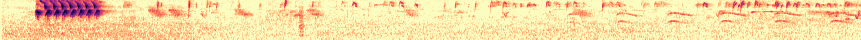

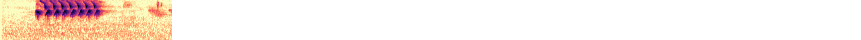

XC89392  SPTO/megalonyx  18.1s  A  call  United States/CA/Santa Cruz Island/Scorpion Canyon  2011-10-28  Steve Hampton[by-nc-nd]


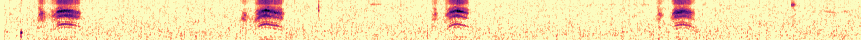

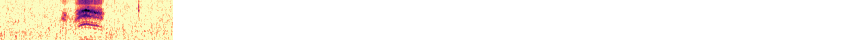

XC146160  SPTO  81.4s  A  song  United States/California/San Diego Co/Cleveland National Forest/N of Buckman Springs Rd/Sheephead Mt Rd by I-8 rest area  2013-04-26  Paul Marvin[by-nc-sa]


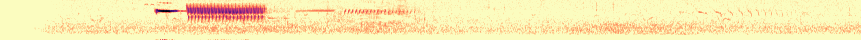

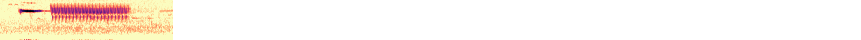

XC205280  SPTO  531.4s  A  song  United States/Colorado/Boulder County/Longmont/Rabbit Mountain Park  2014-04-07  Eric DeFonso[by-nc-sa]


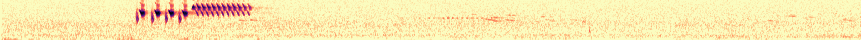

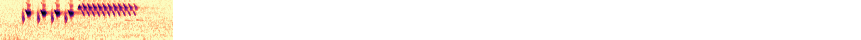

XC126761  SPTO/montanus  95.1s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1997-03-19  Richard E. Webster[by-nc-sa]


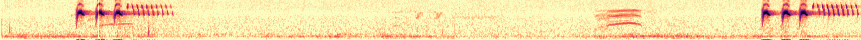

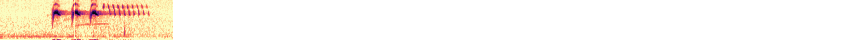

XC205870  SPTO  20.4s  A  song  United States/Colorado/Montezuma County/Yellowjacket Canyon  2014-05-31  Eric DeFonso[by-nc-sa]


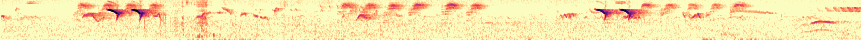

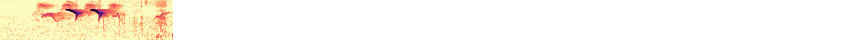

XC126678  SPTO/megalonyx  33.3s  A  song  United States/California/San Bernardino/San Bernardino Mountains/Rose Mine Valley  1998-05-17  Richard E. Webster[by-nc-sa]


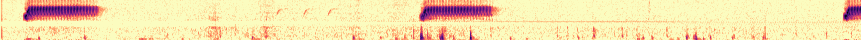

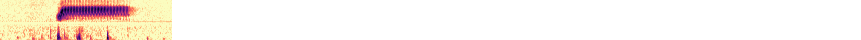

XC126658  SPTO/montanus  20.5s  A  song  United States/California/Inyo/White Mountains/Wyman Canyon  1995-06-02  Richard E. Webster[by-nc-sa]


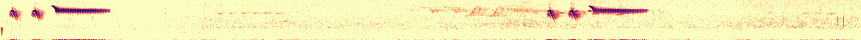

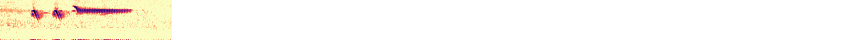

XC126979  SPTO/montanus  126.4s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1995-05-12  Richard E. Webster[by-nc-sa]


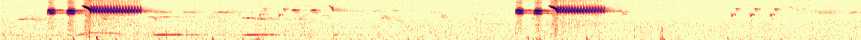

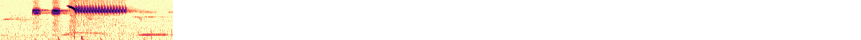

XC254549  SPTO  93.5s  A  song  United States/South Dakota/Custer State Park/Oak Draw Rd  2015-06-24  Jonathon Jongsma[by-sa]


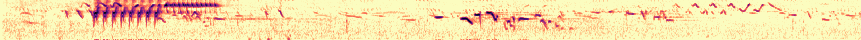

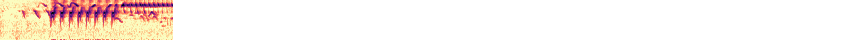

XC274872  SPTO/oaxacae  14.1s  A  song  Mexico/Teotitlan de Valle /Oaxaca  2015-03-29  Frank Lambert[by-nc-nd]


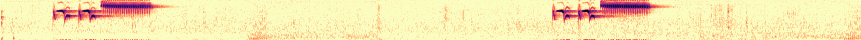

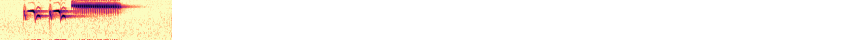

XC325379  SPTO/falcinellus  2.9s  A  song  United States/California/Sacramento County/Mather Lake  2016-07-03  Jim Holmes[by-nc-sa]


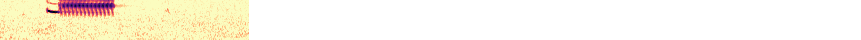

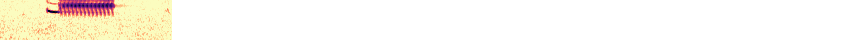

XC77904  SPTO  55.4s  A  Song  United States/Idaho/Bingham County/Goshen  2011-05-13  Ryan P. O'Donnell[by-nc-nd]


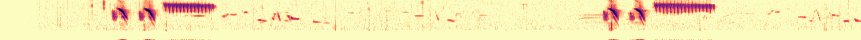

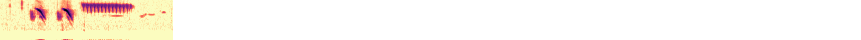

XC317090  SPTO  54.3s  A  song  United States/Arizona/Cochise County/Portal/Cave Creek Ranch  2016-05-13  Russ Wigh[by-nc-sa]


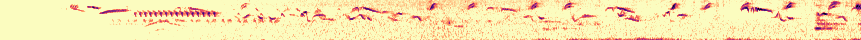

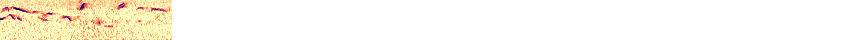

XC352568  SPTO/griseipygius  30.4s  A  song, trills  Mexico/Durango/Bajío Largo  2015-04-13  Frank Lambert[by-nc-nd]


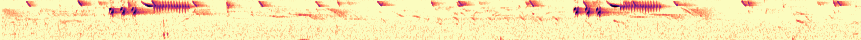

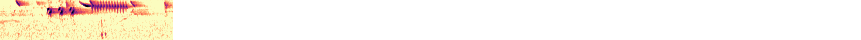

XC159434  SPTO  86.4s  A  mew calls  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-09-02  Ian Cruickshank[by-nc-nd]


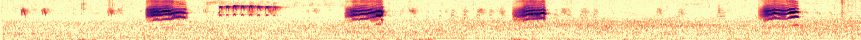

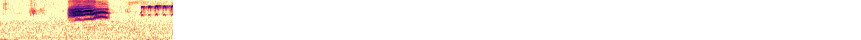

XC325228  SPTO  21.7s  A  song  Canada/British Columbia/Saanichton  2016-04-07  James Bradley[by-nc-sa]


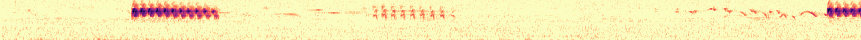

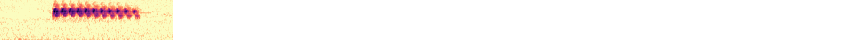

XC254476  SPTO  12.3s  A  song  United States/Colorado/Larimer County/Horsetooth Mountain Park  2015-05-17  Nick Komar[by-nc-sa]


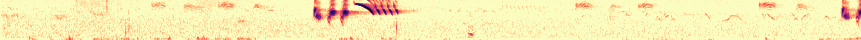

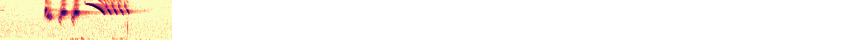

XC127002  SPTO/falcinellus  22.4s  A  call, song  United States/California/Tulare/Chimney Creek  2000-07-07  Richard E. Webster[by-nc-sa]


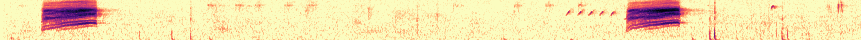

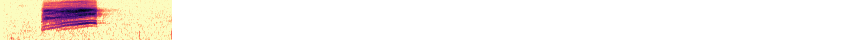

XC126986  SPTO/megalonyx  130.1s  A  song  United States/California/San Diego/Middle Peak  1998-05-19  Richard E. Webster[by-nc-sa]


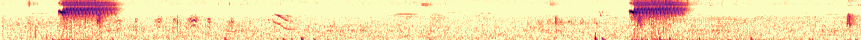

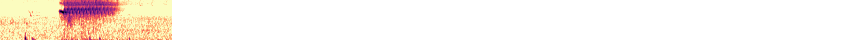

XC364820  SPTO  53.5s  A  trill  United States/Washington/King County/Marymoor Park  2017-04-16  Bruce Lagerquist[by-nc-sa]


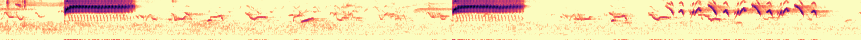

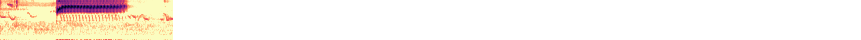

XC158981  SPTO  78.3s  A  call,song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-07-11  Ian Cruickshank[by-nc-nd]


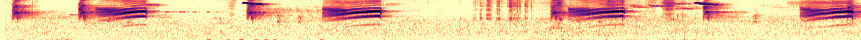

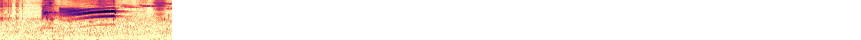

XC375917  SPTO  98.9s  A  call  United States/Nevada/Churchill County/Desatoya Range/Bassie Canyon  2017-06-10  Bobby Wilcox[by-nc-sa]


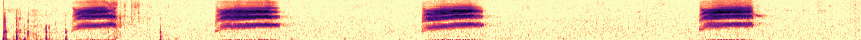

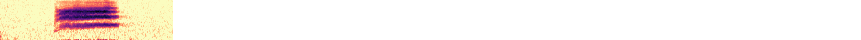

XC126478  SPTO/montanus  59.4s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  2000-05-21  Richard E. Webster[by-nc-sa]


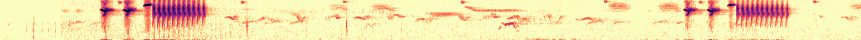

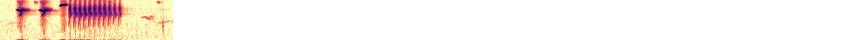

XC160171  SPTO  118.4s  A  song  Canada/BC/Vancouver Island/Aylard Farm/East Sooke Park  2013-04-20  Ian Cruickshank[by-nc-nd]


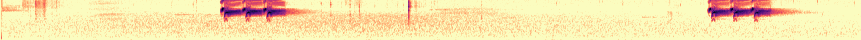

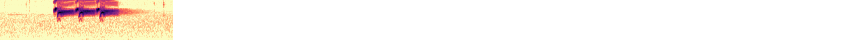

XC127014  SPTO/megalonyx  113.5s  A  call, song  United States/San Diego County/SDNWR/Sweetwater River  2001-05-13  Richard E. Webster[by-nc-sa]


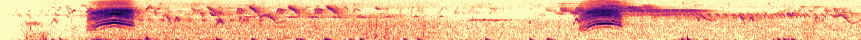

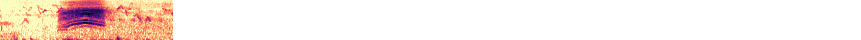

XC127000  SPTO/falcinellus  84.2s  A  song  United States/California/Inyo/Olancha Pass Trail  1995-05-19  Richard E. Webster[by-nc-sa]


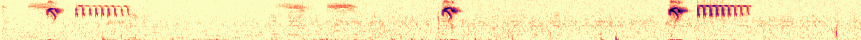

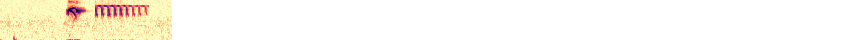

XC126764  SPTO/falcinellus  123.8s  A  song  United States/California/Inyo/Sage Flats Road  1995-05-19  Richard E. Webster[by-nc-sa]


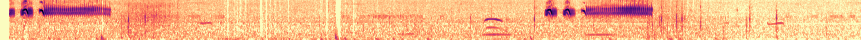

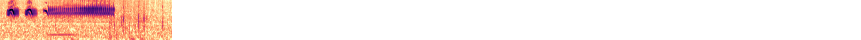

XC126763  SPTO/montanus  127.2s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1995-05-12  Richard E. Webster[by-nc-sa]


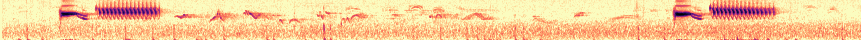

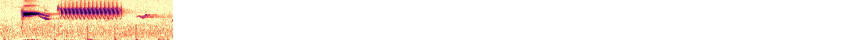

XC181454  SPTO  33.5s  A  song  United States/Arizona/Maricopa County/Slate Creek Divide/Pigeon Spring  2014-06-07  Tim Marquardt[by-nc-sa]


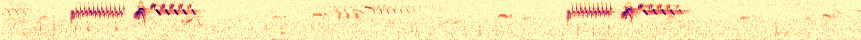

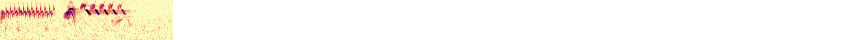

XC302773  SPTO/montanus  374.5s  A  song  United States/Arizona/Maricopa County/Tonto National Forest/Mt. Ord  2013-08-19  Lauren Harter[by-nc-sa]


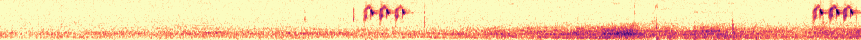

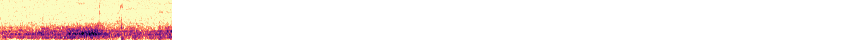

XC14231  SPTO  43.8s  A  song  United States/California/Santa Clara County/Los Altos  2007-07-01  Chris Parrish[by-nc-nd]


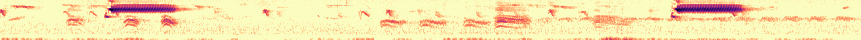

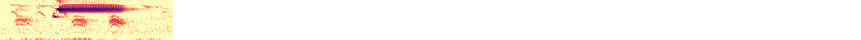

XC104528  SPTO  81.4s  A  song  United States/South Dakota/Custer State Park/Oak Draw Rd  2012-06-21  Jonathon Jongsma[by-sa]


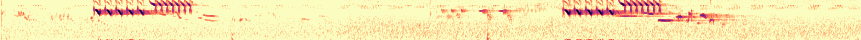

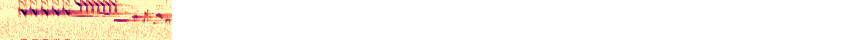

XC126646  SPTO/montanus  11.4s  A  song  United States/California/San Bernardino/Clark Mountain  1995-05-27  Richard E. Webster[by-nc-sa]


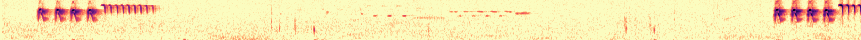

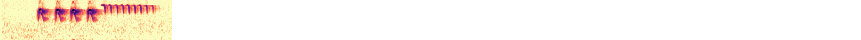

XC159516  SPTO  96.0s  A  mew calls  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-09-08  Ian Cruickshank[by-nc-nd]


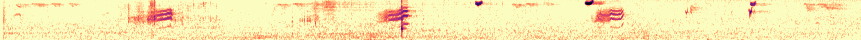

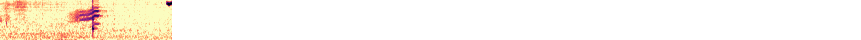

XC126634  SPTO/megalonyx  20.4s  A  song  United States/San Bernardino Mountains/Santa Ana River Valley  1998-06-16  Richard E. Webster[by-nc-sa]


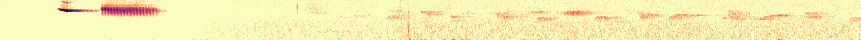

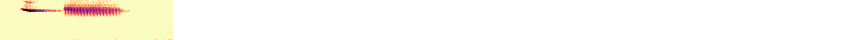

XC126990  SPTO/montanus  167.0s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1998-05-23  Richard E. Webster[by-nc-sa]


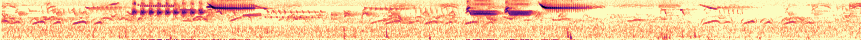

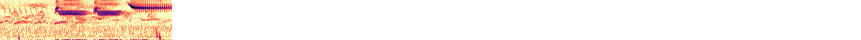

XC375916  SPTO  106.5s  A  male, song  United States/Nevada/Churchill County/Desatoya Range/Bassie Canyon  2017-06-10  Bobby Wilcox[by-nc-sa]


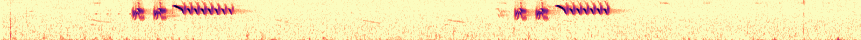

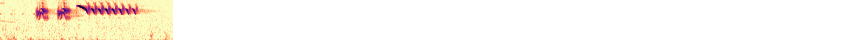

XC72247  SPTO/umbraticola  81.2s  A  song  Mexico/Baja California/Sierra San Pedro Martir/La Corona Arriba  2001-06-16  Richard E Webster[by-nc-nd]


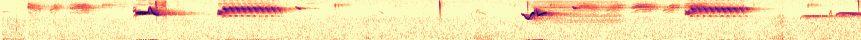

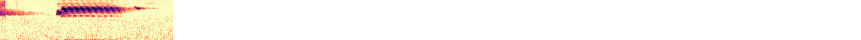

XC127003  SPTO/megalonyx  69.6s  A  call, song  United States/California/San Diego/Point Loma  1995-05-24  Richard E. Webster[by-nc-sa]


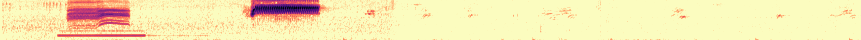

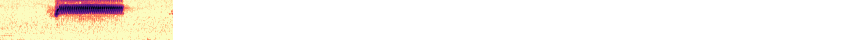

XC219343  SPTO  73.8s  A  call  United States/California/San Luis Obispo County/Cayucos/Harmony Headlands State Park  2015-03-08  Thomas G. Graves[by-nc-sa]


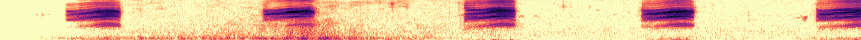

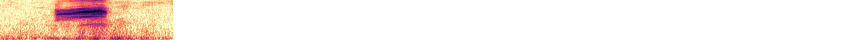

XC163627  SPTO/oregonus  43.4s  A  song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2011-02-20  Ian Cruickshank[by-nc-sa]


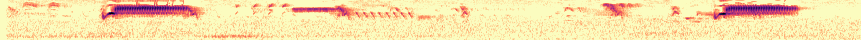

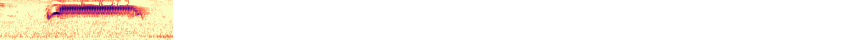

XC312025  SPTO  87.5s  A  alarm call, song  United States/Cerro Alto Campground/California/Atascadero  2016-04-11  Thomas G. Graves[by-nc-sa]


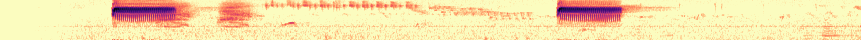

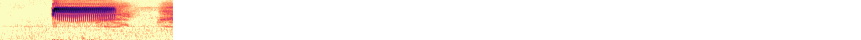

XC111826  SPTO/montanus  20.5s  A  song  United States/Arizona/Cochise County/Chiricahua Mountains/South Fork Cave Creek Canyon  2008-05-24  Richard E Webster[by-nc-nd]


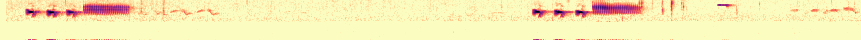

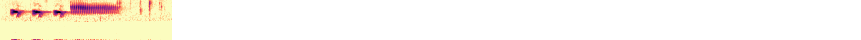

XC319571  SPTO/oregonus  22.6s  A  call, male  Canada/British Columbia/Capital/Saanich (near  Victoria)  2016-06-01  Brent Beach[by-nc-sa]


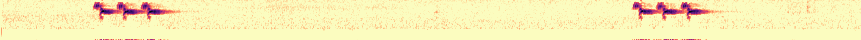

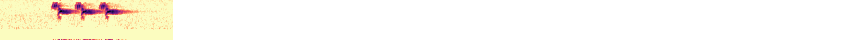

XC353077  SPTO/macronyx  38.0s  A  song  Mexico/Distrito Federal/La Cima  2017-01-27  Manuel Grosselet[by-nc-sa]


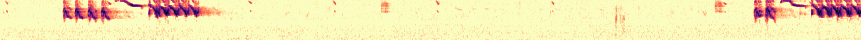

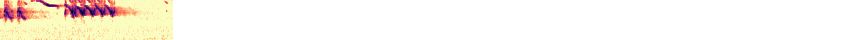

XC34581  SPTO/gaigei  97.8s  A  song  United States/Texas/Brewster Co./Big Bend National Park/Chisos Basin  2009-05-18  Andrew Spencer[by-nc-nd]


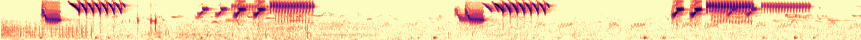

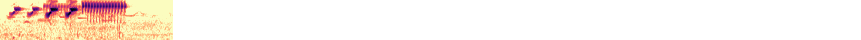

XC320564  SPTO  77.9s  A  song  United States/Colorado/Alamosa County/Zapata Ranch  2016-05-31  Ted Floyd[by-nc-sa]


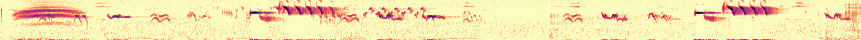

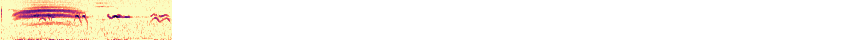

XC368294  SPTO  64.5s  A  song  United States/California/Solano County/Blue Ridge Road  2017-05-05  Jim Holmes[by-nc-sa]


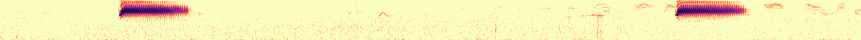

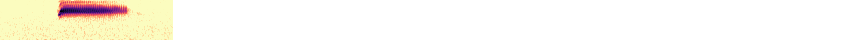

XC182544  SPTO  35.8s  A  song  United States/Colorado/Boulder County/Boulder  2014-06-17  Ted Floyd[by-nc-sa]


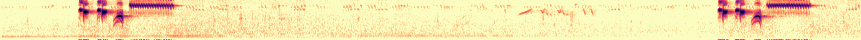

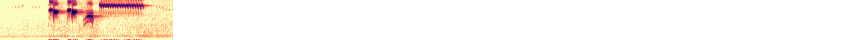

XC261399  SPTO  87.6s  A  song  Mexico/Veracruz/Aquila  2015-07-18  Manuel Grosselet[by-nc-sa]


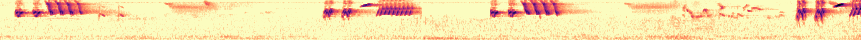

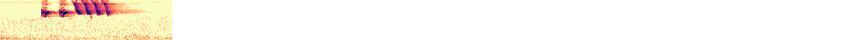

XC172446  SPTO  193.0s  A  song  United States/Colorado/Boulder County/Longmont/Rabbit Mountain Park  2013-04-07  Eric DeFonso[by-nc-sa]


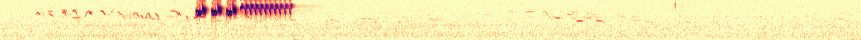

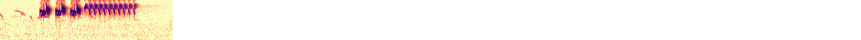

XC381708  SPTO  42.4s  A  call  United States/California/Sierra County/Antelope Valley  2000-06-15  Jeremy Minns[by-nc-sa]


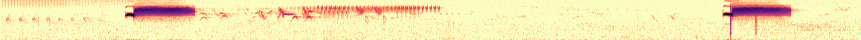

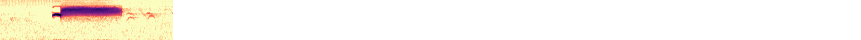

XC159113  SPTO  78.3s  A  call  Canada/BC/Vancouver Island/Cowichan Lake/Nixon Creek  2012-08-02  Ian Cruickshank[by-nc-nd]


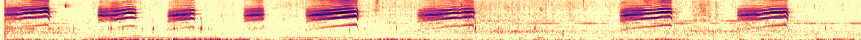

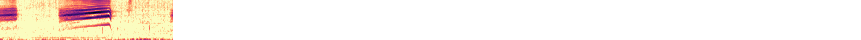

XC323289  SPTO/montanus  414.9s  A  song  United States/Arizona/Portal  2015-06-09  Richard E. Webster[by-nc-sa]


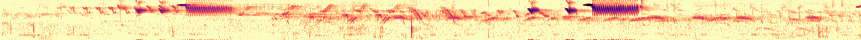

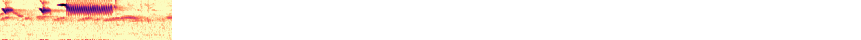

XC376227  SPTO  60.0s  A  song  United States/Colorado/Boulder County/El Dorado Spgs/Spring Brook Trail  2017-06-18  Ted Floyd[by-nc-sa]


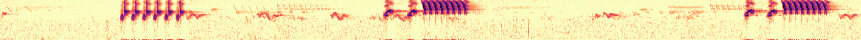

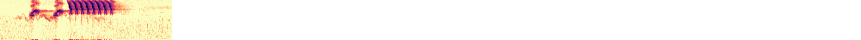

XC274874  SPTO/oaxacae  35.6s  A  song  Mexico/Teotitlan de Valle /Oaxaca  2015-03-30  Frank Lambert[by-nc-nd]


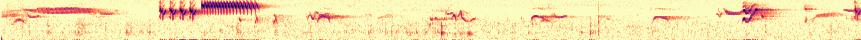

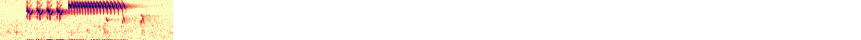

XC35907  SPTO/oregonus  34.2s  A  Song  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


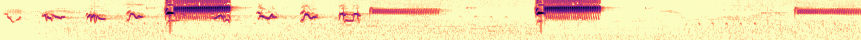

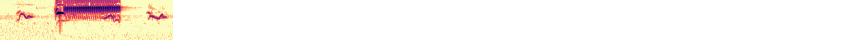

XC126679  SPTO/falcinellus  36.3s  A  song  United States/California/Inyo/Sage Flats Road  2000-06-16  Richard E. Webster[by-nc-sa]


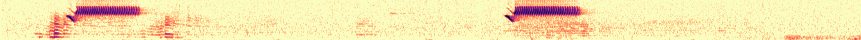

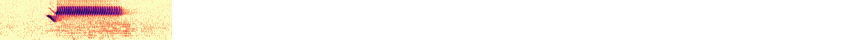

XC159430  SPTO  66.6s  A  mew calls  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-09-01  Ian Cruickshank[by-nc-nd]


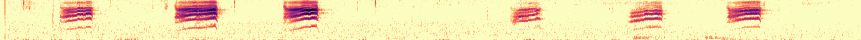

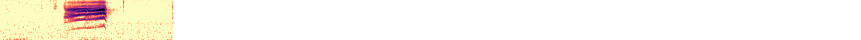

XC367803  SPTO  180.6s  A  song  United States/Colorado/Logan County/E Sector/Tamarack Ranch SWA  2016-06-01  Eric DeFonso[by-nc-sa]


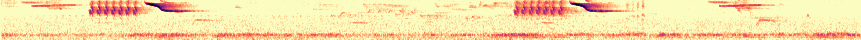

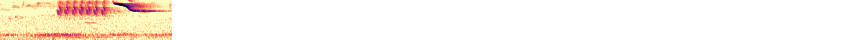

XC183584  SPTO/oregonus  62.4s  A  song  Canada/British Columbia/Capital/Saanich (near  Victoria)  2014-06-24  Ian Cruickshank[by-nc-sa]


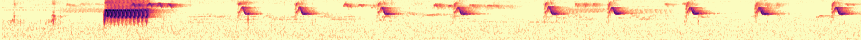

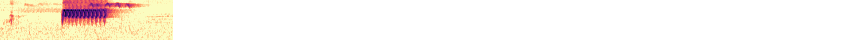

XC408095  SPTO  79.8s  A  song  United States/California/Orange County/Irvine/San Joquin Wildlife Sanctuary  2015-05-17  Frank Lambert[by-nc-nd]


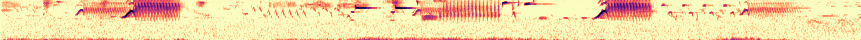

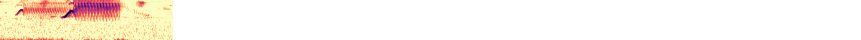

XC126686  SPTO/megalonyx  57.7s  A  song  United States/California/San Diego/Middle Peak  2000-06-11  Richard E. Webster[by-nc-sa]


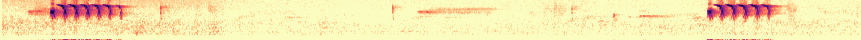

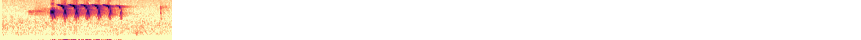

XC126629  SPTO/megalonyx  12.7s  A  song  United States/California/San Bernardino/San Bernardino Mountains/Arrastre Creek at 3N03  2000-07-09  Richard E. Webster[by-nc-sa]


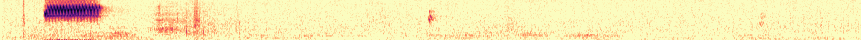

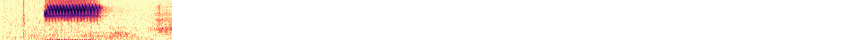

XC126706  SPTO/falcinellus  79.6s  A  call, song  United States/California/Inyo/Sage Flats Road  2000-06-16  Richard E. Webster[by-nc-sa]


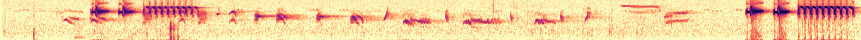

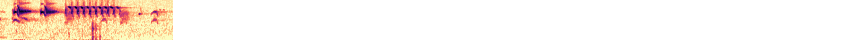

XC112078  SPTO/montanus  54.4s  A  song  United States/Arizona/Cochise County/Chiricahua Mountains/Pinery Canyon  2008-05-14  Richard E Webster[by-nc-nd]


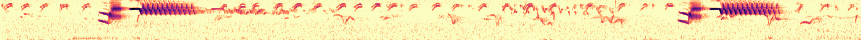

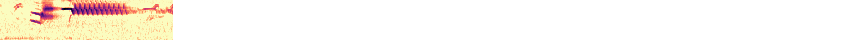

XC160228  SPTO  19.3s  A  call  Canada/BC/Vancouver Island/Sooke/Broom Hill  2013-04-25  Ian Cruickshank[by-nc-nd]


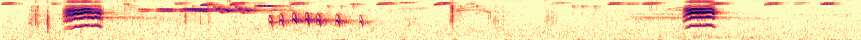

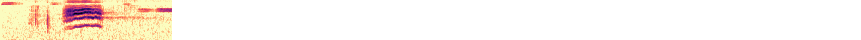

XC159542  SPTO  182.9s  A  mew calls, high mew calls, and subsong  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-09-11  Ian Cruickshank[by-nc-nd]


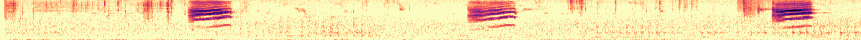

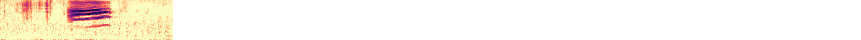

XC172198  SPTO  24.1s  A  call  United States/Arizona/Yavapai/Prescott National Forest (near  Prescott)  2014-03-29  Micah Riegner[by-nc-sa]


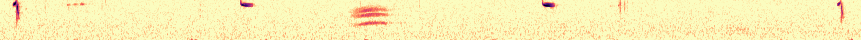

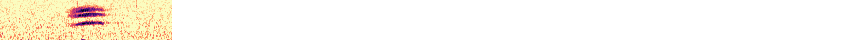

XC126665  SPTO/montanus  32.3s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  1997-03-19  Richard E. Webster[by-nc-sa]


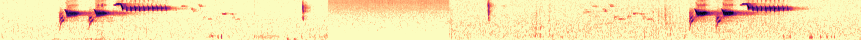

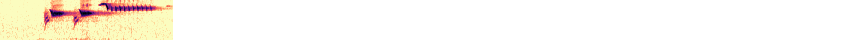

XC126654  SPTO/falcinellus  22.8s  A  song  United States/Inyo County/Haiwee Creek  2000-06-15  Richard E. Webster[by-nc-sa]


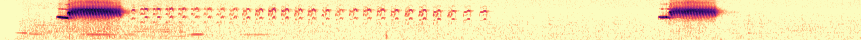

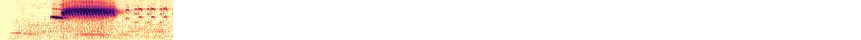

XC302569  SPTO/montanus  98.0s  A  call, song  United States/Arizona/Maricopa County/Tonto National Forest/Mt. Ord  2013-08-19  Lauren Harter[by-nc-sa]


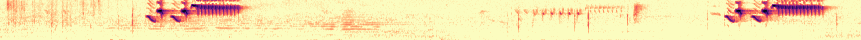

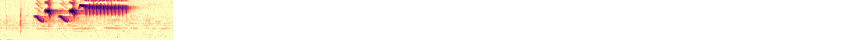

XC168048  SPTO  34.2s  A  song  Mexico/Mex DF entrance Desierto de los Leones  2014-02-23  Manuel Grosselet[by-nc-sa]


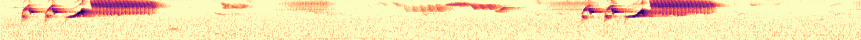

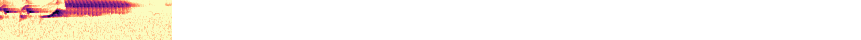

XC159976  SPTO  100.1s  A  jumbled song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2013-02-26  Ian Cruickshank[by-nc-nd]


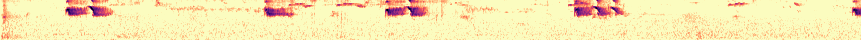

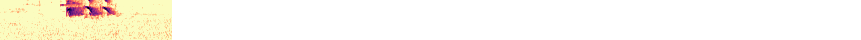

XC126693  SPTO/megalonyx  69.5s  A  song  United States/San Diego County/SDNWR/Sweetwater River  2001-05-13  Richard E. Webster[by-nc-sa]


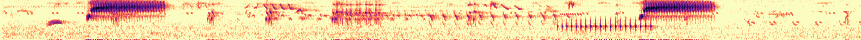

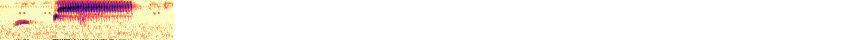

XC76207  SPTO/oregonus  46.8s  A  call  United States/Washington/King Co./Cougar Mountain Regional Wildland Park  2011-04-20  Andrew Spencer[by-nc-nd]


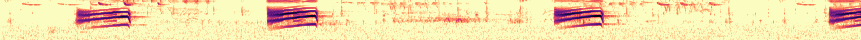

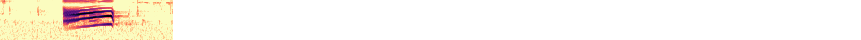

XC126999  SPTO/falcinellus  58.0s  A  song  United States/California/Inyo/Sage Flats Road  2000-06-17  Richard E. Webster[by-nc-sa]


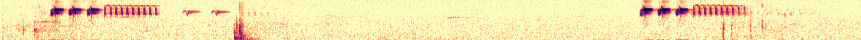

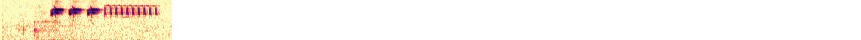

XC160006  SPTO  115.1s  A  song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2013-03-17  Ian Cruickshank[by-nc-nd]


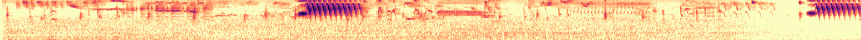

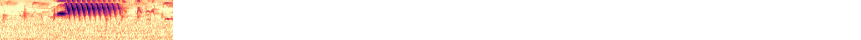

XC408816  SPTO/clementae?  36.0s  A  song  United States/California/San Bernardino County/Rimforest  2015-05-09  Frank Lambert[by-nc-nd]


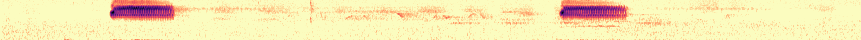

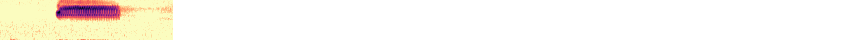

XC367065  SPTO  37.9s  A  call  United States/California/San Luis Obispo County/California (near  Arroyo Grande)  2017-04-12  Thomas G. Graves[by-nc-sa]


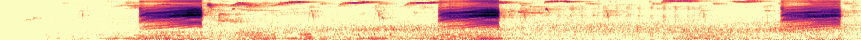

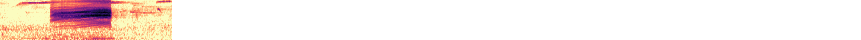

XC326450  SPTO/montanus  59.0s  A  song  United States/Arizona/Santa Cruz County/Madera Canyon/Super Trail  2016-07-03  Nick Komar[by-nc-sa]


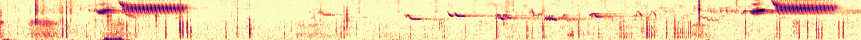

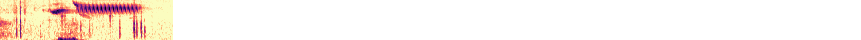

XC195846  SPTO  10.2s  A  odd variant song, song  United States/California/Fresno County/Shaver Lake  2014-04-24  Elias Aristides Elias[by-nc-sa]


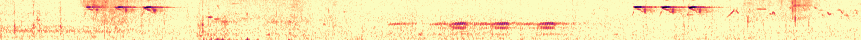

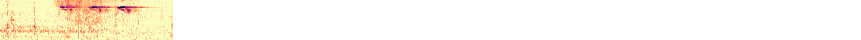

XC79109  SPTO  59.3s  A  Song  United States/Utah/Washington County/Utah Hill  2011-05-21  Ryan P. O'Donnell[by-nc-nd]


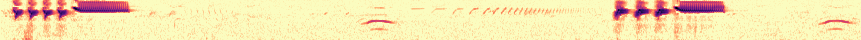

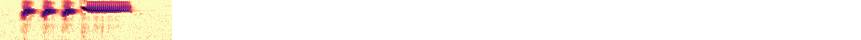

XC126662  SPTO/montanus  22.0s  A  song  United States/California/San Bernardino/Clark Mountain  1995-05-27  Richard E. Webster[by-nc-sa]


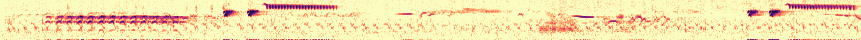

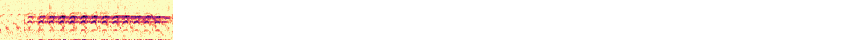

In [ ]:
for rec in df_rows(xc_recs
    .query("species == 'SPTO'")
    .query("quality == 'A'")
    .pipe(tap, lambda df: print(len(df)))
    .sample(random_state=0,
        n=100,
    )
):
    print(xc_rec_str_line(rec))
    plot_spectro_micro(rec, features,
        # audio=True,
    )
    plot_thumb_micro(rec, features,
        thumb_s=2,
        # audio=True,
        # verbose=True,
    )
    plt.show()

163
XC179080  HOWR  28.3s  A  call  United States/Pennsylvania/Lancaster Co./W Lancaster  2014-05-01  Dan Lane[by-nc-sa]


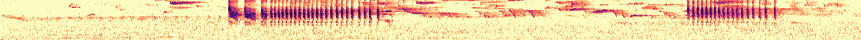

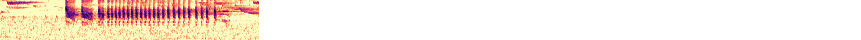

XC384758  HOWR/intermedius  84.8s  A  song  Mexico/Veracruz/Mecayapan/Huazuntlán  2017-08-24  Manuel Grosselet[by-nc-sa]


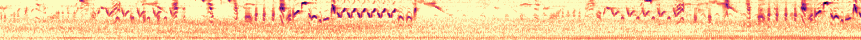

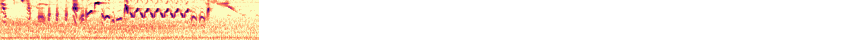

XC72425  HOWR/parkmanii  37.9s  A  call  Mexico/Baja California/Sierra San Pedro Martir/Meling Ranch  2010-09-26  Richard E Webster[by-nc-nd]


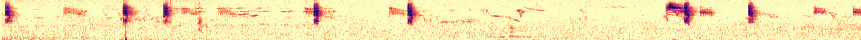

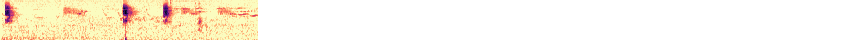

XC390110  HOWR/parkmanii  69.7s  A  call  United States/California/Santa Barbara/Los Padres National Forest  2017-09-11  Guy Kirwan[by-nc-sa]


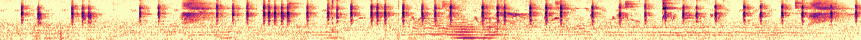

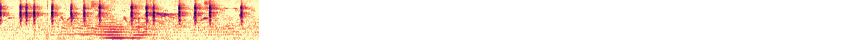

XC278239  HOWR  68.2s  A  song  Canada/SK/3 km south of Fishing Lake  2015-06-29  Patrick Turgeon[by-nc-sa]


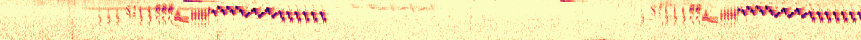

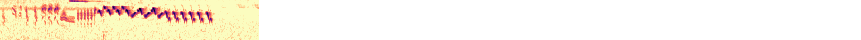

XC372868  HOWR  41.1s  A  call  United States/Arizona/Cochise County/Chiricahua Mountains/Cave Creek Canyon/Sunny Flat Campground  2017-05-14  Vicki Dern[by-nc-sa]


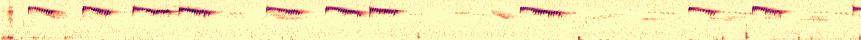

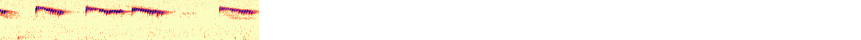

XC179088  HOWR  94.8s  A  call, female song, song  United States/Pennsylvania/Lancaster Co./W Lancaster  2014-05-02  Dan Lane[by-nc-sa]


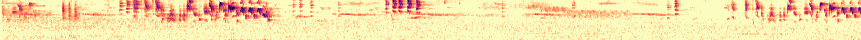

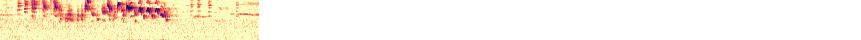

XC305012  HOWR  33.5s  A  song  United States/Kentucky/Fayette County/Jacobson Park  2015-05-09  Antonio Xeira[by-nc-sa]


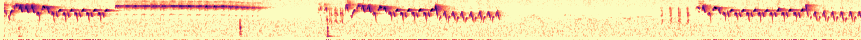

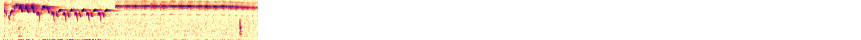

XC316676  HOWR  63.0s  A  song  United States/Colorado/Bent County/Melody Temple Grove  2016-05-09  Sue Riffe[by-nc-sa]


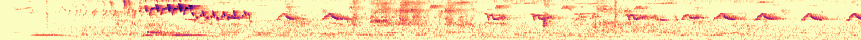

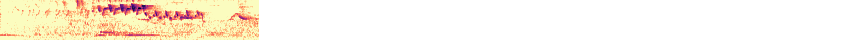

XC231548  HOWR  18.3s  A  song  Mexico/Oaxaca/Cerro San Felipe (La Cumbre)  2001-03-11  Peter Boesman[by-nc-nd]


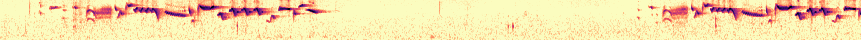

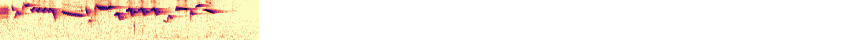

XC380641  HOWR  69.8s  A  call  United States/Arizona/Cochise Co./Carr Canyon/Rd between Reef Townsite and Ramsey Vista Campgrounds  2017-07-01  Vicki Dern[by-nc-sa]


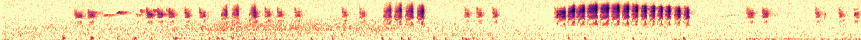

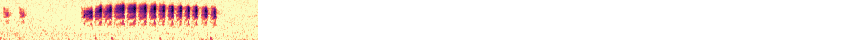

XC331989  HOWR  156.8s  A  song  United States/Colorado/Larimer County/Sylvan Dale Guest Ranch  2016-07-08  Sue Riffe[by-nc-sa]


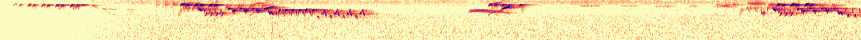

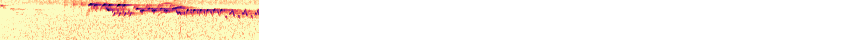

XC80357  HOWR/parkmanii  33.2s  A  Song  United States/Utah/Cache County/Logan  2011-06-07  Ryan P. O'Donnell[by-nc-nd]


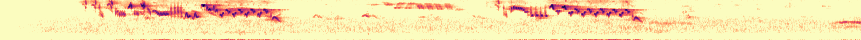

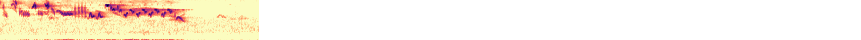

XC313767  HOWR  39.7s  A  song  United States/Illinois/DuPage County/Elsen's Hill  2016-04-24  Matt Wistrand[by-nc-sa]


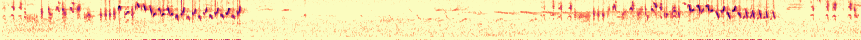

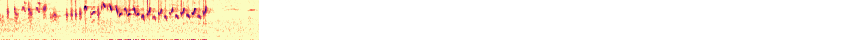

XC72420  HOWR/parkmanii  67.7s  A  song  Mexico/Baja California/Sierra San Pedro Martir/Meling Ranch  2006-05-08  Richard E Webster[by-nc-nd]


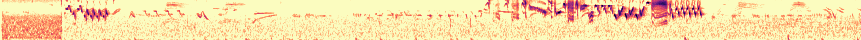

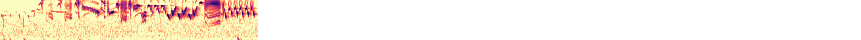

XC217219  HOWR  38.3s  A  call, chatter/scold  United States/Louisiana/Red River Parish/4 (near  Mansfield)  2014-10-26  Terry Davis[by-nc-sa]


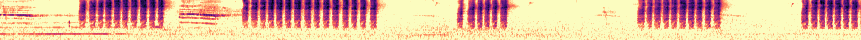

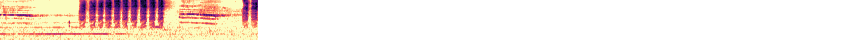

XC415510  HOWR  58.0s  A  song  United States/Arizona/Portal/Cave Creek Ranch  2018-05-06  Russ Wigh[by-nc-sa]


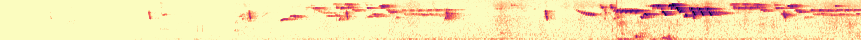

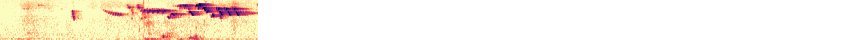

XC338020  HOWR/cahooni  45.8s  A  call  Mexico/Sonora/Yécora/Mesa El Campanero  2013-08-16  Richard E. Webster[by-nc-sa]


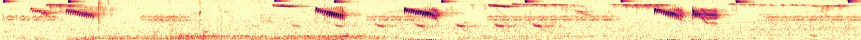

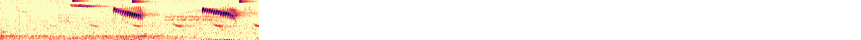

XC351128  HOWR/parkmanii  102.6s  A  call, song  United States/San Diego County/San Diego River/Old Mission Dam  1995-06-11  Richard E. Webster[by-nc-sa]


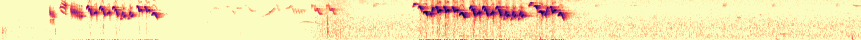

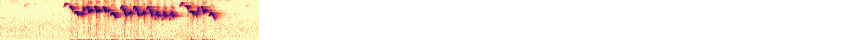

XC351153  HOWR/parkmanii  50.1s  A  call  United States/California/San Bernardino Mountains/Arrastre Creek at 2N02  1998-07-29  Richard E. Webster[by-nc-sa]


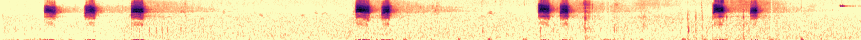

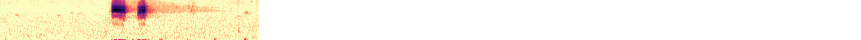

XC402751  HOWR  17.7s  A  call  Mexico/Nuevo León/Guadalupe/Guadalupe  2017-10-27  Marilyn Castillo[by-nc-nd]


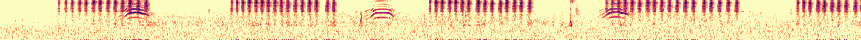

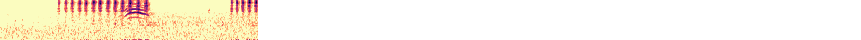

XC321087  HOWR  4.3s  A  song  United States/Delaware/Sussex County/Milton  2016-06-11  Jerald R[by-nc-sa]


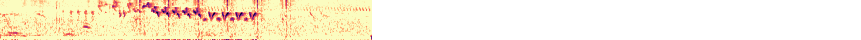

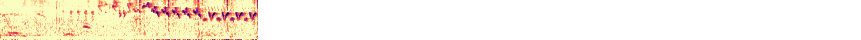

XC252193  HOWR/brunneicollis  15.5s  A  call  Mexico/Mex DF entrance Desierto de los Leones  2015-06-10  Manuel Grosselet[by-nc-sa]


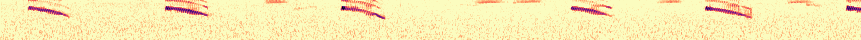

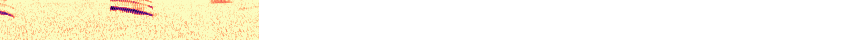

XC290447  HOWR  1.7s  A  female, song  United States/Michigan/Barry County/Prairieville (near  Delton)  2012-05-08  Cara A. Krieg[by-nc-sa]


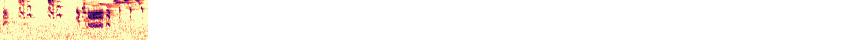

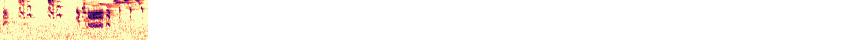

XC217221  HOWR  38.3s  A  call  United States/Louisiana/Red River Parish/4 (near  Mansfield)  2014-10-26  Terry Davis[by-nc-sa]


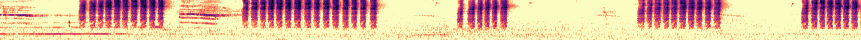

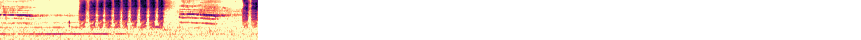

XC205809  HOWR  16.4s  A  call  United States/Colorado/Delta County/Delta/Confluence Park  2014-05-29  Eric DeFonso[by-nc-sa]


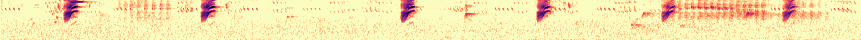

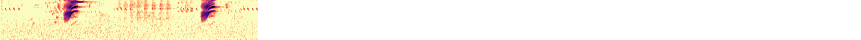

XC351129  HOWR/parkmanii  114.1s  A  song  United States/California/San Bernardino Mountains/Arrastre Creek at 2N02  2000-05-24  Richard E. Webster[by-nc-sa]


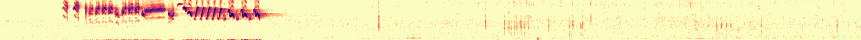

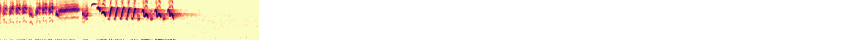

XC128910  HOWR  173.0s  A  call, song  United States/Cerro Alto Campground/California/Atascadero  2013-04-06  Thomas G. Graves[by-nc-sa]


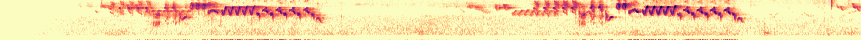

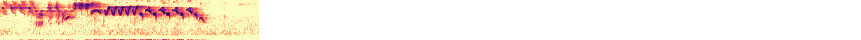

XC290436  HOWR  2.1s  A  female, song  United States/Michigan/Barry County/Prairieville (near  Delton)  2011-06-26  Cara A. Krieg[by-nc-sa]


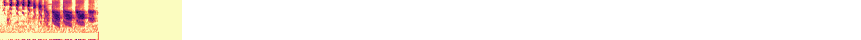

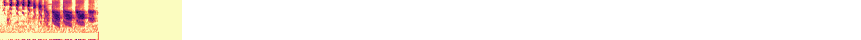

XC324098  HOWR  90.6s  A  song  United States/Arizona/Graham County/Pinalenos/Arcadia Campground  2015-06-03  Richard E. Webster[by-nc-sa]


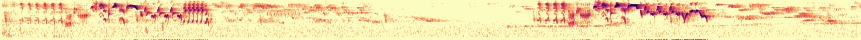

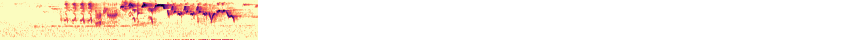

XC290439  HOWR  2.1s  A  female, song  United States/Michigan/Barry County/Prairieville (near  Delton)  2012-05-06  Cara A. Krieg[by-nc-sa]


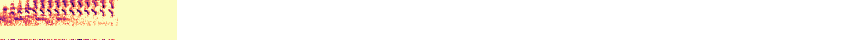

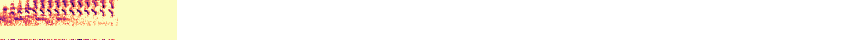

XC21766  HOWR  55.5s  A  song  United States/Arizona/Cochise County/Chiricahua Mountains/Rustler Park  2008-07-14  Chris Parrish[by-nc-nd]


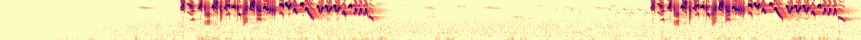

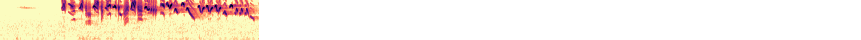

XC351152  HOWR/parkmanii  60.5s  A  song  United States/California/Mono/White Mountains/Cottonwood Basin  2000-05-22  Richard E. Webster[by-nc-sa]


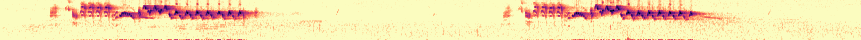

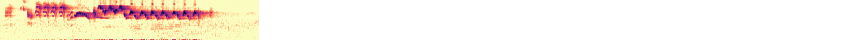

XC383956  HOWR  56.7s  A  song  United States/Kentucky/Fayette County/Jacobson Park  2015-05-03  Antonio Xeira[by-nc-sa]


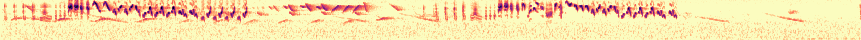

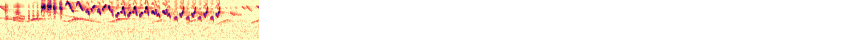

XC385117  HOWR  8.5s  A  call, cheer call  United States/Colorado/Larimer County/Lory State Park  2017-09-03  Nick Komar[by-nc-sa]


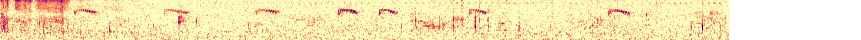

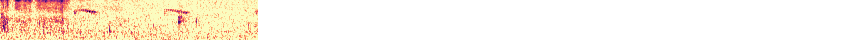

XC373908  HOWR  64.8s  A  song  United States/Arizona/Cochise Co./Chiricahua Mtns/Turkey Creek  2017-05-28  Scott Olmstead[by-nc-sa]


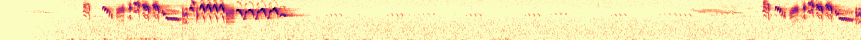

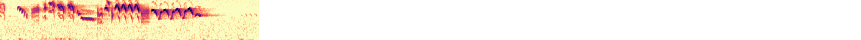

XC182946  HOWR  57.5s  A  song  United States/Cache County/Newton/Newton Reservoir  2014-06-19  Ryan P. O'Donnell[by-nc-sa]


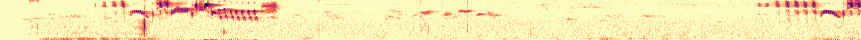

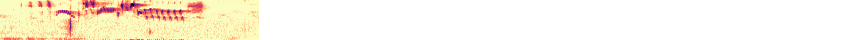

XC263718  HOWR  2.3s  A  female, song  United States/Michigan/Barry County/Prairieville (near  Delton)  2012-06-23  Cara A. Krieg[by-nc-sa]


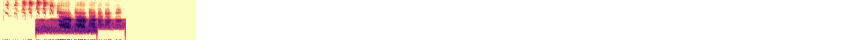

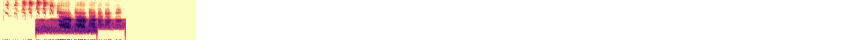

XC332392  HOWR/beani  8.5s  A  call  Mexico/Quintana Roo/Cozumel/San Miguel  2016-08-11  Ross Gallardy[by-nc-sa]


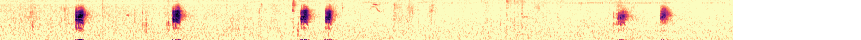

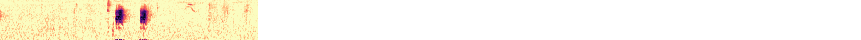

XC342077  HOWR  139.8s  A  song  United States/Washington/Okanogan County/Okanogan/Cameron Lake Road  2016-05-01  Bruce Lagerquist[by-nc-sa]


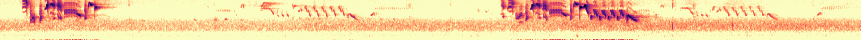

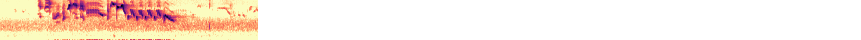

XC305619  HOWR/brunneicollis  68.6s  A  song  Mexico/Mexico DF /Lomas de Tecamachalco  2016-03-05  Manuel Grosselet[by-nc-sa]


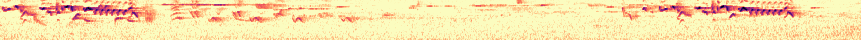

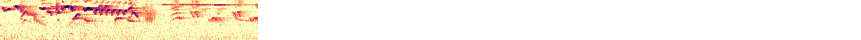

XC332393  HOWR/beani  19.9s  A  call  Mexico/Quintana Roo/Cozumel/San Miguel  2016-08-11  Ross Gallardy[by-nc-sa]


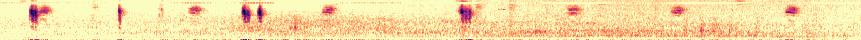

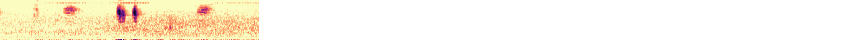

XC284220  HOWR/beani  189.0s  A  song  Mexico/Quintana Roo/Cozumel/San Miguel  2015-05-01  Guy Kirwan[by-nc-sa]


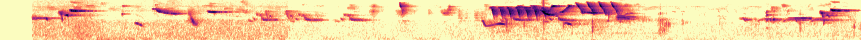

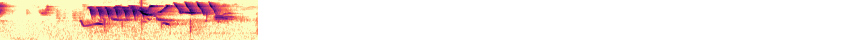

XC86753  HOWR  53.1s  A  call  United States/Minnesota/Carver/Carver Park Reserve  2011-08-28  Jonathon Jongsma[by-sa]


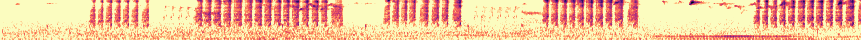

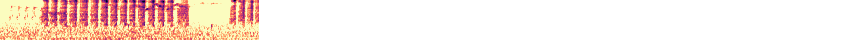

XC351127  HOWR/parkmanii  56.8s  A  song  United States/San Diego County/San Diego River/Old Mission Dam  1995-06-11  Richard E. Webster[by-nc-sa]


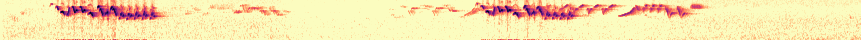

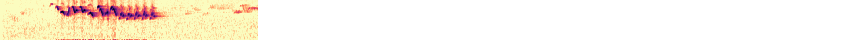

XC389901  HOWR  44.4s  A  song  United States/Michigan/Oakland County/Draper Twin Lake Park  2016-04-27  Antonio Xeira[by-nc-sa]


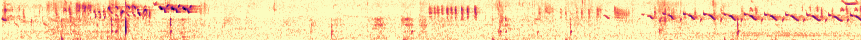

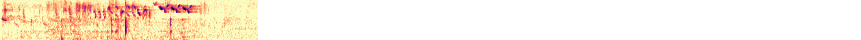

XC82726  HOWR  57.5s  A  Song  United States/Idaho/Bingham County/Goshen  2011-07-02  Ryan P. O'Donnell[by-nc-nd]


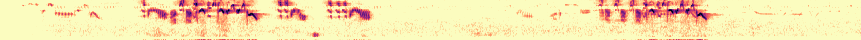

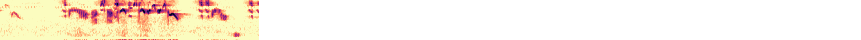

XC71076  HOWR  14.2s  A  scolding call  United States/PA/Elkins Park  2008-06-21  Paul Driver[by-nc-nd]


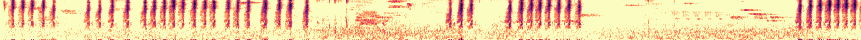

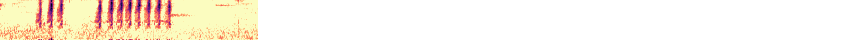

XC13608  HOWR  57.0s  A  song  United States/Colorado/Logan Co./Tamarack Ranch SWA  2007-05-24  Andrew Spencer[by-nc-nd]


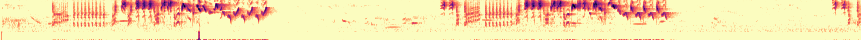

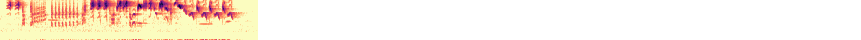

XC231553  HOWR  28.6s  A  song  Mexico/Coahuila/San Antonio de las Alanzas  2000-05-31  Peter Boesman[by-nc-nd]


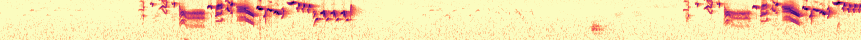

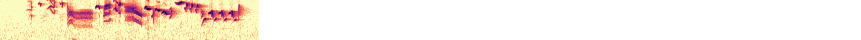

XC289160  HOWR  46.6s  A  song  Mexico/Jardin Botanico/San Miguel de Allende  2015-11-08  Manuel Grosselet[by-nc-sa]


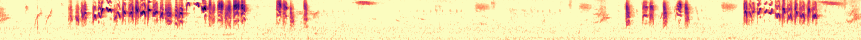

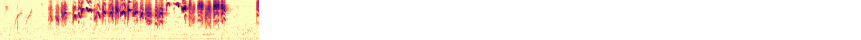

XC72418  HOWR/parkmanii  46.2s  A  song  Mexico/Sierra Juarez/Laguna Hanson  2006-05-12  Richard E Webster[by-nc-nd]


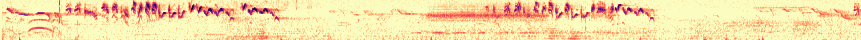

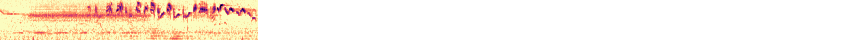

XC159049  HOWR  16.4s  A  adult calls  Canada/BC/Vancouver Island/Metchosin/Pedder Bay  2012-07-25  Ian Cruickshank[by-nc-nd]


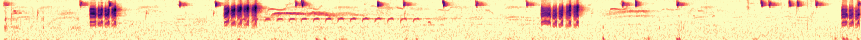

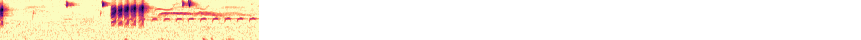

XC317186  HOWR  19.1s  A  song  United States/Delaware/Kent County/Dover  2016-05-10  Jerald R[by-nc-sa]


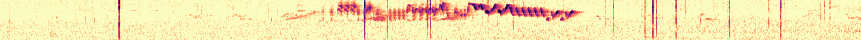

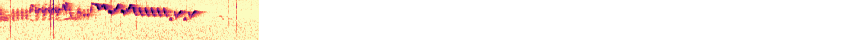

XC72440  HOWR/parkmanii  39.3s  A  song  Mexico/Baja California/Sierra San Pedro Martir/La Corona Arriba  2001-06-15  Richard E Webster[by-nc-nd]


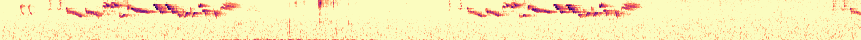

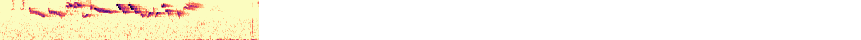

XC352228  HOWR/brunneicollis  16.7s  A  song  Mexico/Sinaloa/Reserva de la Chara Pinta (Tufted Jay Preserve)  2015-04-14  Frank Lambert[by-nc-nd]


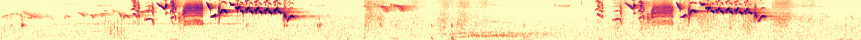

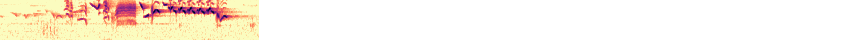

XC71081  HOWR  14.4s  A  song  United States/NJ/Palmyra  2006-07-15  Paul Driver[by-nc-nd]


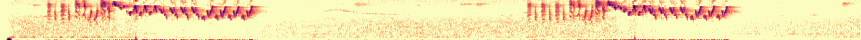

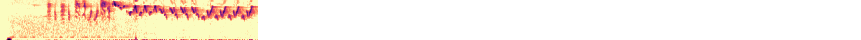

XC290438  HOWR  1.9s  A  female, song  United States/Michigan/Barry County/Prairieville (near  Delton)  2014-06-20  Cara A. Krieg[by-nc-sa]


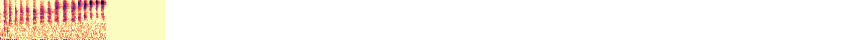

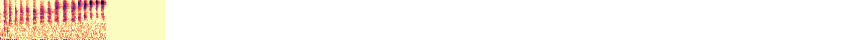

XC67466  HOWR  98.1s  A  Song  United States/Ohio/Cleveland Heights  2010-05-15  Laura Gooch[by-nc-nd]


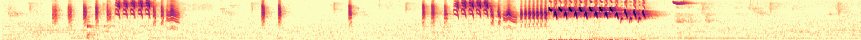

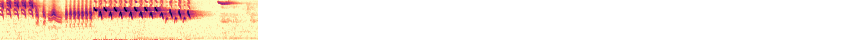

XC21721  HOWR  63.9s  A  song  United States/California/Tioga Pass/Poole Power Plant Road  2008-07-07  Chris Parrish[by-nc-nd]


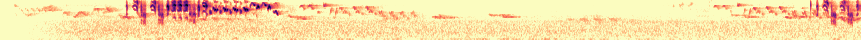

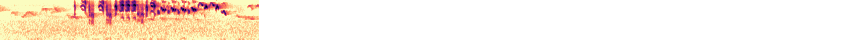

XC188839  HOWR  409.6s  A  call  United States/CA/San Luis Obispo/El Chorro Regional Park  2014-04-12  Thomas G. Graves[by-nc-sa]


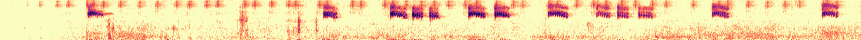

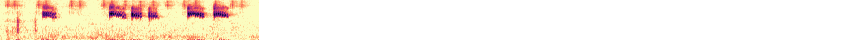

XC312891  HOWR/musculus  80.4s  A  song  Mexico/Veracruz/refineria de SAnta Alejandrina/Minatitlan  2016-04-18  Manuel Grosselet[by-nc-sa]


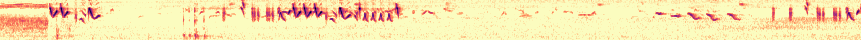

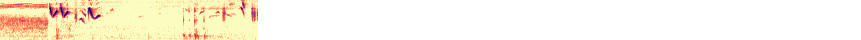

XC72438  HOWR/parkmanii  51.1s  A  song  Mexico/Baja California/ Sierra San Pedro Martir/Los Manzanos  2006-05-09  Richard E Webster[by-nc-nd]


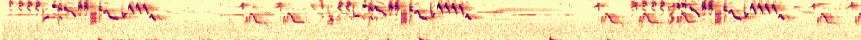

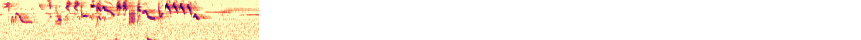

XC332330  HOWR  29.3s  A  call  United States/California/San Diego County/Poway  2016-08-04  Joshua Jaeger[by-nc-sa]


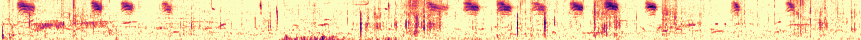

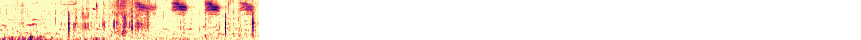

XC381073  HOWR  115.6s  A  song  United States/Colorado/Boulder County/CR 63rd at St. Vrain River  2017-05-04  Sue Riffe[by-nc-sa]


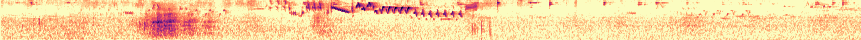

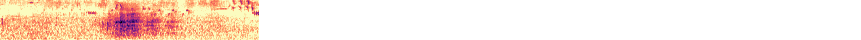

XC304858  HOWR  17.7s  A  song  United States/California/Orange County/Mission Viejo  2016-02-27  Anthony Gliozzo[by-nc-sa]


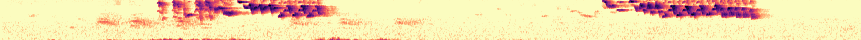

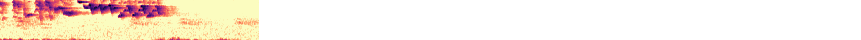

XC185925  HOWR  24.7s  A  song  United States/Wyoming/Fremont County/Lander  2014-07-04  Tim Avery[by-nc-sa]


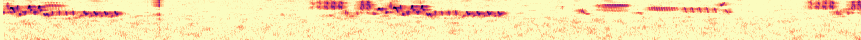

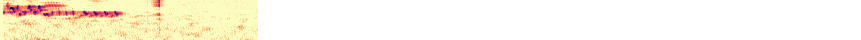

XC79974  HOWR  68.7s  A  song  United States/Minnesota/Rice/Nerstrand Big Woods SP  2011-06-05  Jonathon Jongsma[by-sa]


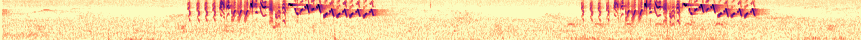

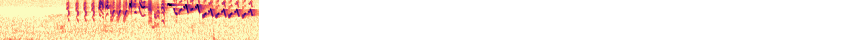

XC278235  HOWR  58.2s  A  song  Canada/SK/3 km south of Fishing Lake  2015-06-29  Patrick Turgeon[by-nc-sa]


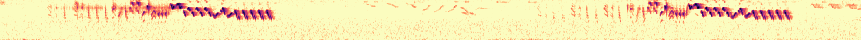

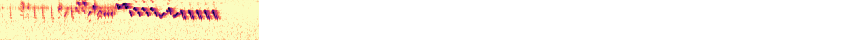

XC35373  HOWR/brunneicollis  168.8s  A  song  United States/Arizona/Cochise Co./Carr Canyon/Reef Campground  2009-06-05  Andrew Spencer[by-nc-nd]


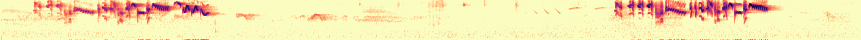

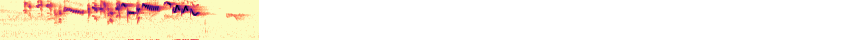

XC408286  HOWR/parkmanii  71.2s  A  song  United States/California/Mono County/Mono Lake County Park  2015-05-20  Frank Lambert[by-nc-nd]


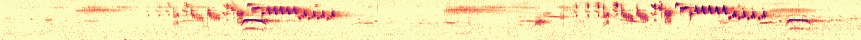

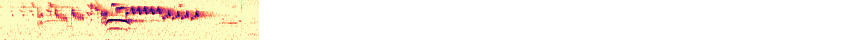

XC351150  HOWR/parkmanii  220.8s  A  song  United States/San Diego County/SDNWR/Sweetwater River  2001-05-13  Richard E. Webster[by-nc-sa]


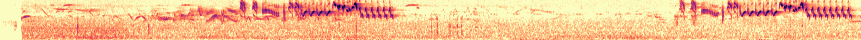

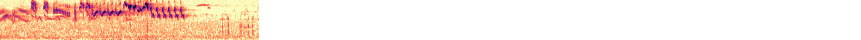

XC370248  HOWR  68.5s  A  song  United States/Kansas/Barton County/Cheyenne Bottoms Campsite  2017-05-11  Eric DeFonso[by-nc-sa]


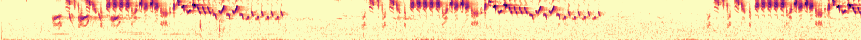

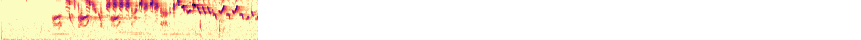

XC166911  HOWR/beani  34.0s  A  song  Mexico/Quintana Roo/San Miguel  2014-02-06  Ian Davies[by-nc-sa]


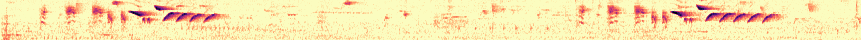

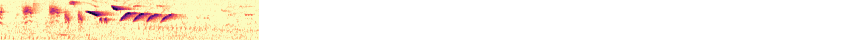

XC395416  HOWR  87.3s  A  song  United States/Colorado/Moffat County/north of Craig/CR27  2017-06-04  Nick Komar[by-nc-sa]


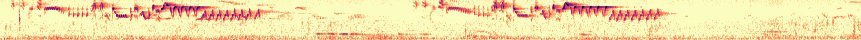

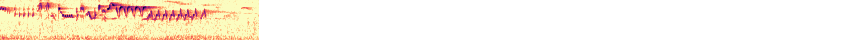

XC352227  HOWR/brunneicollis  5.1s  A  song  Mexico/Sinaloa/Reserva de la Chara Pinta (Tufted Jay Preserve)  2015-04-14  Frank Lambert[by-nc-nd]


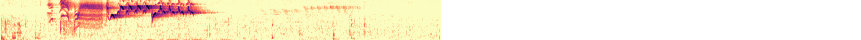

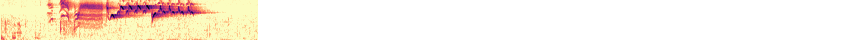

XC72429  HOWR/parkmanii  77.5s  A  song  Mexico/Baja California/Sierra San Pedro Martir/La Corona Arriba  2001-06-15  Richard E Webster[by-nc-nd]


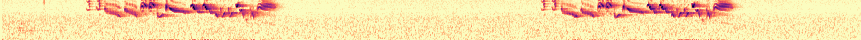

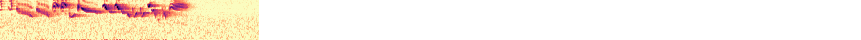

XC35374  HOWR/brunneicollis?  163.2s  A  song  United States/Arizona/Santa Cruz Co./Madera Canyon  2009-06-03  Andrew Spencer[by-nc-nd]


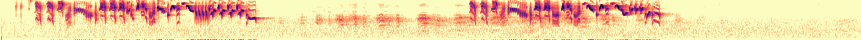

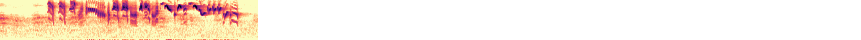

XC264026  HOWR  18.1s  A  song  United States/Illinois/Will County/Midewin National Tallgrass Prairie-Explosives Rd.   2015-07-26  Bates Estabrooks[by-nc-sa]


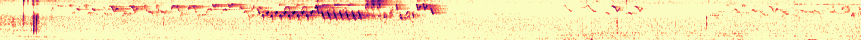

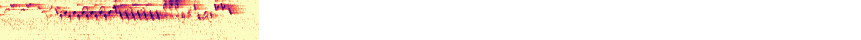

XC72427  HOWR/parkmanii  49.2s  A  scolds  Mexico/Baja California/Sierra San Pedro Martir/Observatorio area  2001-06-15  Richard E Webster[by-nc-nd]


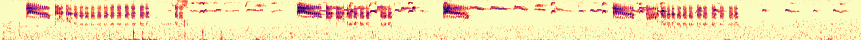

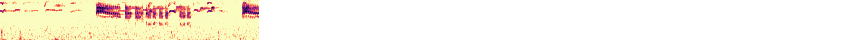

XC324097  HOWR  168.0s  A  song  United States/Arizona/Graham County/Pinalenos/Arcadia Campground  2015-06-03  Richard E. Webster[by-nc-sa]


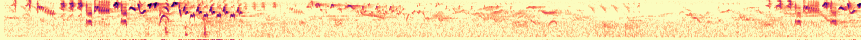

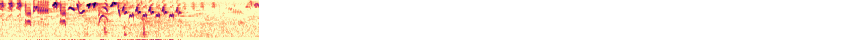

XC364389  HOWR  94.7s  A  call  United States/New Jersey/Union County/New Jersey (near  Linden)  2017-04-14  William Whitehead[by-nc-sa]


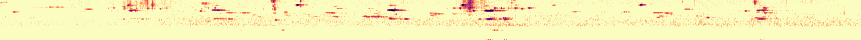

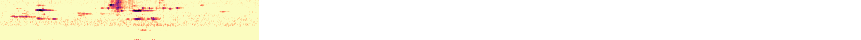

XC101247  HOWR  13.1s  A  female song  United States/Colorado/Larimer County/Land O' Peaks Ranch  2008-05-22  Nathan Pieplow[by-nc-nd]


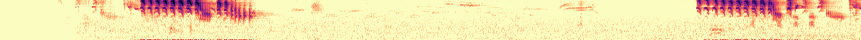

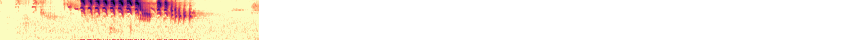

XC72442  HOWR/parkmanii  53.1s  A  call, song  Mexico/Baja California/Sierra San Pedro Martir/La Corona Arriba  2006-05-10  Richard E Webster[by-nc-nd]


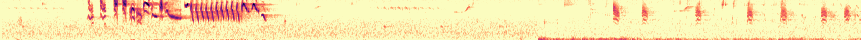

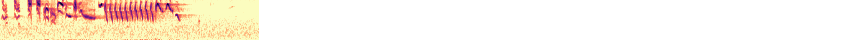

XC169194  HOWR  33.6s  A  call  United States/Florida/Orange County/Tosohatchee Wildlife Management Area  2014-03-04  Paul Marvin[by-nc-sa]


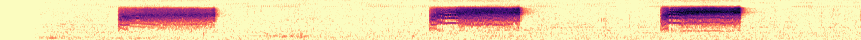

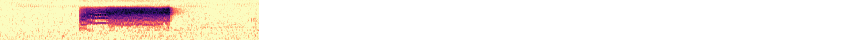

XC324081  HOWR/cahooni  145.6s  A  song  United States/Arizona/Cochise County/Chiricahua Mountains/Middle Fork/Cave Creek Canyon  2015-06-11  Richard E. Webster[by-nc-sa]


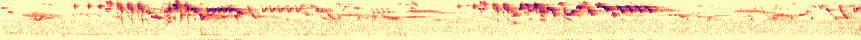

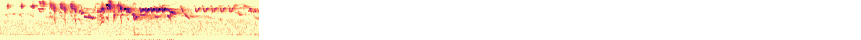

XC5917  HOWR/beani  34.1s  A  song  Mexico/Cozumel Island  2000-11-30  Richard C. Hoyer[by-nc-nd]


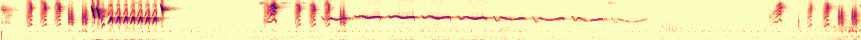

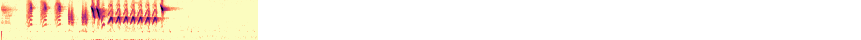

XC352451  HOWR/cahooni?  24.8s  A  call  Mexico/Sinaloa/Durango Highway KM 211  2015-04-12  Frank Lambert[by-nc-nd]


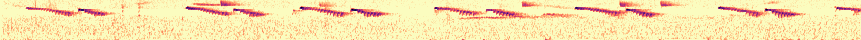

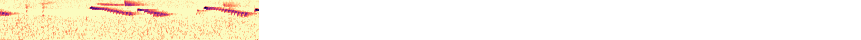

XC352452  HOWR/cahooni?  34.2s  A  song  Mexico/Sinaloa/Durango Highway KM 211  2015-04-12  Frank Lambert[by-nc-nd]


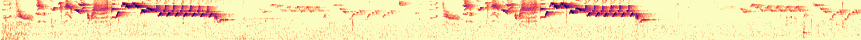

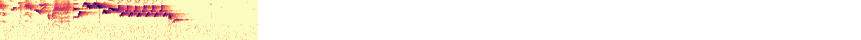

XC184983  HOWR/parkmanii  30.7s  A  song  United States/CO/Pawnee Grasslands/Crow Valley Campground  2014-06-04  Richard E. Webster[by-nc-sa]


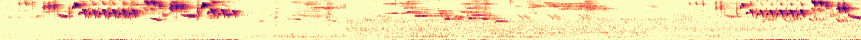

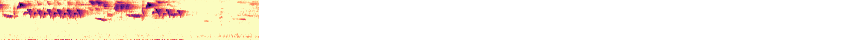

XC71075  HOWR  10.7s  A  call  United States/PA/Elkins Park  2008-04-26  Paul Driver[by-nc-nd]


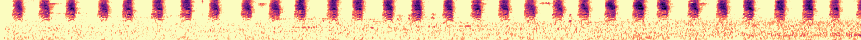

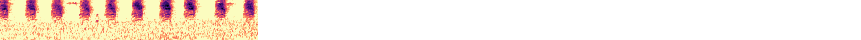

XC321496  HOWR  19.6s  A  call  United States/California/San Diego County/Santee  2016-06-13  Joshua Jaeger[by-nc-sa]


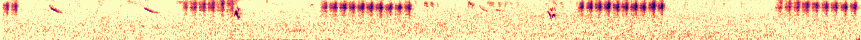

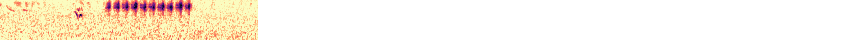

XC72426  HOWR/parkmanii  67.4s  A  call  Mexico/Baja California/Sierra San Pedro Martir/Meling Ranch  2010-09-23  Richard E Webster[by-nc-nd]


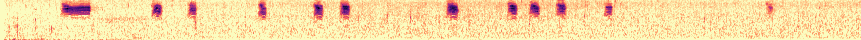

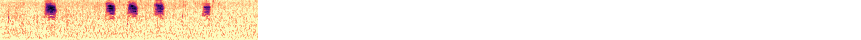

XC33851  HOWR/parkmanii  17.3s  A  Song  United States/WA/west of Thorp  2009-02-05  Tayler Brooks[by-nc-nd]


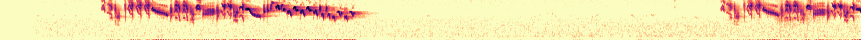

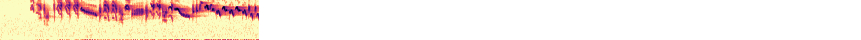

XC181327  HOWR  48.0s  A  song  United States/Arizona/Maricopa County/Slate Creek Divide/Arizona Scenic National Trailhead Parking  2014-06-07  Tim Marquardt[by-nc-sa]


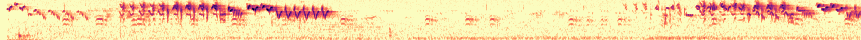

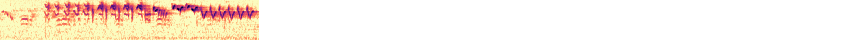

XC356238  HOWR  65.0s  A  alarm call  United States/Georgia/Chatham County/Georgia (near  Bloomingdale)  2017-02-19  Russ Wigh[by-nc-sa]


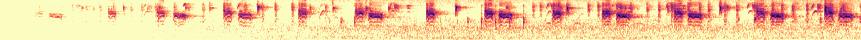

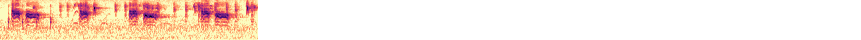

XC105827  HOWR  10.7s  A  Song  United States/Pueblo Mountain Park--up the road from the old Mountain Park Environmental Center office  2006-05-31  Paul J Hurtado[by-nc-nd]


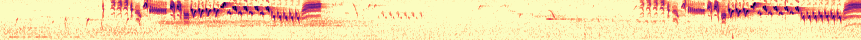

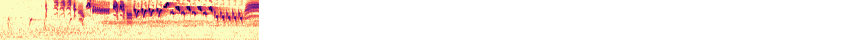

XC101308  HOWR/aedon  45.5s  A  song  United States/Tennessee/Knoxville/Sharp's Ridge Memorial Park  2012-05-13  Mike Nelson[by-nc-nd]


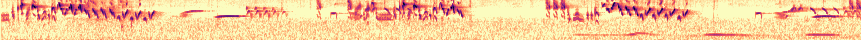

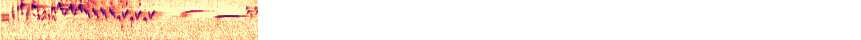

XC177010  HOWR  3.3s  A  song  United States/Colorado/Boulder/Lafayette  2014-05-03  Ted Floyd[by-nc-sa]


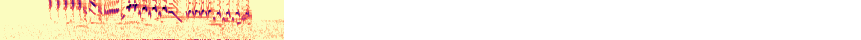

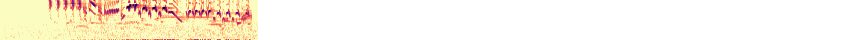

XC320030  HOWR  17.5s  A  song  United States/Colorado/Larimer County/Estes Park  2016-05-30  Sue Riffe[by-nc-sa]


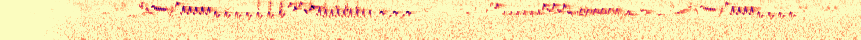

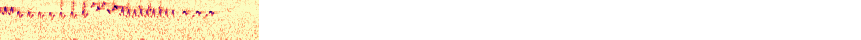

In [ ]:
for rec in df_rows(xc_recs
    .query("species == 'HOWR'")
    .query("quality == 'A'")
    .pipe(tap, lambda df: print(len(df)))
    .sample(random_state=0,
        n=100,
    )
):
    print(xc_rec_str_line(rec))
    plot_spectro_micro(rec, features,
        # audio=True,
    )
    plot_thumb_micro(rec, features,
        thumb_s=3,
        # audio=True,
        # verbose=True,
    )
    plt.show()

168
XC217819  BEWR  42.2s  A  song  United States/Arizona/Santa Cruz county/Patagonia - Sonoita Creek Preserve  2012-03-28  Paul Marvin[by-nc-sa]


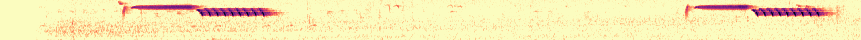

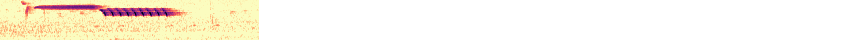

XC230957  BEWR  21.2s  A  call  United States/AZ/Patagonia Lake State Park  2007-02-17  Peter Boesman[by-nc-nd]


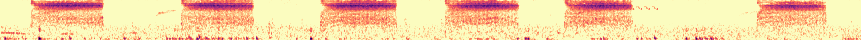

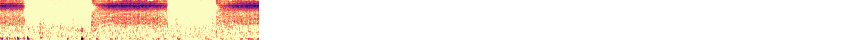

XC370889  BEWR  40.6s  A  song  United States/NM. North seasonal rd/Socorro county/Bosque del Apache NWR  2017-05-07  Russ Wigh[by-nc-sa]


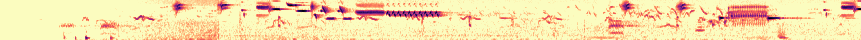

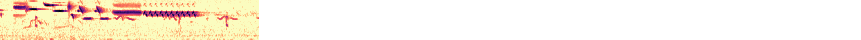

XC351038  BEWR/charienturus  213.7s  A  song  United States/California/San Bernardino/San Bernardino Mountains/Arrastre Creek at 3N03  2000-07-09  Richard E. Webster[by-nc-sa]


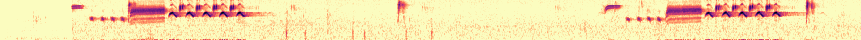

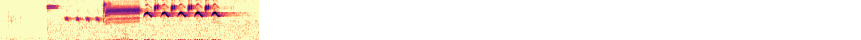

XC324448  BEWR/murinus  29.7s  A  song  Mexico/Ciudad de México/La grande Palapa Milpa Alta (near  Ciudad de México)  2016-06-26  Manuel Grosselet[by-nc-sa]


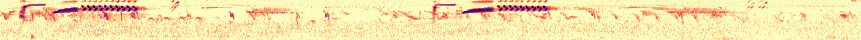

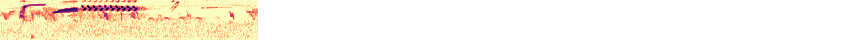

XC217833  BEWR  55.8s  A  call, song  United States/California/San Diego Co/Kitchen Creek Rd (north section) Cleveland National Forest  2011-06-10  Paul Marvin[by-nc-sa]


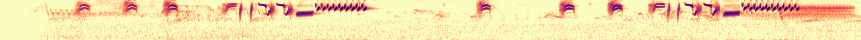

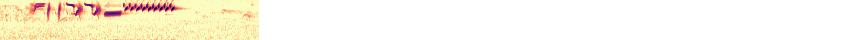

XC323974  BEWR/eremophilus  51.3s  A  song  United States/Arizona/Portal  2015-05-01  Richard E. Webster[by-nc-sa]


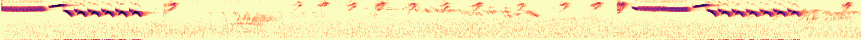

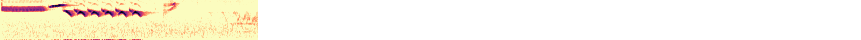

XC15270  BEWR  43.0s  A  call, song  United States/Colorado/Moffat County  2007-06-05  Andrew Spencer[by-nc-nd]


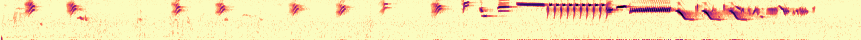

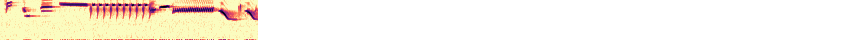

XC217913  BEWR  153.2s  A  call, song  United States/Texas/Kickapoo Cavern State Park  2012-04-08  Paul Marvin[by-nc-sa]


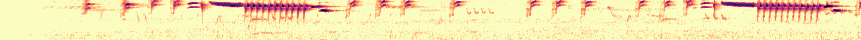

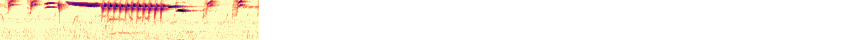

XC279007  BEWR  13.5s  A  song  United States/Arizona/Cochise County/Ramsey Canyon Preserve Overlook  2015-09-06  Nick Komar[by-nc-sa]


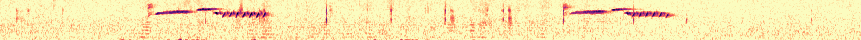

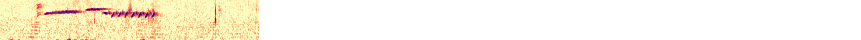

XC243688  BEWR  140.9s  A  call, song  United States/California/Solano County/Gates Canyon  2015-04-10  Ryan P. O'Donnell[by-nc-sa]


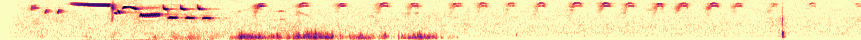

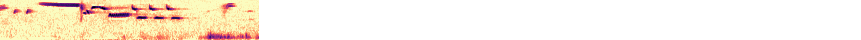

XC351083  BEWR/eremophilus  90.6s  A  song  United States/California/Inyo/White Mountains/Westgard Pass  1995-06-02  Richard E. Webster[by-nc-sa]


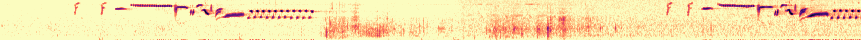

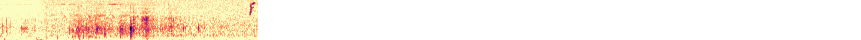

XC217851  BEWR  152.1s  A  song  United States/Texas/Brewster Co./Big Bend National Park/Laguna Meadows Trail  2012-04-07  Paul Marvin[by-nc-sa]


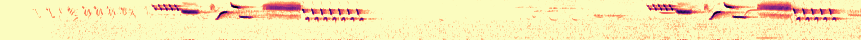

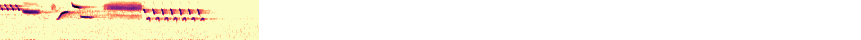

XC217834  BEWR  129.1s  A  song  United States/California/San Diego Co/Kitchen Creek Rd (north section) Cleveland National Forest  2013-04-05  Paul Marvin[by-nc-sa]


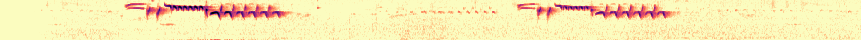

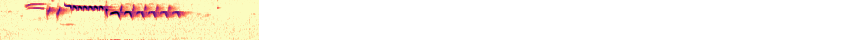

XC368451  BEWR  245.4s  A  song  United States/Texas/Hidalgo/Edinburg  2017-04-26  Dan Lane[by-nc-sa]


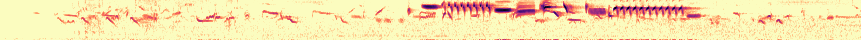

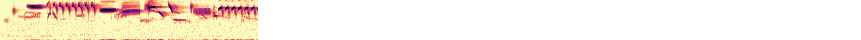

XC41230  BEWR/eremophilus  19.4s  A  Call  United States/AZ/Pima County/Coronado NF/Molino Basin Campground  2009-08-11  Scott Olmstead[by-nc-nd]


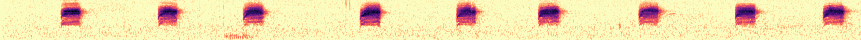

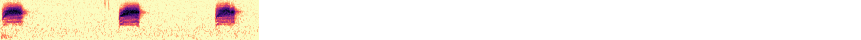

XC61471  BEWR/calophonus  85.0s  A  Song, various calls  United States/WA/Brier  2010-08-15  Tayler Brooks[by-nc-nd]


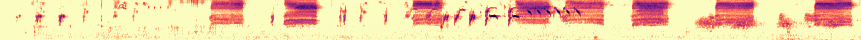

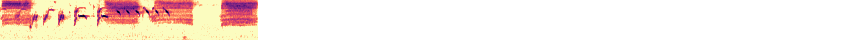

XC217853  BEWR  165.0s  A  song  United States/Texas/Brewster Co./Big Bend National Park/Laguna Meadows Trail  2012-04-07  Paul Marvin[by-nc-sa]


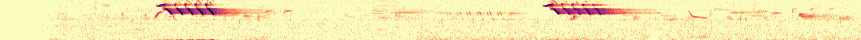

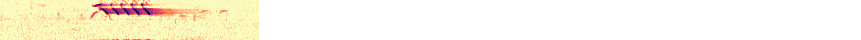

XC160213  BEWR  14.4s  A  song  Canada/BC/Vancouver Island/Sooke/Broom Hill  2013-04-25  Ian Cruickshank[by-nc-nd]


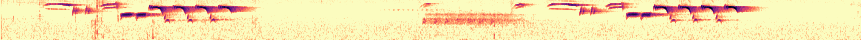

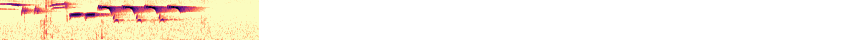

XC173153  BEWR  63.8s  A  song  United States/Arizona/Cochise County/Upper Cave Creek Canyon/FR 42  2014-01-01  Eric DeFonso[by-nc-sa]


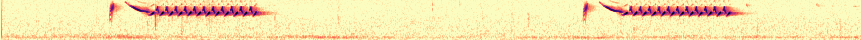

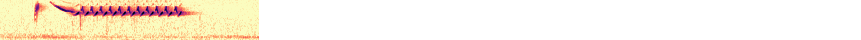

XC289165  BEWR  13.0s  A  male, song  United States/Arizona/La Paz County/Bill Williams River National Wildlife Refuge/Borrow Pit  2015-07-29  Eric Hough[by-nc-sa]


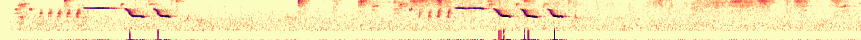

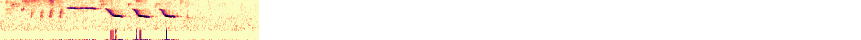

XC411047  BEWR/calophonus  83.1s  A  call, song  Canada/British Columbia/Capital/Esquimalt (near  Victoria)  2018-03-19  Barry Edmonston[by-nc-sa]


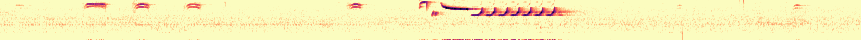

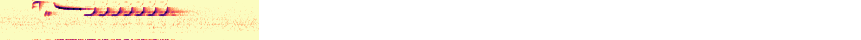

XC217912  BEWR  177.0s  A  call  United States/Texas/Guadalupe Mountains National Park  2011-06-16  Paul Marvin[by-nc-sa]


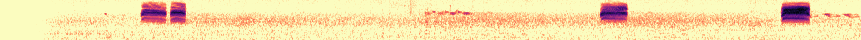

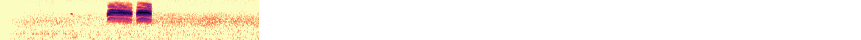

XC351087  BEWR/charienturus  22.8s  A  call  United States/California/Kern County/Butterbredt Canyon  1997-03-20  Richard E. Webster[by-nc-sa]


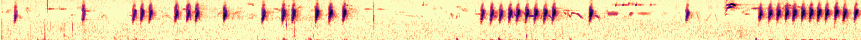

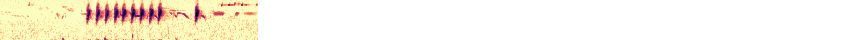

XC371800  BEWR  142.6s  A  song  Mexico/Nuevo León/General Bravo  2017-05-15  Manuel Grosselet[by-nc-sa]


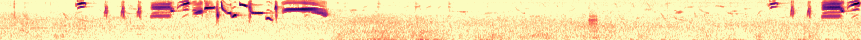

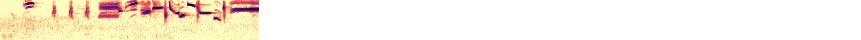

XC34804  BEWR  25.5s  A  call  United States/Texas/Brewster Co./Big Bend National Park/Boot Springs Trail  2009-05-18  Andrew Spencer[by-nc-nd]


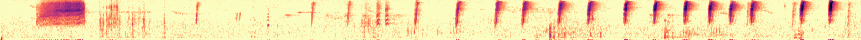

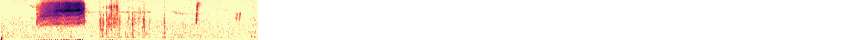

XC230952  BEWR  13.4s  A  song  Mexico/Oaxaca/Teotitlan  2001-03-12  Peter Boesman[by-nc-nd]


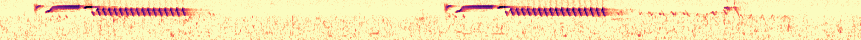

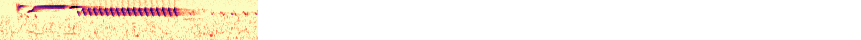

XC274880  BEWR/murinus  22.7s  A  song  Mexico/Teotitlan de Valle /Oaxaca  2015-03-30  Frank Lambert[by-nc-nd]


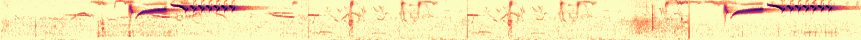

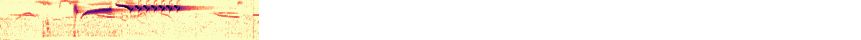

XC159934  BEWR  50.0s  A  call  Canada/BC/Vancouver Island/Victoria/Swan Lake  2013-02-17  Ian Cruickshank[by-nc-nd]


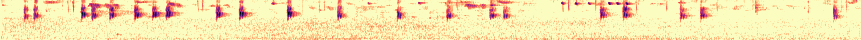

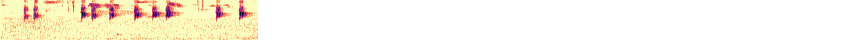

XC173154  BEWR  56.1s  A  song  United States/Arizona/Cochise County/Upper Cave Creek Canyon/FR 42  2014-01-01  Eric DeFonso[by-nc-sa]


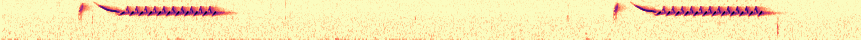

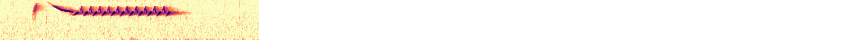

XC217911  BEWR  208.9s  A  call, song  United States/Texas/Jeff Davis Co/Davis Mountains State Park  2012-04-05  Paul Marvin[by-nc-sa]


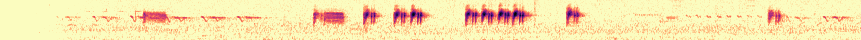

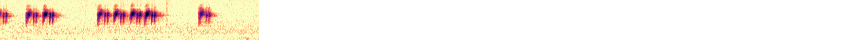

XC109668  BEWR  32.6s  A  song  United States/California/Santa Clara/McClellan Ranch Preserve  2012-09-05  Jonathon Jongsma[by-sa]


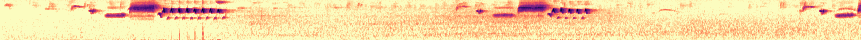

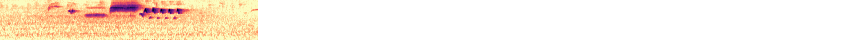

XC230954  BEWR  19.1s  A  song  Mexico/Oaxaca/Teotitlan  2001-03-12  Peter Boesman[by-nc-nd]


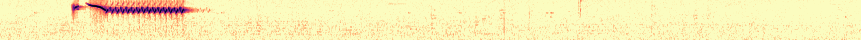

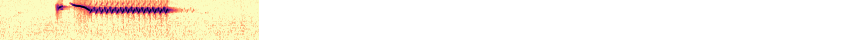

XC382222  BEWR  32.1s  A  song  Mexico/Lomas de Bezares Miguel Hidalgo Mexico city  2017-08-06  Manuel Grosselet[by-nc-sa]


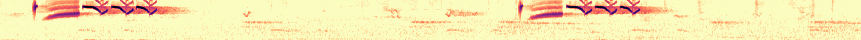

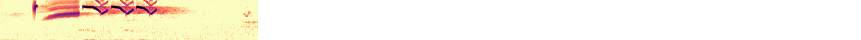

XC22069  BEWR  34.9s  A  song  United States/Arizona/Chiricahua NM/Bonita Canyon  2008-07-10  Chris Parrish[by-nc-nd]


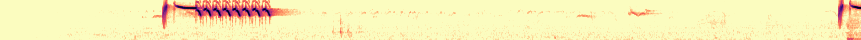

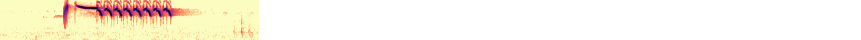

XC73785  BEWR/eremophilus  25.5s  A  Call  United States/Utah/Washington County/Snow Canyon State Park  2011-03-19  Ryan P. O'Donnell[by-nc-nd]


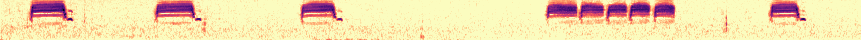

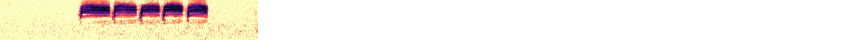

XC351179  BEWR  152.9s  A  song  United States/California/San Benito/Pinnacles National Park  2010-08-08  Richard E. Webster[by-nc-sa]


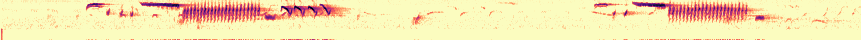

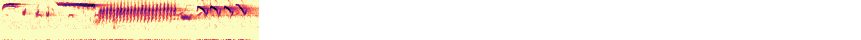

XC168584  BEWR  26.2s  A  song  Mexico/Pequeña colina /San agustin Etla  2014-03-03  Manuel Grosselet[by-nc-sa]


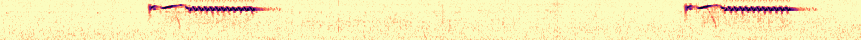

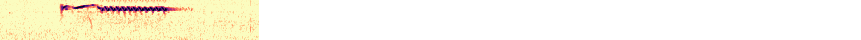

XC12577  BEWR  53.5s  A  song  United States/Colorado/Montezuma County/Hovenweep Canyon  2007-04-14  Andrew Spencer[by-nc-nd]


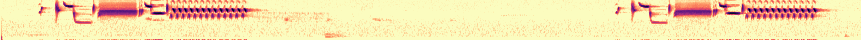

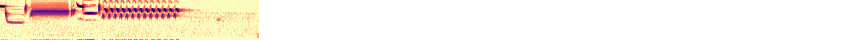

XC159376  BEWR  70.2s  A  call  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-08-26  Ian Cruickshank[by-nc-nd]


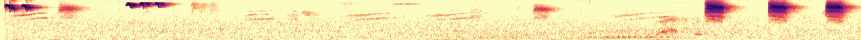

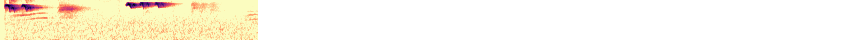

XC159932  BEWR  110.0s  A  call  Canada/BC/Vancouver Island/Victoria/Swan Lake  2013-02-17  Ian Cruickshank[by-nc-nd]


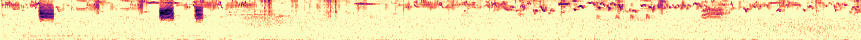

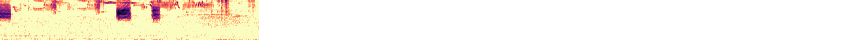

XC404574  BEWR  37.9s  A  song  United States/Tim Ward Ranch/Texas: Kinney County; 5.3 km SE of Brackettville  2015-05-02  Jacob R. Saucier[by-nc-sa]


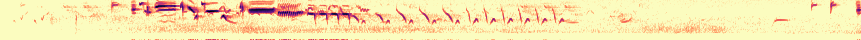

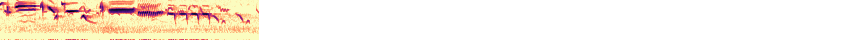

XC171092  BEWR  33.8s  A  song  Mexico/Morelia/Universidad Michoacana university campus  2012-04-14  Elvis Herrera Rodríguez[by-nc-sa]


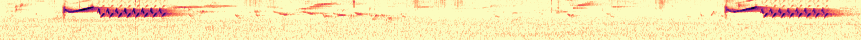

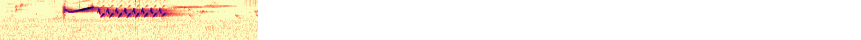

XC198175  BEWR  27.5s  A  call, song  Mexico/Parque Estatal Cerro Punhuato  2012-05-26  Elvis Herrera Rodríguez[by-nc-sa]


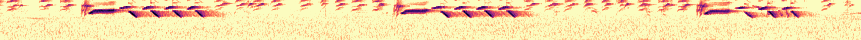

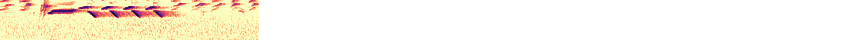

XC159068  BEWR  4.5s  A  call  Canada/BC/Vancouver Island/Metchosin/Pedder Bay  2012-07-25  Ian Cruickshank[by-nc-nd]


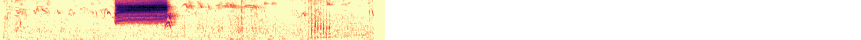

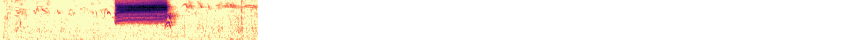

XC351049  BEWR/charienturus  40.7s  A  song  United States/San Diego County/San Diego River/Old Mission Dam  1997-03-17  Richard E. Webster[by-nc-sa]


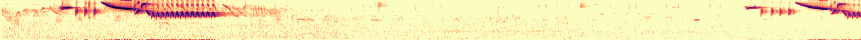

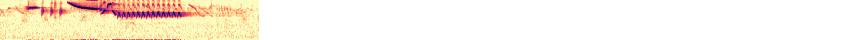

XC325229  BEWR  11.0s  A  male, song  Canada/British Columbia/Saanichton  2016-03-27  James Bradley[by-nc-sa]


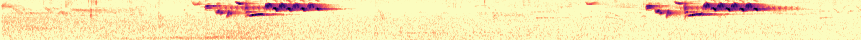

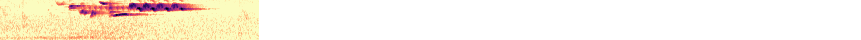

XC178015  BEWR  98.4s  A  call, song  United States/California/Nipomo/Oso Flaco Lake  2014-05-04  Thomas G. Graves[by-nc-sa]


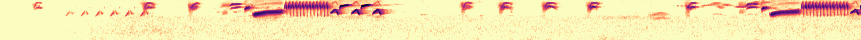

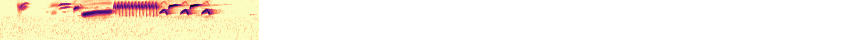

XC152456  BEWR  47.3s  A  song  Mexico/Distrito Federal/Reserva ecológica del Pedregal de San Angel  2013-10-15  Alejandro Gama[by-nc-sa]


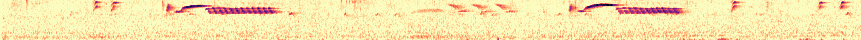

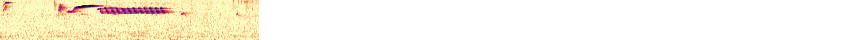

XC34805  BEWR  32.6s  A  call  United States/Texas/Brewster Co./Big Bend National Park/Boot Springs Trail  2009-05-18  Andrew Spencer[by-nc-nd]


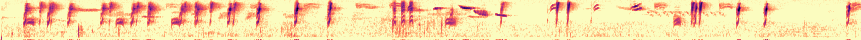

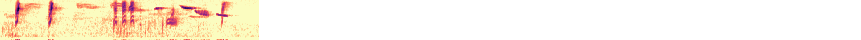

XC217843  BEWR  65.6s  A  call, song  United States/California/San Diego Co/Cleveland National Forest/N of Buckman Springs Rd/Sheephead Mt Rd by I-8 rest area  2013-04-12  Paul Marvin[by-nc-sa]


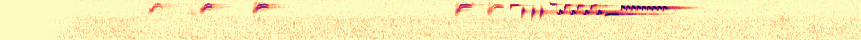

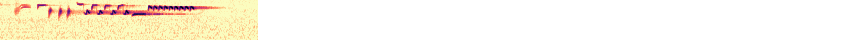

XC18046  BEWR  59.1s  A  call  United States/Arizona/Pima Co./Catalina State Park  2008-02-23  Andrew Spencer[by-nc-nd]


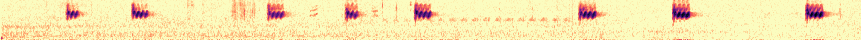

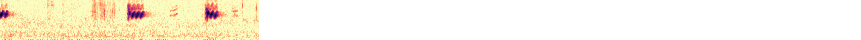

XC160194  BEWR  12.0s  A  song  Canada/BC/Vancouver Island/Victoria/University of Victoria  2013-04-22  Ian Cruickshank[by-nc-nd]


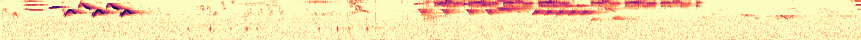

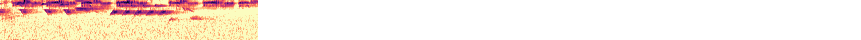

XC351065  BEWR/eremophilus  90.7s  A  song  United States/Inyo County/Haiwee Creek  2000-06-15  Richard E. Webster[by-nc-sa]


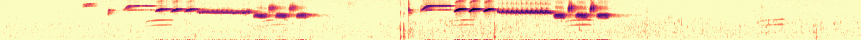

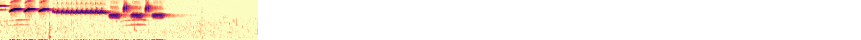

XC205433  BEWR  41.7s  A  song  United States/Colorado/Montrose County/Plateau S of Paradox Valley  2014-05-21  Eric DeFonso[by-nc-sa]


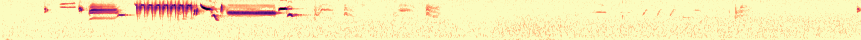

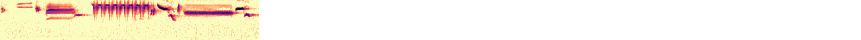

XC408543  BEWR/charienturus?  31.6s  A  song  United States/California/Kern County/Maricopa/Petroleum Club Rd.  2015-05-05  Frank Lambert[by-nc-nd]


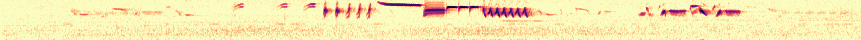

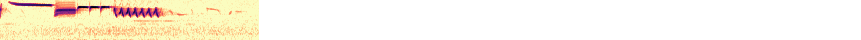

XC35893  BEWR  14.1s  A  Song  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


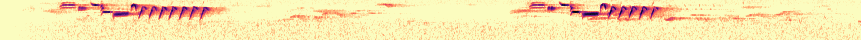

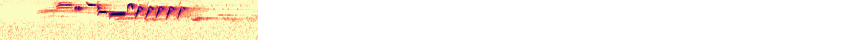

XC159811  BEWR  62.0s  A  call  Canada/BC/Vancouver Island/Victoria/Mt Douglas  2012-11-20  Ian Cruickshank[by-nc-nd]


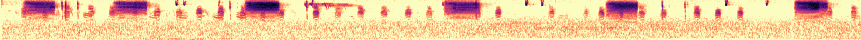

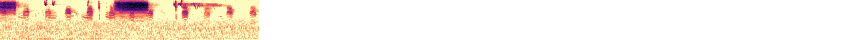

XC404736  BEWR  42.3s  A  call, song  United States/Miguel Canyon/Texas: Kinney County; 26.1 km NE Brackettville  2015-05-07  Jacob R. Saucier[by-nc-sa]


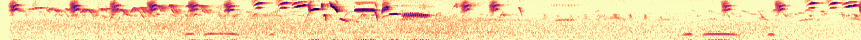

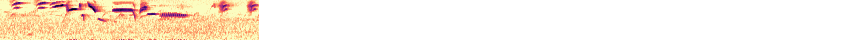

XC217839  BEWR  52.9s  A  call, song  United States/California/Cleveland National Forest. San Diego Co/Pine Creek Rd off Sunrise Hwy  2012-03-15  Paul Marvin[by-nc-sa]


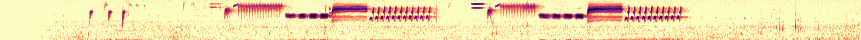

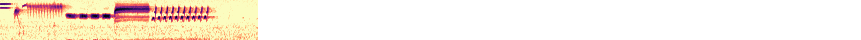

XC217854  BEWR  37.3s  A  call, song  United States/Texas/Brewster Co./Big Bend National Park/Laguna Meadows Trail  2011-06-18  Paul Marvin[by-nc-sa]


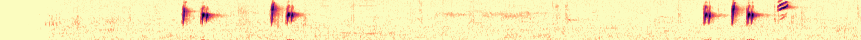

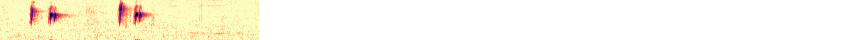

XC230951  BEWR  15.5s  A  call  Mexico/Oaxaca/Teotitlan  2001-03-20  Peter Boesman[by-nc-nd]


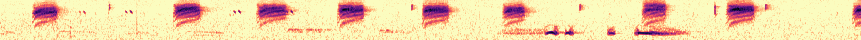

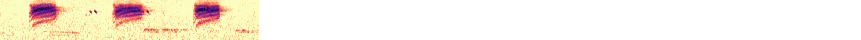

XC390104  BEWR  75.1s  A  song  United States/California/Montana de Oro State Park  2017-09-10  Guy Kirwan[by-nc-sa]


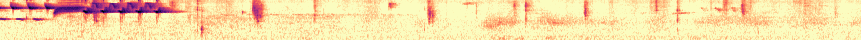

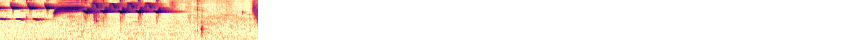

XC217847  BEWR  40.3s  A  song  United States/California/San Diego/Tijuana River Valley/Monument Rd  2012-03-03  Paul Marvin[by-nc-sa]


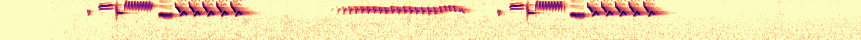

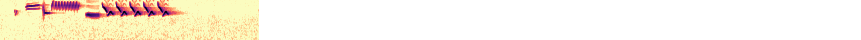

XC171095  BEWR  9.0s  A  alarm call  Mexico/Morelia/Universidad Michoacana university campus  2012-07-21  Elvis Herrera Rodríguez[by-nc-sa]


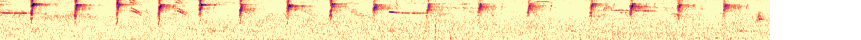

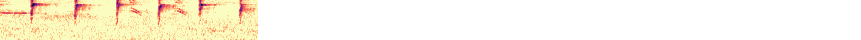

XC173148  BEWR  56.9s  A  song  United States/Arizona/Cochise County/Upper Cave Creek Canyon/FR 42  2014-01-01  Eric DeFonso[by-nc-sa]


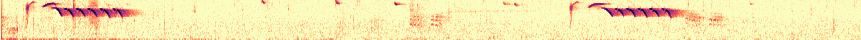

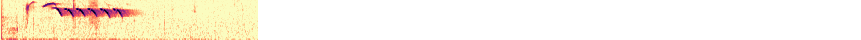

XC216178  BEWR  42.7s  A  song  Canada/British Columbia/Greater Vancouver/Delta/Alaksen Wildlife Refuge  2015-03-07  David Bradley[by-nc-sa]


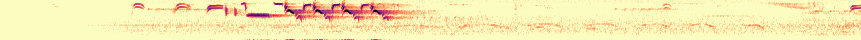

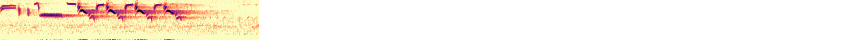

XC351086  BEWR/charienturus  74.5s  A  call  United States/California/San Bernardino Mountains/Arrastre Creek at 2N02  1998-07-29  Richard E. Webster[by-nc-sa]


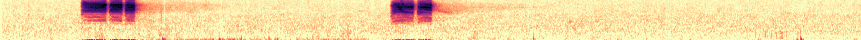

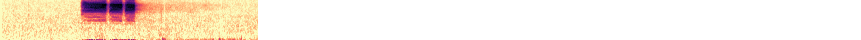

XC217824  BEWR  183.3s  A  call, song  United States/California/San Diego County/Jamul/Hollenbeck Canyon Trail  2012-03-07  Paul Marvin[by-nc-sa]


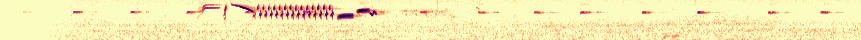

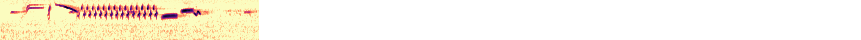

XC408558  BEWR/charienturus?  32.2s  A  song  United States/California/Riverside County/Thermal/66th Ave/Tyler Street  2015-05-13  Frank Lambert[by-nc-nd]


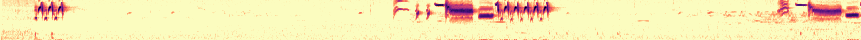

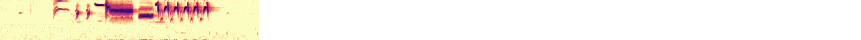

XC408453  BEWR  21.4s  A  call  United States/CA/Santa Cruz Island/Scorpion Canyon  2015-05-04  Frank Lambert[by-nc-nd]


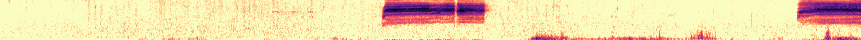

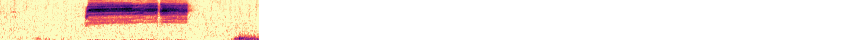

XC371801  BEWR  24.6s  A  song  Mexico/Nuevo León/General Bravo  2017-05-15  Manuel Grosselet[by-nc-sa]


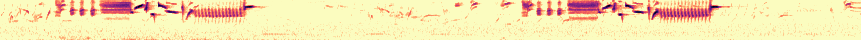

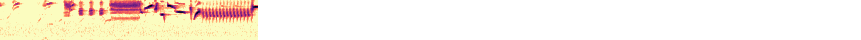

XC160250  BEWR  21.3s  A  song  Canada/BC/Vancouver Island/Victoria/Christmas Hill  2013-04-30  Ian Cruickshank[by-nc-nd]


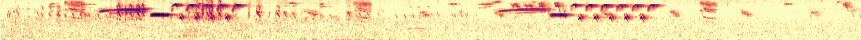

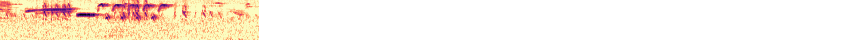

XC307445  BEWR  13.8s  A  song  Mexico/La cantera Oriental REPSA CU Mexico DF  2016-03-16  Manuel Grosselet[by-nc-sa]


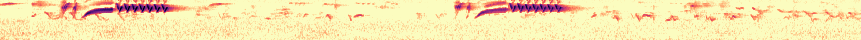

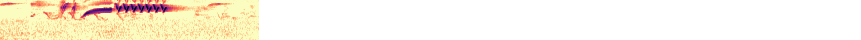

XC323978  BEWR/eremophilus  51.4s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2015-05-10  Richard E. Webster[by-nc-sa]


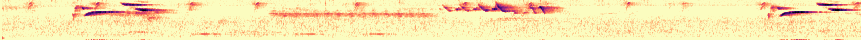

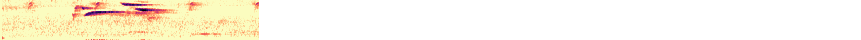

XC351182  BEWR  241.0s  A  call, song  United States/California/San Benito/Pinnacles National Park  2010-08-08  Richard E. Webster[by-nc-sa]


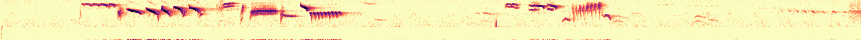

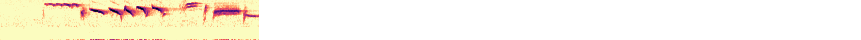

XC34806  BEWR  59.1s  A  call  United States/Texas/Brewster Co./Big Bend National Park/Boot Springs Trail  2009-05-18  Andrew Spencer[by-nc-nd]


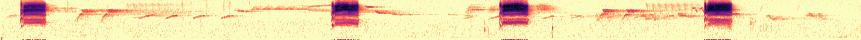

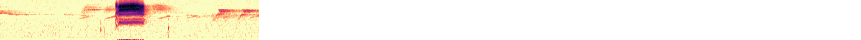

XC325137  BEWR  59.7s  A  call, song  United States/Colorado/Las Animas County/Cone Mtn BBS  2016-06-11  Sue Riffe[by-nc-sa]


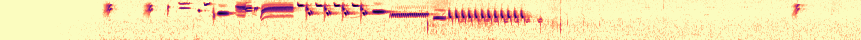

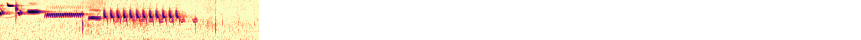

XC230953  BEWR  22.6s  A  song  Mexico/Oaxaca/Teotitlan  2001-03-12  Peter Boesman[by-nc-nd]


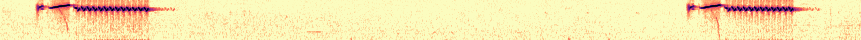

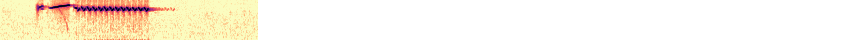

XC104638  BEWR/eremophilus  33.0s  A  call  United States/Colorado/Moffat Co./at the Little Snake River/Cherokee Creek  2012-05-12  Andrew Spencer[by-nc-nd]


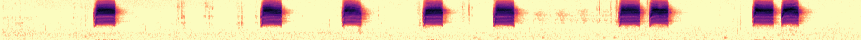

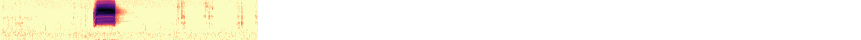

XC269166  BEWR/calophonus  34.5s  A  song  United States/Washington/King County/Seattle  2015-06-20  Frank Lambert[by-nc-nd]


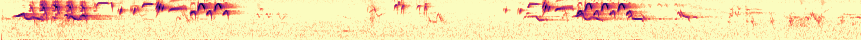

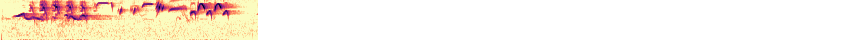

XC383784  BEWR/mexicanus  13.4s  A  call, song  Mexico/Lomas de Bezares Miguel Hidalgo Mexico city  2017-08-20  Manuel Grosselet[by-nc-sa]


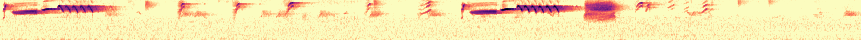

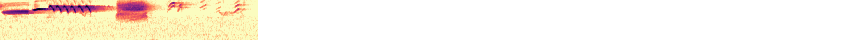

XC333643  BEWR  56.3s  A  cars, city, people, song  Mexico/Ciudad de México/Tlalpan (near  Ciudad de México)  2016-09-08  Esau Toaki Villarreal [by-nc-sa]


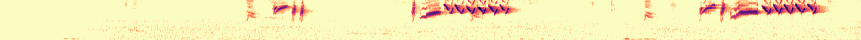

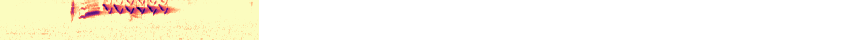

XC217823  BEWR  9.2s  A  call  United States/Yaqui Wells. California  2012-03-15  Paul Marvin[by-nc-sa]


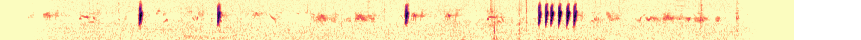

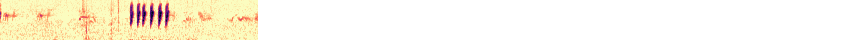

XC217858  BEWR  21.2s  A  song  United States/Texas/Brewster Co./Big Bend National Park/Laguna Meadows Trail  2011-06-22  Paul Marvin[by-nc-sa]


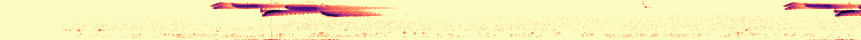

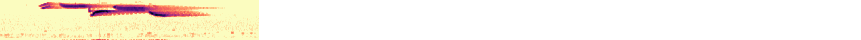

XC178322  BEWR  33.1s  A  song  United States/Arizona/Maricopa County/Slate Creek Divide  2014-05-15  Tim Marquardt[by-nc-sa]


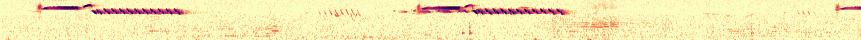

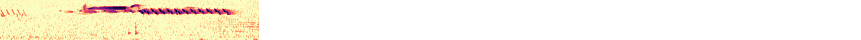

XC212943  BEWR  31.9s  A  song  United States/California/Sacramento County/Bike Trail Folsom  2015-02-11  Jim Holmes[by-nc-sa]


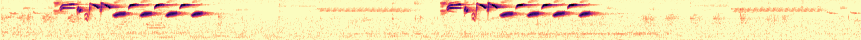

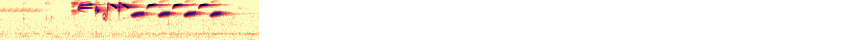

XC351082  BEWR  61.0s  A  song  United States/California/Kern/Walker Pass  1995-06-23  Richard E. Webster[by-nc-sa]


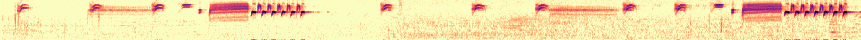

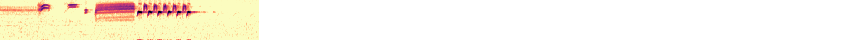

XC109397  BEWR  38.4s  A  call, song  United States/Texas/Brewster Co./Big Bend National Park/Chisos Basin  2011-06-18  Paul Marvin[by-nc-nd]


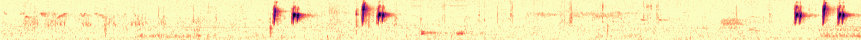

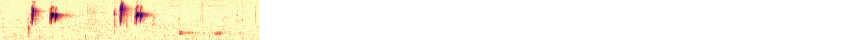

XC61472  BEWR/calophonus  39.4s  A  Song  United States/WA/Brier  2010-08-15  Tayler Brooks[by-nc-nd]


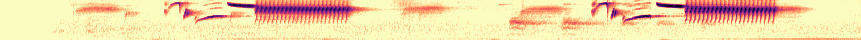

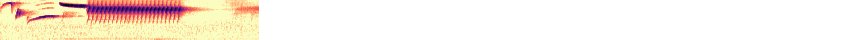

XC351093  BEWR/charienturus  128.2s  A  call, song  United States/California/San Diego/Lake Hodges  1995-04-09  Richard E. Webster[by-nc-sa]


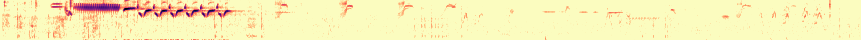

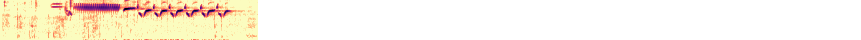

XC351081  BEWR  41.8s  A  song  United States/California/Kern/Walker Pass  1995-06-23  Richard E. Webster[by-nc-sa]


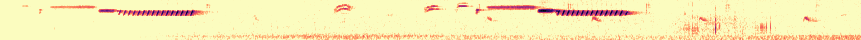

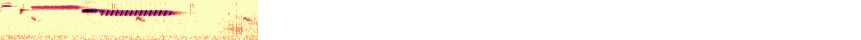

XC230958  BEWR  23.2s  A  song  United States/AZ/Patagonia Lake State Park  2007-02-17  Peter Boesman[by-nc-nd]


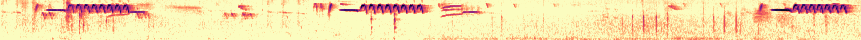

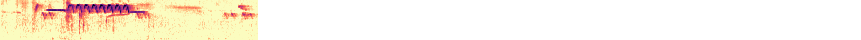

XC160282  BEWR  3.6s  A  song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2013-05-01  Ian Cruickshank[by-nc-nd]


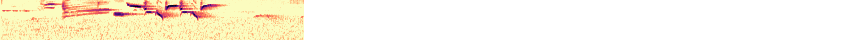

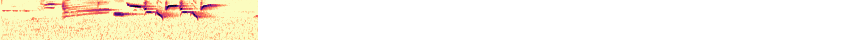

XC172751  BEWR  82.3s  A  song  United States/Colorado/Las Animas County/Cottonwood Canyon  2013-05-27  Eric DeFonso[by-nc-sa]


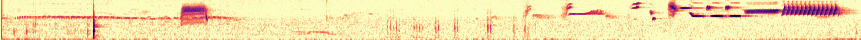

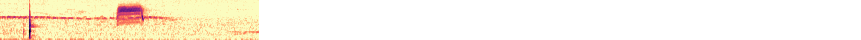

XC14172  BEWR  47.2s  A  song  United States/California/White Mountains  2007-07-04  Chris Parrish[by-nc-nd]


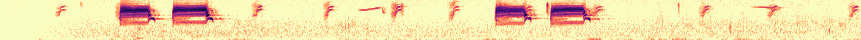

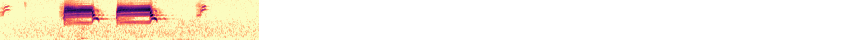

XC159987  BEWR  10.3s  A  song  Canada/BC/Vancouver Island/Central Saanich/Island View Beach  2013-03-02  Ian Cruickshank[by-nc-nd]


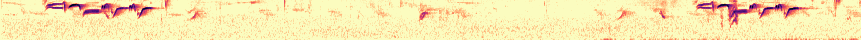

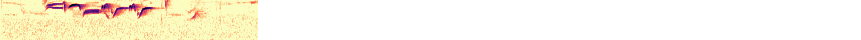

XC159988  BEWR  18.3s  A  call, song  Canada/BC/Vancouver Island/Central Saanich/Island View Beach  2013-03-02  Ian Cruickshank[by-nc-nd]


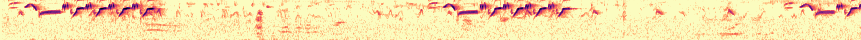

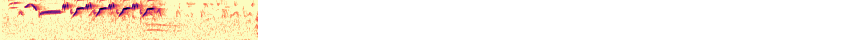

XC217841  BEWR  80.0s  A  call  United States/California/San Diego County/near Dulzura/Otay Mountain  2013-03-28  Paul Marvin[by-nc-sa]


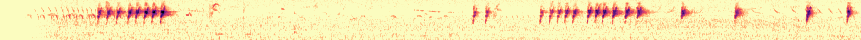

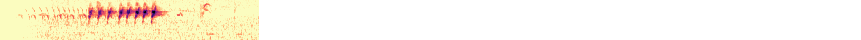

XC274878  BEWR/murinus  37.1s  A  song  Mexico/Teotitlan de Valle /Oaxaca  2015-03-29  Frank Lambert[by-nc-nd]


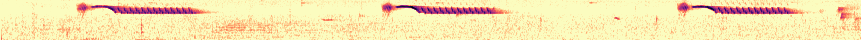

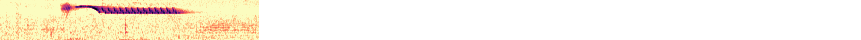

In [ ]:
for rec in df_rows(xc_recs
    .query("species == 'BEWR'")
    .query("quality == 'A'")
    .pipe(tap, lambda df: print(len(df)))
    .sample(random_state=0,
        n=100,
    )
):
    print(xc_rec_str_line(rec))
    plot_spectro_micro(rec, features,
        # audio=True,
    )
    plot_thumb_micro(rec, features,
        thumb_s=3,
        # audio=True,
        # verbose=True,
    )
    plt.show()

251
XC205810  SOSP  146.1s  A  song  United States/Colorado/Delta County/Delta/Confluence Park  2014-05-29  Eric DeFonso[by-nc-sa]


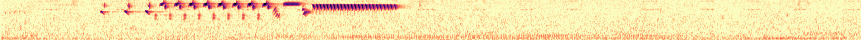

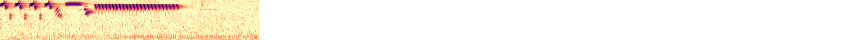

XC366598  SOSP  56.0s  A  song  United States/Kentucky/Fayette County/Jacobson Park  2015-03-14  Antonio Xeira[by-nc-sa]


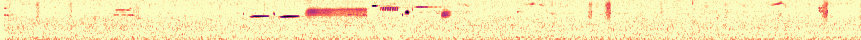

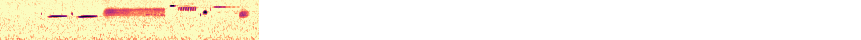

XC408811  SOSP/heermanni?  34.9s  A  calling whilst foraging, song  United States/California/Monterey County/Andrew Molera Park (near  Big Sur)  2015-05-18  Frank Lambert[by-nc-nd]


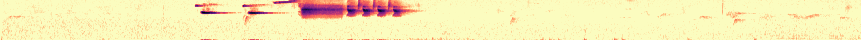

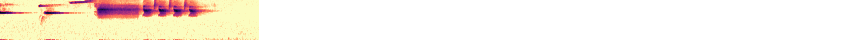

XC125723  SOSP/heermanni  47.9s  A  song  United States/California/San Bernardino Mountains/Arrastre Creek at 2N02  2006-05-05  Richard E. Webster[by-nc-sa]


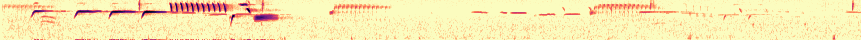

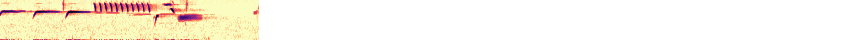

XC149412  SOSP/kenaiensis  33.1s  A  call  United States/Alaska/Kenai Peninsula/Homer Spit  2013-05-21  Andrew Spencer[by-nc-sa]


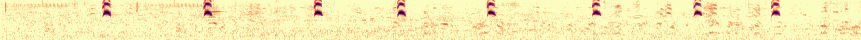

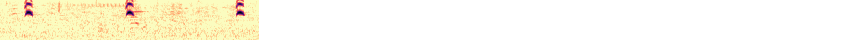

XC73498  SOSP  61.6s  A  call  Canada/British Columbia/Victoria/Blenkinsop Lake  2011-03-07  Ian Cruickshank[by-nc-nd]


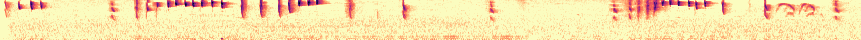

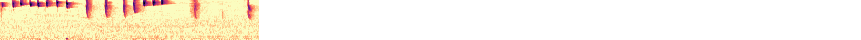

XC149408  SOSP/kenaiensis  50.4s  A  call  United States/Alaska/Kenai Peninsula/Homer Spit  2013-05-21  Andrew Spencer[by-nc-sa]


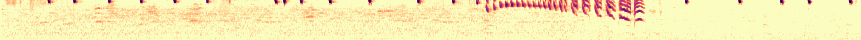

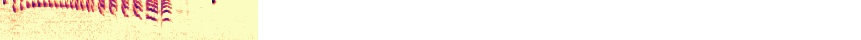

XC111642  SOSP/fallax  22.2s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-05-04  Richard E Webster[by-nc-nd]


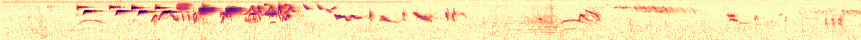

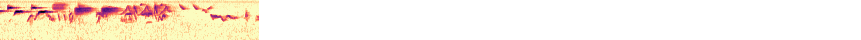

XC172442  SOSP  156.5s  A  song  United States/Colorado/Boulder County/Sawhill Ponds  2013-04-05  Eric DeFonso[by-nc-sa]


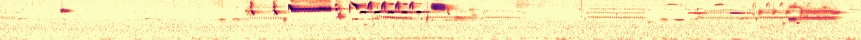

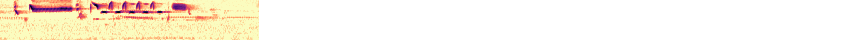

XC251961  SOSP  2.8s  A  song  United States/Washington/King County/Shoreline  2015-06-08  James McGilvray[by-nc-sa]


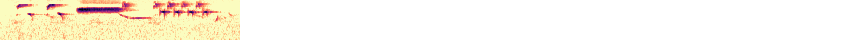

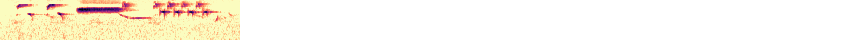

XC125704  SOSP/heermanni  29.0s  A  song  United States/CA/Weldon/Audubon Kern River Preserve  1995-06-23  Richard E. Webster[by-nc-sa]


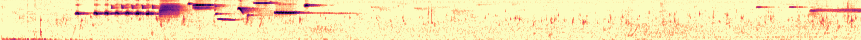

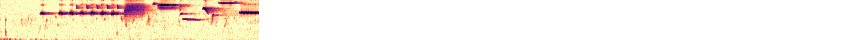

XC302550  SOSP  47.1s  A  song  Canada/British Columbia/Peace River Canyon  2012-07-21  James Bradley[by-nc-sa]


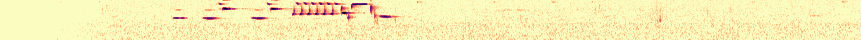

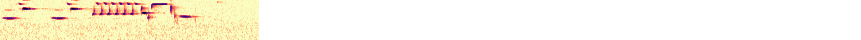

XC290138  SOSP  24.8s  A  growl/interaction call  United States/Pennsylvania/Montgomery/Lower Moreland (near  Huntingdon Valley)  2015-11-15  Paul Driver[by-nc-sa]


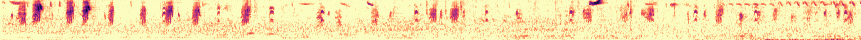

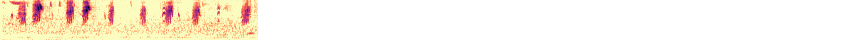

XC142620  SOSP  134.6s  A  song  United States/Michigan/Ontonagon/Porcupine Mountains SP/Union Bay Campground  2013-07-11  Jonathon Jongsma[by-sa]


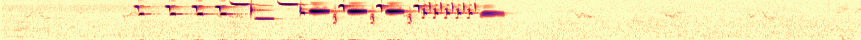

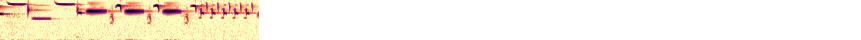

XC290096  SOSP  29.0s  A  call  United States/Mississippi/Lafayette County/Oxford  2015-11-11  J.R. Rigby[by-nc-sa]


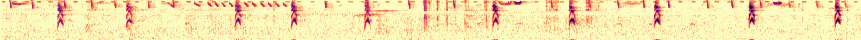

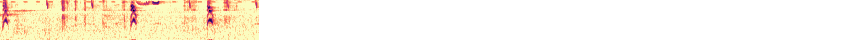

XC381570  SOSP  47.5s  A  song  United States/California/Sierra County/Carman Valley  2000-06-14  Jeremy Minns[by-nc-sa]


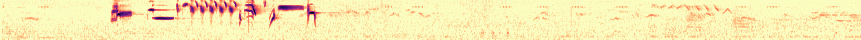

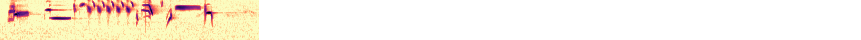

XC309650  SOSP  31.0s  A  song  United States/Michigan/Macomb County/Stony Creek Metropark  2016-03-22  Antonio Xeira[by-nc-sa]


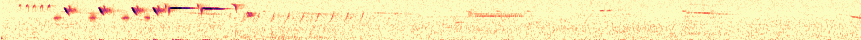

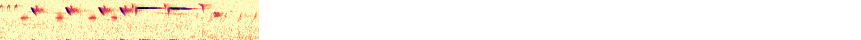

XC382858  SOSP/mexicana  28.7s  A  song  Mexico/Lomas de Bezares Miguel Hidalgo Mexico city  2017-08-12  Manuel Grosselet[by-nc-sa]


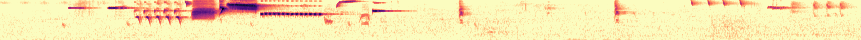

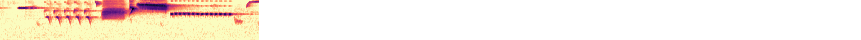

XC225617  SOSP/heermanni  21.6s  A  song  United States/CA/Salton Sea  2007-02-14  Peter Boesman[by-nc-nd]


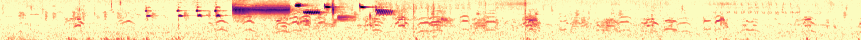

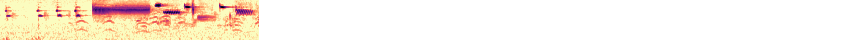

XC111663  SOSP/fallax  92.4s  A  call, excited, regular and high seep  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2012-07-31  Richard E Webster[by-nc-nd]


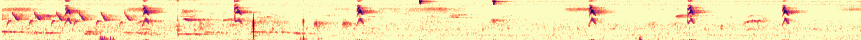

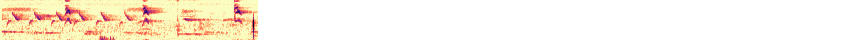

XC111654  SOSP/fallax  176.7s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-03-05  Richard E Webster[by-nc-nd]


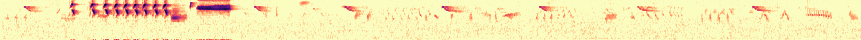

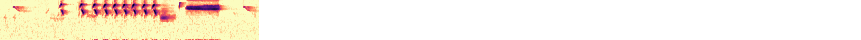

XC225616  SOSP/mexicana  87.1s  A  song  Mexico/México/Almoloya marshes  2003-04-19  Peter Boesman[by-nc-nd]


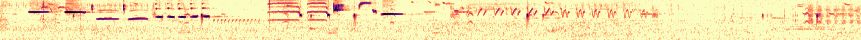

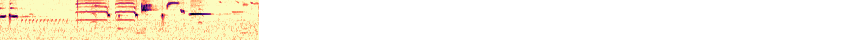

XC158951  SOSP  42.7s  A  contact calls  Canada/BC/Vancouver Island/Central Saanich/Island View Beach Regional Park  2012-07-07  Ian Cruickshank[by-nc-nd]


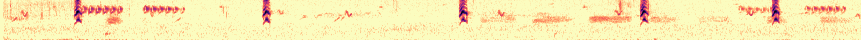

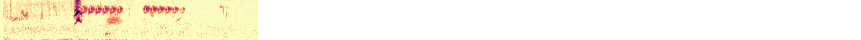

XC362469  SOSP  82.4s  A  song  United States/Illinois/DuPage County/Morton Arboretum  2017-04-01  Matt Wistrand[by-nc-sa]


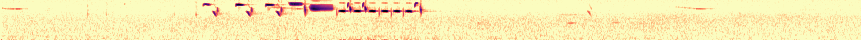

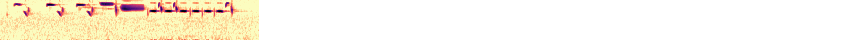

XC62782  SOSP/melodia  115.9s  A  song  United States/Tennessee/Knoxville  2010-09-29  Mike Nelson[by-nc-sa]


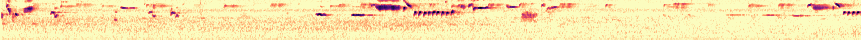

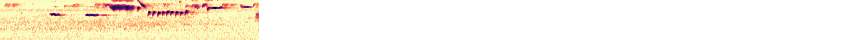

XC121280  SOSP/fallax  57.1s  A  song  United States/Arizona/Bill Williams River NWR  2013-02-01  Lauren Harter[by-nc-sa]


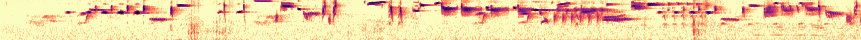

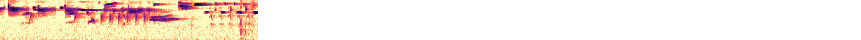

XC83576  SOSP  3.4s  A  song  United States/NY/Syracuse/Green Lakes  2008-06-23  Jelmer Poelstra[by-nc-nd]


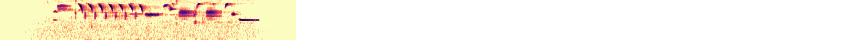

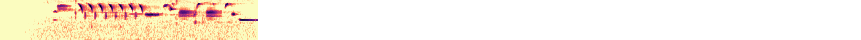

XC362470  SOSP  44.4s  A  song  United States/Illinois/DuPage County/Morton Arboretum  2017-04-01  Matt Wistrand[by-nc-sa]


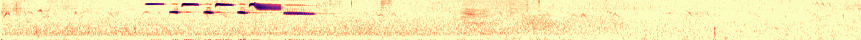

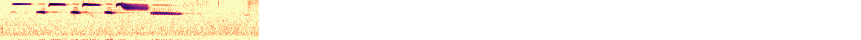

XC368073  SOSP/heermanni  16.1s  A  song  United States/CA/Davis  2017-05-05  Steve Hampton[by-nc-sa]


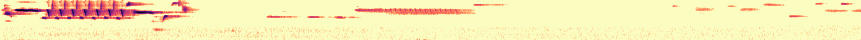

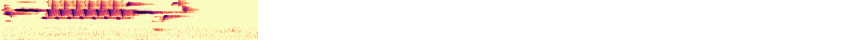

XC179182  SOSP  47.3s  A  song  United States/Georgia/Union County/Chattahoochee National Forest (near  Blairsville)  2014-05-19  Russ Wigh[by-nc-sa]


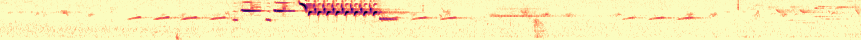

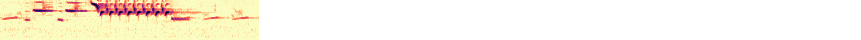

XC159332  SOSP  52.9s  A  call  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-08-24  Ian Cruickshank[by-nc-nd]


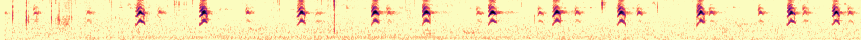

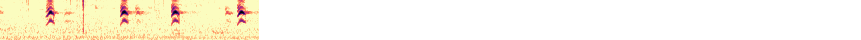

XC298454  SOSP  22.7s  A  call  Canada/Québec/Le Haut-Saint-Laurent/Réserve nationale de faune du lac Saint-François  2015-07-04  Martin St-Michel[by-nc-sa]


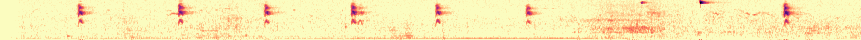

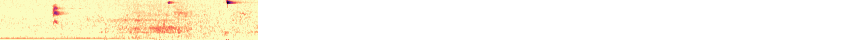

XC253352  SOSP/mexicana  21.7s  A  song  Mexico/México/Ciénegas del Lerma  2015-06-21  Manuel Grosselet[by-nc-sa]


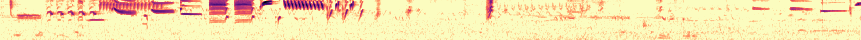

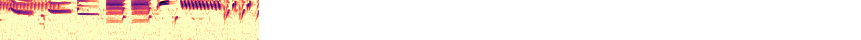

XC79791  SOSP/mailliardi  19.7s  A  song  United States/CA/Yolo County/Putah Creek Cyn  2011-05-05  Steve Hampton[by-nc-nd]


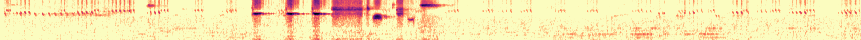

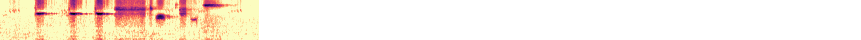

XC235955  SOSP/mailliardi  35.8s  A  song  United States/California/Yolo Cty/Davis/Putah Creek Riparian Area  2015-04-10  Steve Hampton[by-nc-sa]


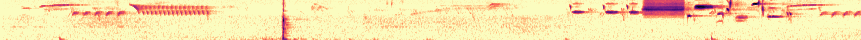

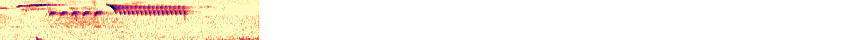

XC183355  SOSP/fallax  39.3s  A  song  United States/Arizona/Maricopa County/Salt River - Coon Bluff Recreation Area  2014-06-23  Tim Marquardt[by-nc-sa]


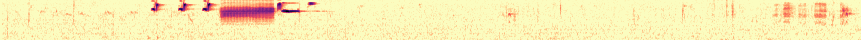

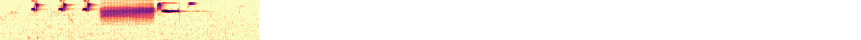

XC381554  SOSP  4.8s  A  song  United States/Colorado/Routt County/CR 70  2017-06-03  Sue Riffe[by-nc-sa]


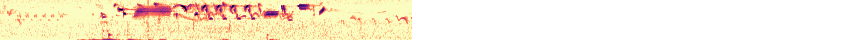

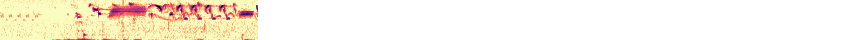

XC35904  SOSP  12.1s  A  Song  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


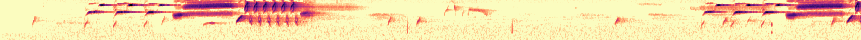

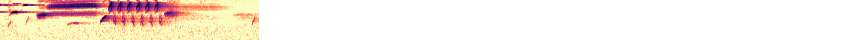

XC111666  SOSP/fallax  121.5s  A  song, call, interaction tick series  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-03-11  Richard E Webster[by-nc-nd]


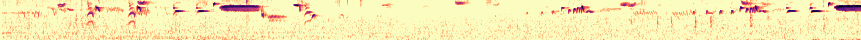

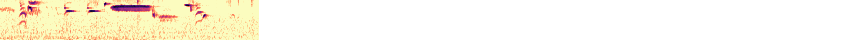

XC128238  SOSP  96.2s  A  song  United States/California/Nipomo/Oso Flaco Lake  1998-03-01  Thomas G. Graves[by-nc-sa]


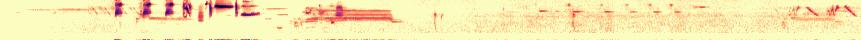

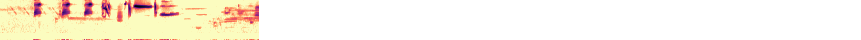

XC111668  SOSP/fallax  95.1s  A  subsong  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-08-30  Richard E Webster[by-nc-nd]


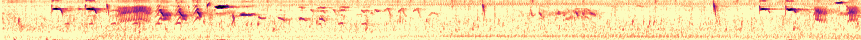

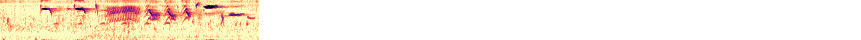

XC125719  SOSP/heermanni  57.1s  A  call  Mexico/Baja California/Catavina  2001-03-04  Richard E. Webster[by-nc-sa]


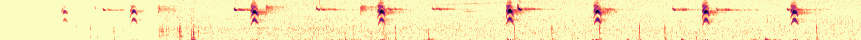

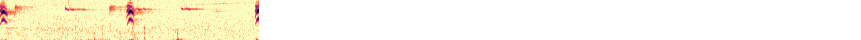

XC393996  SOSP  68.2s  A  song  United States/New Jersey/Hudson County/Hoboken  2017-04-19  Dominic Garcia-Hall[by-nc-sa]


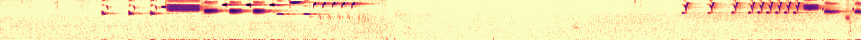

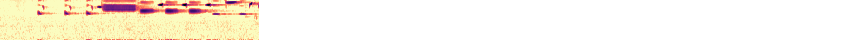

XC111651  SOSP/fallax  146.2s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-05-11  Richard E Webster[by-nc-nd]


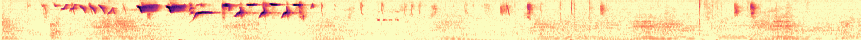

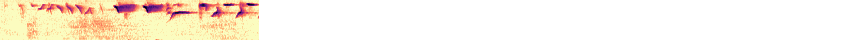

XC336819  SOSP  66.0s  A  subsong  United States/Pennsylvania/Montgomery/Lower Moreland (near  Huntingdon Valley)  2010-10-03  Paul Driver[by-nc-sa]


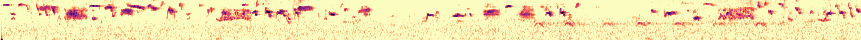

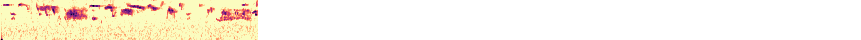

XC190448  SOSP  9.6s  A  male, song  United States/New York City/Manhattan/Inwood Hill Park  2014-08-05  Krzysztof Deoniziak[by-nc-nd]


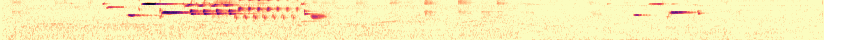

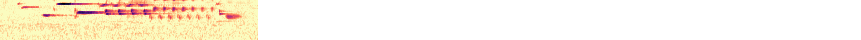

XC188448  SOSP/juddi  58.0s  A  song  Canada/British Columbia/Swan Lake Provincial Park  2014-06-14  Richard E. Webster[by-nc-sa]


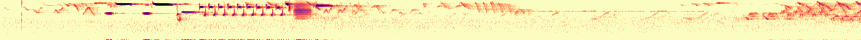

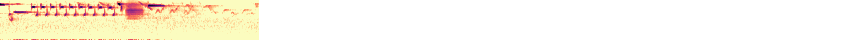

XC307660  SOSP  13.9s  A  call  United States/Mississippi/Lafayette County/Oxford  2015-11-19  J.R. Rigby[by-nc-sa]


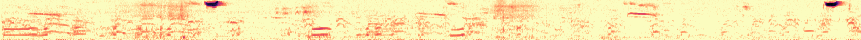

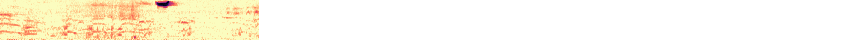

XC282512  SOSP  48.6s  A  song  United States/Michigan/Macomb County/Stony Creek Metropark  2015-09-23  Antonio Xeira[by-nc-sa]


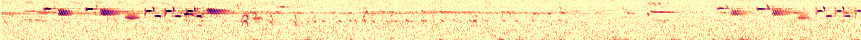

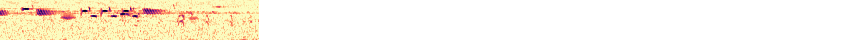

XC363141  SOSP  64.9s  A  song  United States/Colorado/Routt Co/Yampa River Botanic Park  2015-04-25  Frank Lambert[by-nc-nd]


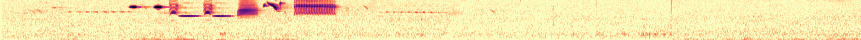

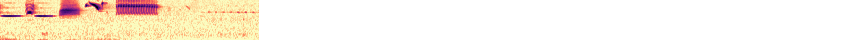

XC293818  SOSP  7.8s  A  call  United States/Alabama/Barbour County/Eufaula  2015-11-23  Jim Holmes[by-nc-sa]


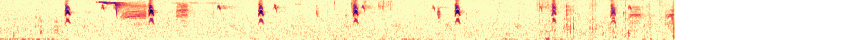

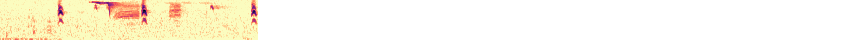

XC134164  SOSP/fallax  37.7s  A  song  United States/Arizona/Bill Williams River NWR  2013-03-22  Lauren Harter[by-nc-sa]


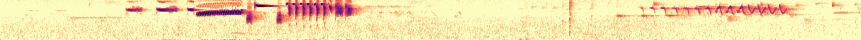

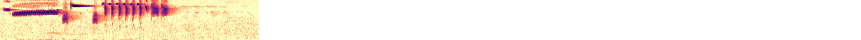

XC408127  SOSP/heermanni group  58.7s  A  song  United States/California/Orange County/Irvine/San Joquin Wildlife Sanctuary  2015-05-17  Frank Lambert[by-nc-nd]


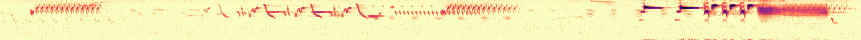

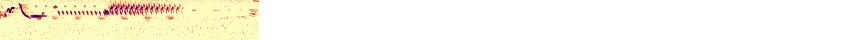

XC182170  SOSP/fallax  25.7s  A  song  United States/Arizona/Maricopa County/Gilbert Riparian Preserve  2014-06-16  Tim Marquardt[by-nc-sa]


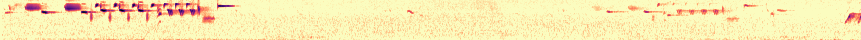

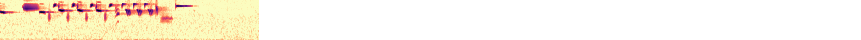

XC320469  SOSP  56.0s  A  song  United States/Kentucky/Fayette County/Jacobson Park  2015-03-14  Antonio Xeira[by-nc-sa]


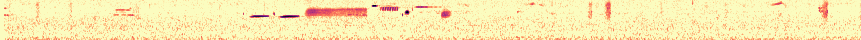

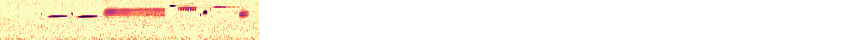

XC138340  SOSP  4.1s  A  song  Canada/Saskatchewan/Division No. 10/Foam Lake No. 276 (near  Leslie)  2013-06-08  Patrick Turgeon[by-nc-sa]


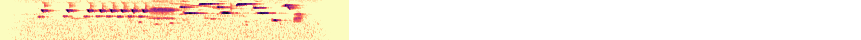

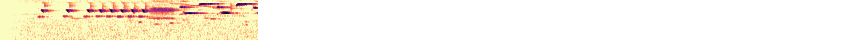

XC139911  SOSP  279.4s  A  song  Canada/Saskatchewan/Division No. 10/Foam Lake No. 276 (near  Leslie)  2013-06-08  Patrick Turgeon[by-nc-sa]


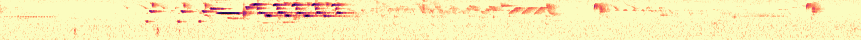

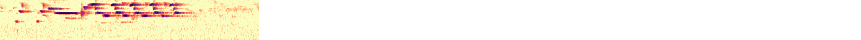

XC325378  SOSP  44.9s  A  song  United States/California/Sacramento County/Mather Lake  2016-07-03  Jim Holmes[by-nc-sa]


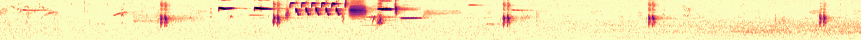

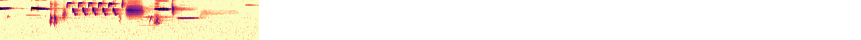

XC131649  SOSP  455.1s  A  song  United States/Minnesota/Hennepin/Minneapolis/Powderhorn Park  2013-04-27  Jonathon Jongsma[by-sa]


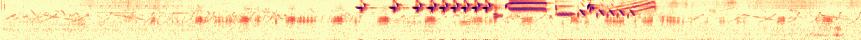

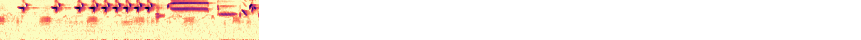

XC132874  SOSP  786.8s  A  song  United States/Minnesota/Beltrami/Lake Bemidji State Park  2013-05-06  Jonathon Jongsma[by-sa]


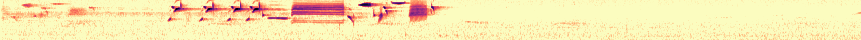

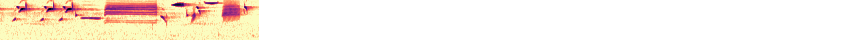

XC253526  SOSP  22.8s  A  song  United States/Oregon/Tillamook County/Tillamook/Oceanside  2013-06-04  Matthias Feuersenger[by-nc-sa]


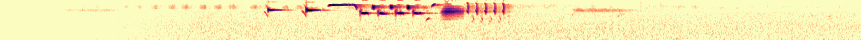

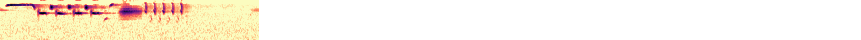

XC60067  SOSP/melodia  23.3s  A  call  United States/Tennessee/Knoxville  2010-08-04  Mike Nelson[by-nc-sa]


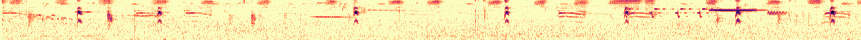

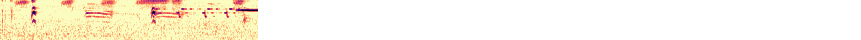

XC131959  SOSP  60.1s  A  song  Canada/Québec/La Côte-de-Beaupré/Réserve nationale de faune du cap Tourmente  2013-04-27  Martin St-Michel[by-nc-sa]


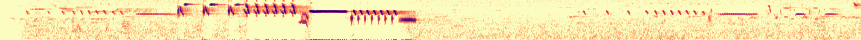

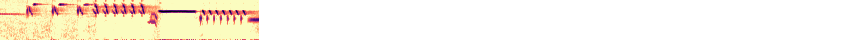

XC59192  SOSP  66.8s  A  Fledgling call  United States/New Hampshire/North Woodstock/Hamlet Drive  2010-06-24  Tayler Brooks[by-nc-nd]


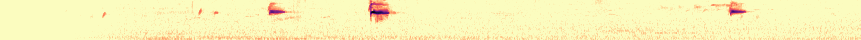

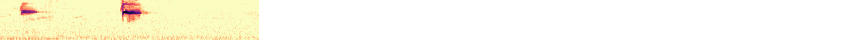

XC111669  SOSP/fallax  168.9s  A  subsong  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2010-09-02  Richard E Webster[by-nc-nd]


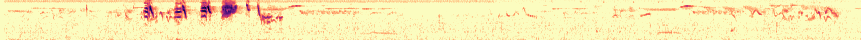

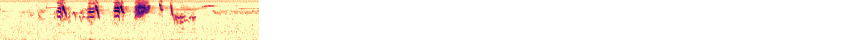

XC384033  SOSP  41.0s  A  song  United States/Michigan/Oakland County/Bloomer Park  2015-06-12  Antonio Xeira[by-nc-sa]


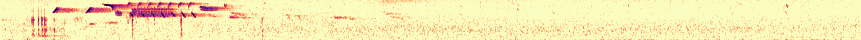

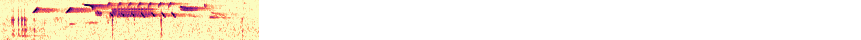

XC155236  SOSP  85.1s  A  flight call  United States/Pennsylvania/Montgomery/Lower Moreland (near  Huntingdon Valley)  2013-11-16  Paul Driver[by-nc-sa]


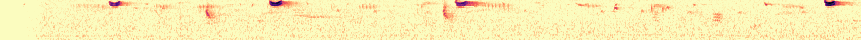

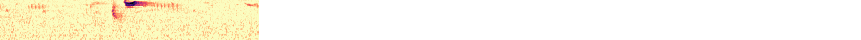

XC111644  SOSP/fallax  30.0s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-05-04  Richard E Webster[by-nc-nd]


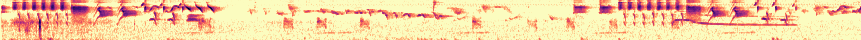

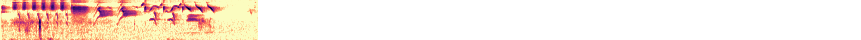

XC408126  SOSP/heermanni group  44.5s  A  song  United States/California/Orange County/Irvine/San Joquin Wildlife Sanctuary  2015-05-17  Frank Lambert[by-nc-nd]


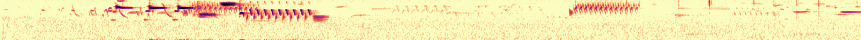

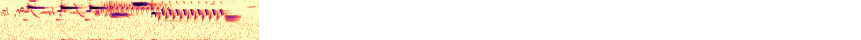

XC111671  SOSP/fallax  32.8s  A  subsong  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2010-09-15  Richard E Webster[by-nc-nd]


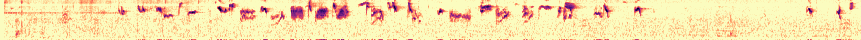

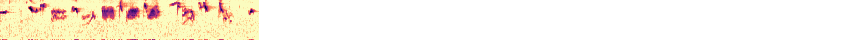

XC149410  SOSP/kenaiensis  9.8s  A  call  United States/Alaska/Kenai Peninsula/Homer Spit  2013-05-21  Andrew Spencer[by-nc-sa]


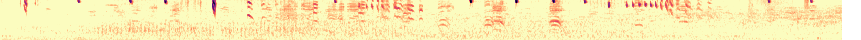

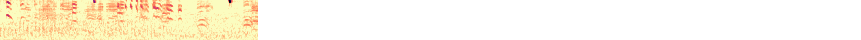

XC417352  SOSP/mexicana  35.0s  A  call  Mexico/Lomas de Bezares Miguel Hidalgo Mexico city  2018-05-28  Manuel Grosselet[by-nc-sa]


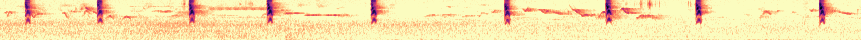

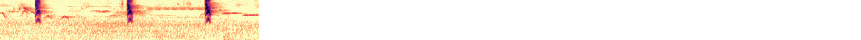

XC125706  SOSP/fisherella  31.1s  A  song  United States/California/Inyo/White Mountains/Wyman Canyon  1995-06-03  Richard E. Webster[by-nc-sa]


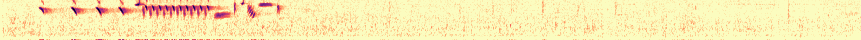

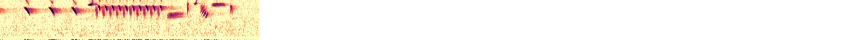

XC18388  SOSP  60.0s  A  song  United States/Tennessee/Franklin County/Sewanee  2008-03-09  Chris Parrish[by-nc-nd]


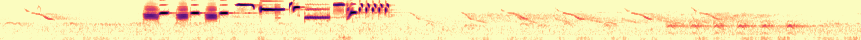

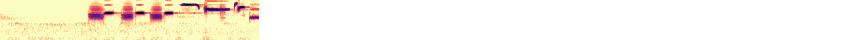

XC215342  SOSP  60.2s  A  song  Canada/SK/3 km south of Fishing Lake  2014-08-03  Patrick Turgeon[by-nc-sa]


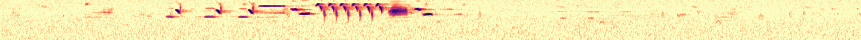

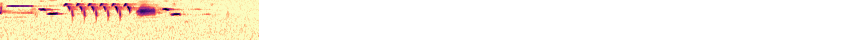

XC103449  SOSP  87.3s  A  song  United States/Colorado/Larimer Cty./Fort Collins/Poudre Trail - Riverbend Ponds  2012-05-06  Eric DeFonso[by-nc-nd]


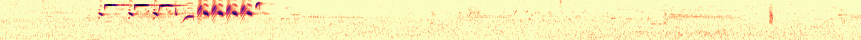

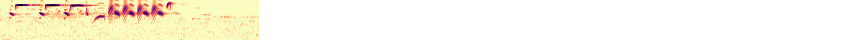

XC349555  SOSP  15.0s  A  alarm call, call  United States/Illinois/Kane County/Jon J Duerr Forest Preserve  2016-05-20  Matt Wistrand[by-nc-sa]


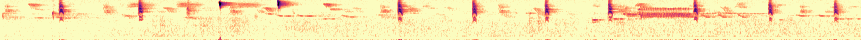

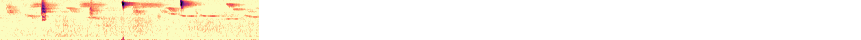

XC35902  SOSP  17.4s  A  Call  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


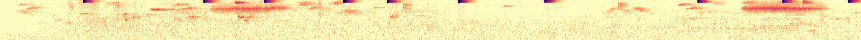

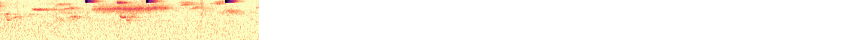

XC190476  SOSP  11.9s  A  male, song  United States/New York/Long Island/Montauk Point  2014-08-08  Krzysztof Deoniziak[by-nc-nd]


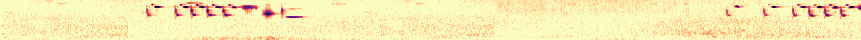

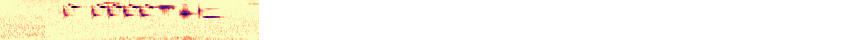

XC149407  SOSP/kenaiensis  54.4s  A  call  United States/Alaska/Kenai Peninsula/Homer Spit  2013-05-21  Andrew Spencer[by-nc-sa]


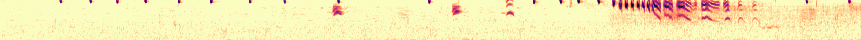

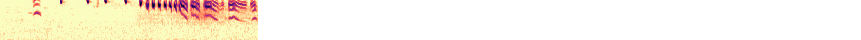

XC190543  SOSP  11.0s  A  song  United States/New York City/Jamaica Bay Wildlife Refuge  2014-08-03  Krzysztof Deoniziak[by-nc-nd]


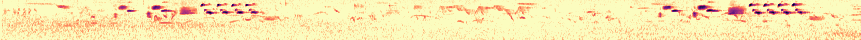

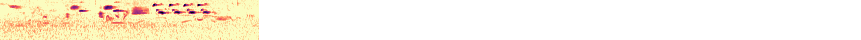

XC375515  SOSP/melodia  27.5s  A  song  United States/Illinois/Kane County/Nelson Lake Marsh Reserve  2017-06-13  Greg Irving[by-nc-sa]


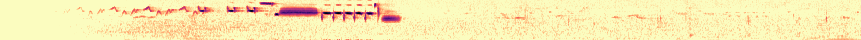

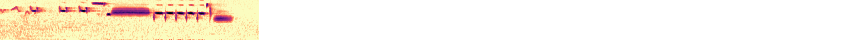

XC286977  SOSP  64.9s  A  begging call, call, juvenile  United States/California/Imperial County/Niland/west end of Pound Road  2015-04-27  Paul Marvin[by-nc-sa]


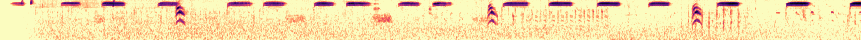

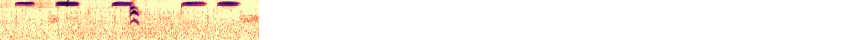

XC111645  SOSP/fallax  42.3s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2011-05-11  Richard E Webster[by-nc-nd]


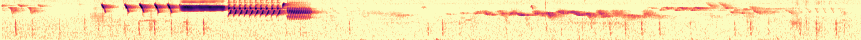

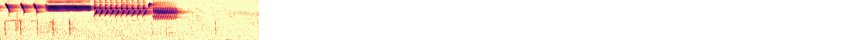

XC205806  SOSP  156.7s  A  song  United States/Colorado/Delta County/Delta/Confluence Park  2014-05-29  Eric DeFonso[by-nc-sa]


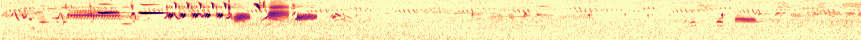

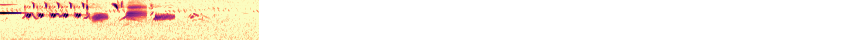

XC408810  SOSP/heermanni?  32.2s  A  calling whilst foraging, song  United States/California/Monterey County/Andrew Molera Park (near  Big Sur)  2015-05-18  Frank Lambert[by-nc-nd]


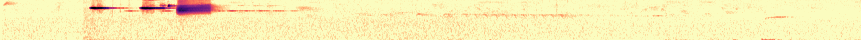

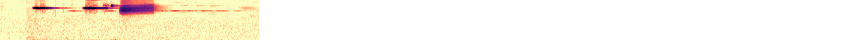

XC138338  SOSP  24.1s  A  song  Canada/Saskatchewan/Division No. 10/Foam Lake No. 276 (near  Leslie)  2013-06-07  Patrick Turgeon[by-nc-sa]


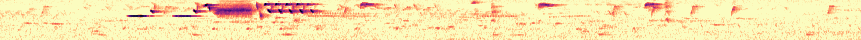

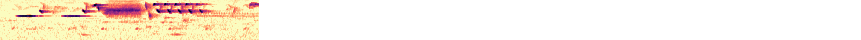

XC193953  SOSP/inexspectata  135.7s  A  song  United States/Alaska/near Hyder/Fish Creek  2014-06-23  Richard E. Webster[by-nc-sa]


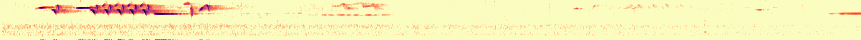

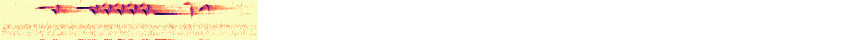

XC111286  SOSP/fallax  16.2s  A  song  United States/Arizona/Pima County/Buenos Aires National Wildlife Refuge  2008-09-11  Richard E Webster[by-nc-nd]


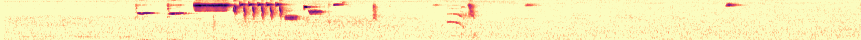

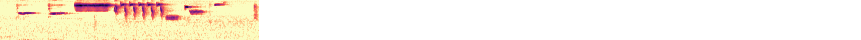

XC375662  SOSP  65.4s  A  song  United States/Kentucky/Madison County/Kentucky (near  Richmond)  2017-06-15  John E Abrams[by-nc-sa]


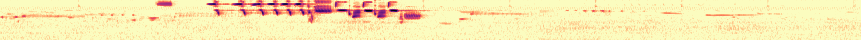

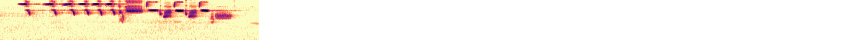

XC158992  SOSP/Type 4  56.0s  A  song  Canada/BC/Vancouver Island/Colwood/Royal Roads University  2012-07-18  Ian Cruickshank[by-nc-nd]


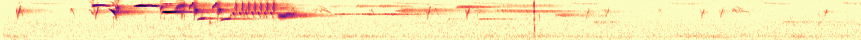

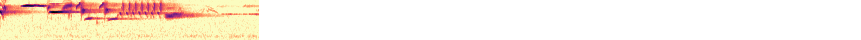

XC407930  SOSP  16.5s  A  song  United States/New York/Chautauqua County/Harmony (near  Ashville)  2014-05-24  Jim Berry[by-nc-sa]


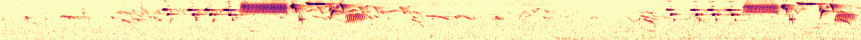

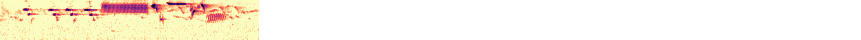

XC43411  SOSP  17.5s  A  song  United States/Wisconsin/Waukesha Co./South Unit/Kettle Moraine State Park  2009-06-06  Todd Wilson[by-nc-nd]


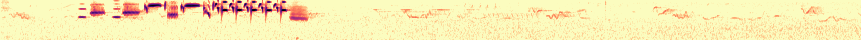

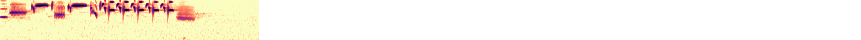

XC142621  SOSP  75.3s  A  song  United States/Michigan/Ontonagon/Porcupine Mountains SP/Union Bay Campground  2013-07-11  Jonathon Jongsma[by-sa]


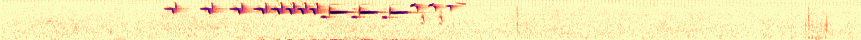

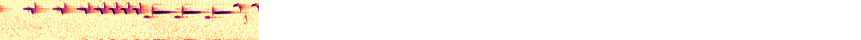

XC379143  SOSP/montana  23.8s  A  song  United States/California/Lassen National Park/Manzanita Lake  2017-07-08  Steve Hampton[by-nc-sa]


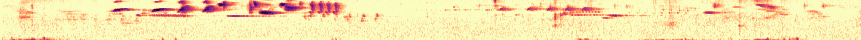

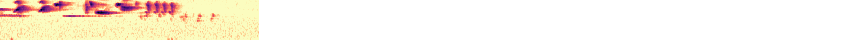

XC133568  SOSP  150.2s  A  song  United States/New Jersey/Somerset/Franklin Township  2013-05-12  Dan Lane[by-nc-sa]


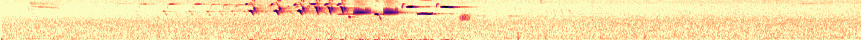

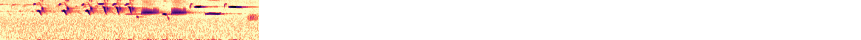

XC366597  SOSP  53.9s  A  song  United States/Kentucky/Fayette County/Jacobson Park  2015-03-14  Antonio Xeira[by-nc-sa]


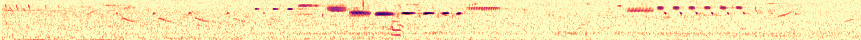

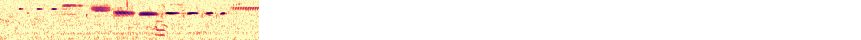

XC158918  SOSP  79.3s  A  song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-07-04  Ian Cruickshank[by-nc-nd]


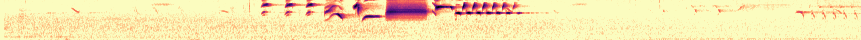

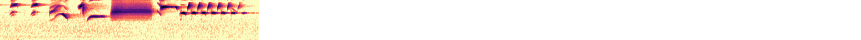

XC125717  SOSP/fisherella  156.3s  A  call, song  United States/California/Inyo/White Mountains/Wyman Canyon  1995-06-02  Richard E. Webster[by-nc-sa]


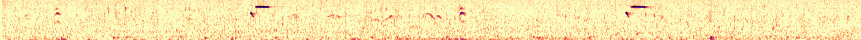

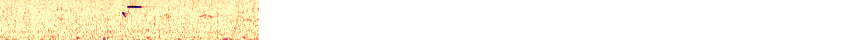

XC111289  SOSP/fallax  75.0s  A  song  United States/Arizona/Cochise County/San Bernardino National Wildlife Refuge  2008-07-31  Richard E Webster[by-nc-nd]


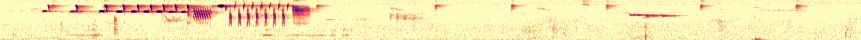

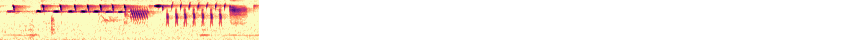

In [ ]:
for rec in df_rows(xc_recs
    .query("species == 'SOSP'")
    .query("quality == 'A'")
    .pipe(tap, lambda df: print(len(df)))
    .sample(random_state=0,
        n=100,
    )
):
    print(xc_rec_str_line(rec))
    plot_spectro_micro(rec, features,
        # audio=True,
    )
    plot_thumb_micro(rec, features,
        thumb_s=3,
        # audio=True,
        # verbose=True,
    )
    plt.show()